
## Nneka Ede
#### 1k Genome Project

In [1]:
## import hail
%time import hail as hl
import hail.expr.aggregators as agg
hl.init()




/opt/conda/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/opt/conda/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)


CPU times: user 3.68 s, sys: 4.77 s, total: 8.46 s
Wall time: 1.35 s


Running on Apache Spark version 2.2.1
SparkUI available at http://10.142.0.9:4040
Welcome to
     __  __     <>__
    / /_/ /__  __/ /
   / __  / _ `/ / /
  /_/ /_/\_,_/_/_/   version devel-98f4d6a179b4
NOTE: This is a beta version. Interfaces may change
  during the beta period. We recommend pulling
  the latest changes weekly.


In [2]:
#headers
import numpy as np
import pandas as pd
from collections import Counter
from math import log, isnan
from pprint import pprint
from bokeh.io import show, output_notebook
from bokeh.plotting import figure
from bokeh.layouts import gridplot
from bokeh.models import Span
output_notebook()
import plotly
import time
import gcsfs
import csv
from bokeh.io import output_notebook, push_notebook, show
import seaborn as sns

Loading BokehJS ...

No module named 'dask'


In [3]:
# import file system to save files to google cloud
import gcsfs
fs = gcsfs.GCSFileSystem(project='avl-hail-ines')

In [4]:
# Print Options for pandas dataframes
pd.set_option('display.max_rows', 4000) #to display all data
pd.set_option('display.max_columns', 500) ## WILL SHOW ALL COLUMNS


## Reading in VDS File (Phase 1 or 3)

In [5]:
## reading in phase 1
vds = hl.read_matrix_table('gs://1k-genome/1000-genomes/VDS-of-all/ALL.chr.integrated_phase1_v3.20101123.snps_indels_svs.genotypes.mt')
print('The counts are: ', vds.count())

The counts are:  (39706715, 1092)


In [6]:
#schema of Phase 1 / 3
vds.describe()

----------------------------------------
Global fields:
    None
----------------------------------------
Column fields:
    's': str 
----------------------------------------
Row fields:
    'locus': locus<GRCh37> 
    'alleles': array<str> 
    'rsid': str 
    'qual': float64 
    'filters': set<str> 
    'info': struct {
        LDAF: float64, 
        AVGPOST: float64, 
        RSQ: float64, 
        ERATE: float64, 
        THETA: float64, 
        CIEND: array<int32>, 
        CIPOS: array<int32>, 
        END: int32, 
        HOMLEN: array<int32>, 
        HOMSEQ: array<str>, 
        SVLEN: int32, 
        SVTYPE: str, 
        AC: array<int32>, 
        AN: int32, 
        AA: str, 
        AF: array<float64>, 
        AMR_AF: float64, 
        ASN_AF: float64, 
        AFR_AF: float64, 
        EUR_AF: float64, 
        VT: str, 
        SNPSOURCE: array<str>
    } 
----------------------------------------
Entry fields:
    'GT': call 
    'DS': float64 
    'GL': array<floa

In [7]:
vds.entry.take(5)

[Struct(GT=0|0, DS=0.2, GL=[-0.18, -0.47, -2.42], PL=None),
 Struct(GT=0|0, DS=0.15, GL=[-0.24, -0.44, -1.16], PL=None),
 Struct(GT=0|0, DS=0.15, GL=[-0.15, -0.54, -3.12], PL=None),
 Struct(GT=0|1, DS=0.6, GL=[-0.48, -0.48, -0.48], PL=None),
 Struct(GT=0|0, DS=0.55, GL=[-0.48, -0.48, -0.48], PL=None)]

In [8]:
vds.entry.show()

+---------------+------------+---------+------+-------------+---------------------+
| locus         | alleles    | s       | GT   |          DS | GL                  |
+---------------+------------+---------+------+-------------+---------------------+
| locus<GRCh37> | array<str> | str     | call |     float64 | array<float64>      |
+---------------+------------+---------+------+-------------+---------------------+
| 1:10583       | ["G","A"]  | HG00096 | 0|0  | 2.00000e-01 | [-0.18,-0.47,-2.42] |
| 1:10583       | ["G","A"]  | HG00097 | 0|0  | 1.50000e-01 | [-0.24,-0.44,-1.16] |
| 1:10583       | ["G","A"]  | HG00099 | 0|0  | 1.50000e-01 | [-0.15,-0.54,-3.12] |
| 1:10583       | ["G","A"]  | HG00100 | 0|1  | 6.00000e-01 | [-0.48,-0.48,-0.48] |
| 1:10583       | ["G","A"]  | HG00101 | 0|0  | 5.50000e-01 | [-0.48,-0.48,-0.48] |
| 1:10583       | ["G","A"]  | HG00102 | 0|1  | 9.50000e-01 | [-1.92,-0.01,-2.5]  |
| 1:10583       | ["G","A"]  | HG00103 | 0|0  | 5.00000e-02 | [-0.05,-0.93,-

## Annotate Columns w/ Clinical Annotations
#### READ IN AS HAIL TABLE 
I first read in the protein annotations for about 90 individuals. These annoation have about 5000 proteins which at this time is too much for hail to take. So I first extract the proteins expressions and other data from the dataframe that is important based on literature of protein expression and sex. Then I shuffle the rest of the proteins (that are not significant). After, I take about 50-100 of those random genes and concate that with the genes that are significant. This will give you a subset of the protein annonations while still saving important genes


In [11]:
#Read in -- FULL DATAFRAME OF PROTEIN ANNOTATIONS
with fs.open('gs://nneka/Supplementary_Table_1.csv',"rt") as f:
    table5 = pd.read_csv(f, na_values = str, header = 0)
#table5 = (hl.import_table('gs://nneka/Supplementary_Table_1.csv', delimiter=',', impute=True, missing='NA').key_by('Individual ID'))

#save columns I need in a separate df
need = table5[['Individual LCLs', 'sex', 'population', 'FamilyID', 'Individual ID', 'dad', 'mom',
'ENSG00000067048','ENSG00000129824',
'ENSG00000130985','ENSG00000215301',
'ENSG00000198034','ENSG00000086712','ENSG00000006757',
'ENSG00000124486','ENSG00000110107',
'ENSG00000107929','ENSG00000184743','ENSG00000169895'   
              ]]

#then remove them from the orginal df
table5 = table5.drop(['Individual LCLs', 'sex', 'population', 'FamilyID', 'Individual ID', 'dad', 'mom',
'ENSG00000067048','ENSG00000129824',
'ENSG00000130985','ENSG00000215301',
'ENSG00000198034','ENSG00000086712','ENSG00000006757',
'ENSG00000124486','ENSG00000110107',
'ENSG00000107929','ENSG00000184743','ENSG00000169895'   
              ], axis = 1)

rows, columns = table5.shape
columns = list(table5)
indices = columns
#print (list(table5))
import random


random.shuffle(indices) # will give you random samples or individuals

#re orders the table
table5 = table5.ix[:, indices]

# will only save a subset of the array
table5 = table5.iloc[:,0:300] # This determines how large the subset will be
print(table5.shape)

#add back in the data i need
protein_subset = pd.concat([need, table5], axis=1, sort=False)
print (protein_subset)
print (type(protein_subset))


print(type(need))
print(type(table5))

# to csv
#np.savetxt("gs://nneka/table2.txt", table6)
from google.cloud import storage
storage.Client()
client = storage.Client()
bucket = client.get_bucket('nneka')  # tu choisis le bucket dans lequel tu veux le mettre
blob = bucket.blob('protein_subset.csv')    # se connecte au bucket choisis et tu peux choisir le nom du fichier ici table5.csv
protein_subset.to_csv('protein_subset', encoding='utf-8', index=False)   # Exporte le dataframe in a CSV
blob.upload_from_filename('protein_subset')         # Met le CSV dans le bucket 



# read in
#table2 = (hl.import_table('gs://nneka/protein_subset.csv', delimiter=',', impute=True, missing='NA').key_by('Individual ID'))




/opt/conda/lib/python3.6/site-packages/ipykernel/__main__.py:34: DeprecationWarning:


.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated



(95, 300)
   Individual LCLs     sex population FamilyID Individual ID      dad  \
0          GM06984    male        CEU     1328       NA06984        0   
1          GM06985  female        CEU     1341       NA06985        0   
2          GM06994    male        CEU     1340       NA06994        0   
3          GM07000  female        CEU     1340       NA07000        0   
4          GM07029    male        CEU     1340       NA07029  NA06994   
5          GM07346  female        CEU     1345       NA07346        0   
6          GM07347    male        CEU     1345       NA07347        0   
7          GM07357    male        CEU     1345       NA07357        0   
8          GM10831  female        CEU     1408       NA10831  NA12155   
9          GM10839  female        CEU     1420       NA10839  NA12005   
10         GM10847  female        CEU     1334       NA10847        0   
11         GM10856    male        CEU     1350       NA10856  NA11829   
12         GM10857    male        CEU    

In [12]:
#A SUBSET OF A PROTEIN ANNOTATIONS
#table2 = (hl.import_table('gs://nneka/protein_annotations.csv', delimiter=',', impute=True, missing='NA').key_by('Individual ID'))
table2 = (hl.import_table('gs://nneka/protein_subset.csv', delimiter=',', impute=True, missing='').key_by('Individual ID'))


## DOES NOT WORK BECAUSE TOO LARGE
#table2 = (hl.import_table('gs://nneka/Supplementary_Table_1.csv', delimiter=',', impute=True, missing='NA').key_by('Individual ID'))



2018-08-09 15:42:25 Hail: INFO: Reading table to impute column types
2018-08-09 15:42:25 Hail: INFO: Finished type imputation
  Loading column 'Individual LCLs' as type 'str' (imputed)
  Loading column 'sex' as type 'str' (imputed)
  Loading column 'population' as type 'str' (imputed)
  Loading column 'FamilyID' as type 'str' (imputed)
  Loading column 'Individual ID' as type 'str' (imputed)
  Loading column 'dad' as type 'str' (imputed)
  Loading column 'mom' as type 'str' (imputed)
  Loading column 'ENSG00000067048' as type 'float64' (imputed)
  Loading column 'ENSG00000129824' as type 'float64' (imputed)
  Loading column 'ENSG00000130985' as type 'float64' (imputed)
  Loading column 'ENSG00000215301' as type 'float64' (imputed)
  Loading column 'ENSG00000198034' as type 'float64' (imputed)
  Loading column 'ENSG00000086712' as type 'float64' (imputed)
  Loading column 'ENSG00000006757' as type 'float64' (imputed)
  Loading column 'ENSG00000124486' as type 'float64' (imputed)
  Loadi

  Loading column 'ENSG00000197168' as type 'float64' (imputed)
  Loading column 'ENSG00000100888' as type 'float64' (imputed)
  Loading column 'ENSG00000164944' as type 'float64' (imputed)
  Loading column 'ENSG00000160563' as type 'float64' (imputed)
  Loading column 'ENSG00000128708' as type 'float64' (imputed)
  Loading column 'ENSG00000168067' as type 'float64' (imputed)
  Loading column 'ENSG00000182810' as type 'float64' (imputed)
  Loading column 'ENSG00000099810' as type 'float64' (imputed)
  Loading column 'ENSG00000187231' as type 'float64' (imputed)
  Loading column 'ENSG00000148444' as type 'float64' (imputed)
  Loading column 'ENSG00000170471' as type 'float64' (imputed)
  Loading column 'ENSG00000105552' as type 'float64' (imputed)
  Loading column 'ENSG00000155660' as type 'float64' (imputed)
  Loading column 'ENSG00000161265' as type 'float64' (imputed)
  Loading column 'ENSG00000204138' as type 'float64' (imputed)
  Loading column 'ENSG00000100749' as type 'float64' (i

In [13]:
#import all other sample_info
table1 = (hl.import_table('gs://1k-genome/1000-genomes/other/sample_info/sample_info.csv', delimiter=',', impute=True, missing='', quote='"').key_by('Sample'))



2018-08-09 15:44:29 Hail: INFO: Reading table to impute column types
2018-08-09 15:44:29 Hail: INFO: Finished type imputation
  Loading column 'Sample' as type 'str' (imputed)
  Loading column 'Family_ID' as type 'str' (imputed)
  Loading column 'Population' as type 'str' (imputed)
  Loading column 'Population_Description' as type 'str' (imputed)
  Loading column 'Gender' as type 'str' (imputed)
  Loading column 'Relationship' as type 'str' (imputed)
  Loading column 'Unexpected_Parent_Child' as type 'str' (imputed)
  Loading column 'Non_Paternity' as type 'str' (imputed)
  Loading column 'Siblings' as type 'str' (imputed)
  Loading column 'Grandparents' as type 'str' (imputed)
  Loading column 'Avuncular' as type 'str' (imputed)
  Loading column 'Half_Siblings' as type 'str' (imputed)
  Loading column 'Unknown_Second_Order' as type 'str' (imputed)
  Loading column 'Third_Order' as type 'str' (imputed)
  Loading column 'In_Low_Coverage_Pilot' as type 'int32' (imputed)
  Loading column 

In [14]:
table1.count()

3500

In [15]:
table1.row.show()
table2.row.show()

2018-08-09 15:44:33 Hail: INFO: Coerced sorted dataset


+---------+-----------+------------+---------------------------------+--------+
| Sample  | Family_ID | Population | Population_Description          | Gender |
+---------+-----------+------------+---------------------------------+--------+
| str     | str       | str        | str                             | str    |
+---------+-----------+------------+---------------------------------+--------+
| HG00096 | HG00096   | GBR        | British in England and Scotland | male   |
| HG00097 | HG00097   | GBR        | British in England and Scotland | female |
| HG00098 | HG00098   | GBR        | British in England and Scotland | male   |
| HG00099 | HG00099   | GBR        | British in England and Scotland | female |
| HG00100 | HG00100   | GBR        | British in England and Scotland | female |
| HG00101 | HG00101   | GBR        | British in England and Scotland | male   |
| HG00102 | HG00102   | GBR        | British in England and Scotland | female |
| HG00103 | HG00103   | GBR        | Bri

2018-08-09 15:44:34 Hail: INFO: Ordering unsorted dataset with network shuffle


+-----------------+--------+------------+----------+---------------+---------+
| Individual LCLs | sex    | population | FamilyID | Individual ID | dad     |
+-----------------+--------+------------+----------+---------------+---------+
| str             | str    | str        | str      | str           | str     |
+-----------------+--------+------------+----------+---------------+---------+
| GM06984         | male   | CEU        | 1328     | NA06984       | 0       |
| GM06985         | female | CEU        | 1341     | NA06985       | 0       |
| GM06994         | male   | CEU        | 1340     | NA06994       | 0       |
| GM07000         | female | CEU        | 1340     | NA07000       | 0       |
| GM07029         | male   | CEU        | 1340     | NA07029       | NA06994 |
| GM07346         | female | CEU        | 1345     | NA07346       | 0       |
| GM07347         | male   | CEU        | 1345     | NA07347       | 0       |
| GM07357         | male   | CEU        | 1345     |

In [16]:
table1.describe()
table2.describe()

----------------------------------------
Global fields:
    None
----------------------------------------
Row fields:
    'Sample': str 
    'Family_ID': str 
    'Population': str 
    'Population_Description': str 
    'Gender': str 
    'Relationship': str 
    'Unexpected_Parent_Child': str 
    'Non_Paternity': str 
    'Siblings': str 
    'Grandparents': str 
    'Avuncular': str 
    'Half_Siblings': str 
    'Unknown_Second_Order': str 
    'Third_Order': str 
    'In_Low_Coverage_Pilot': int32 
    'LC_Pilot_Platforms': str 
    'LC_Pilot_Centers': str 
    'In_High_Coverage_Pilot': int32 
    'HC_Pilot_Platforms': str 
    'HC_Pilot_Centers': str 
    'In_Exon_Targetted_Pilot': int32 
    'ET_Pilot_Platforms': str 
    'ET_Pilot_Centers': str 
    'Has_Sequence_in_Phase1': int32 
    'Phase1_LC_Platform': str 
    'Phase1_LC_Centers': str 
    'Phase1_E_Platform': str 
    'Phase1_E_Centers': str 
    'In_Phase1_Integrated_Variant_Set': int32 
    'Has_Phase1_chrY_SNPS': int

In [17]:
table2.count()

95

## IMPORT AS PANDAS DF

## Label Encoder
Will give string variables a number weight so that you can do regression

In [18]:
from sklearn.preprocessing import LabelEncoder

In [19]:
##TABLE1 LABEL ENCODER
#CHANGE SUPERPOPULATION TO FLOAT VARIABLES
table1 = hl.Table.to_pandas(table1) # convert to pandas
key = table1['Super_Population'].values # save values you want to change / encode

#create lable encoder
le = LabelEncoder()
le.fit(['SAS', 'EUR', 'AFR', 'AMR', 'EAS'])
list(le.classes_)
print (le.transform(key))
print (type(le.transform(key)))
reverse_key = le.transform(key)
#list(le.inverse_transform(reverse_key))
print (le.inverse_transform(reverse_key))

#APPend to the Dataframe
table1["Super_Population_Classification"] = pd.Series(le.transform(key).astype(float)) # add new encoded column to dataframe
table1 = hl.Table.from_pandas(table1).key_by('Sample') # convert back to hail table


## CHANGE SEX TO BOOL VARIABLES
data2 = hl.Table.to_pandas(table1) # convert to pandas
from sklearn.preprocessing import LabelEncoder
key = data2["Gender"].values

#create lable encoder for sex
le2 = LabelEncoder()
le2.fit(['male', 'female'])
list(le2.classes_)
print (le2.transform(key))
print (type(le2.transform(key)))
reverse_key = le2.transform(key)
#list(le.inverse_transform(reverse_key))
print (le2.inverse_transform(reverse_key))

data2["sex_bool"] = pd.Series(le2.transform(key).astype(float), index=data2.index) # add column
table1 = hl.Table.from_pandas(data2).key_by('Sample') # convert back to table

[3 3 3 ... 4 4 4]
<class 'numpy.ndarray'>
['EUR' 'EUR' 'EUR' ... 'SAS' 'SAS' 'SAS']


/opt/conda/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning:

The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.

2018-08-09 15:45:07 Hail: INFO: Coerced almost-sorted dataset
2018-08-09 15:45:07 Hail: INFO: Ordering unsorted dataset with network shuffle


[1 0 1 ... 0 0 0]
<class 'numpy.ndarray'>
['male' 'female' 'male' ... 'female' 'female' 'female']


/opt/conda/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning:

The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.



In [20]:
##ANNOTATE THE VDS1 (PHASE THREE DATA) BASED ON THE TABLE
vds1 = vds.annotate_cols(**table1[vds.s])
vds1.describe()
vds1.col.show(100)




2018-08-09 15:45:13 Hail: INFO: Coerced almost-sorted dataset
2018-08-09 15:45:14 Hail: INFO: Ordering unsorted dataset with network shuffle


----------------------------------------
Global fields:
    None
----------------------------------------
Column fields:
    's': str 
    'Family_ID': str 
    'Population': str 
    'Population_Description': str 
    'Gender': str 
    'Relationship': str 
    'Unexpected_Parent_Child': str 
    'Non_Paternity': str 
    'Siblings': str 
    'Grandparents': str 
    'Avuncular': str 
    'Half_Siblings': str 
    'Unknown_Second_Order': str 
    'Third_Order': str 
    'In_Low_Coverage_Pilot': float64 
    'LC_Pilot_Platforms': str 
    'LC_Pilot_Centers': str 
    'In_High_Coverage_Pilot': float64 
    'HC_Pilot_Platforms': str 
    'HC_Pilot_Centers': str 
    'In_Exon_Targetted_Pilot': float64 
    'ET_Pilot_Platforms': str 
    'ET_Pilot_Centers': str 
    'Has_Sequence_in_Phase1': float64 
    'Phase1_LC_Platform': str 
    'Phase1_LC_Centers': str 
    'Phase1_E_Platform': str 
    'Phase1_E_Centers': str 
    'In_Phase1_Integrated_Variant_Set': float64 
    'Has_Phase1_chrY_SN

In [21]:
#TABLE 2 -- LABEL ENCODER
# MUST CONVERT SEX TO FLOAT VALUES (0,1) in Pandas so before you convert to table and then annotate

#ADD SUPER_POPULATION_CLASSIFICATION TO TABLE
data2 = hl.Table.to_pandas(table2) # convert to pandas

from sklearn.preprocessing import LabelEncoder
key = data2["sex"].values

#create lable encoder for sex
le2 = LabelEncoder()
le2.fit(['male', 'female'])
list(le2.classes_)
print (le2.transform(key))
print (type(le2.transform(key)))
reverse_key = le2.transform(key)
#list(le.inverse_transform(reverse_key))
print (le2.inverse_transform(reverse_key))


data2["sex_bool"] = pd.Series(le2.transform(key).astype(float), index=data2.index) # add column

key = data2["population"].values

#create lable encoder for population
le3 = LabelEncoder()
le3.fit(['CEU', 'CHB', 'JPT', 'YRI'])
list(le3.classes_)
print (le3.transform(key))
print (type(le3.transform(key)))
reverse_key = le3.transform(key)
#list(le.inverse_transform(reverse_key))
print (le3.inverse_transform(reverse_key))

data2["population_float"] = pd.Series(le3.transform(key).astype(float)) # add column


table2 = hl.Table.from_pandas(data2).key_by('Individual_ID') # convert back to table


[1 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 1 1 0 0 1 0 0
 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 0 0 0 1 1 0 1 1 0 1 1 0 0 1 1 1 0 0 0 1 0 1
 1 0 1 0 1 0 1 0 0 0 1 1 1 0 1 1 0 0 0 1 0]
<class 'numpy.ndarray'>
['male' 'female' 'male' 'female' 'male' 'female' 'male' 'male' 'female'
 'female' 'female' 'male' 'male' 'male' 'female' 'male' 'female' 'female'
 'male' 'female' 'male' 'female' 'male' 'female' 'male' 'female' 'male'
 'male' 'female' 'male' 'male' 'male' 'female' 'female' 'male' 'female'
 'female' 'female' 'male' 'female' 'male' 'female' 'male' 'female' 'male'
 'female' 'male' 'female' 'male' 'male' 'female' 'male' 'female' 'female'
 'female' 'male' 'male' 'female' 'male' 'male' 'female' 'male' 'male'
 'female' 'female' 'male' 'male' 'male' 'female' 'female' 'female' 'male'
 'female' 'male' 'male' 'female' 'male' 'female' 'male' 'female' 'male'
 'female' 'female' 'female' 'male' 'male' 'male' 'female' 'male' 'male'
 'female' 'female' 'female' 'male' 'female']
[0 0 0 0 0 

/opt/conda/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning:

The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.

/opt/conda/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning:

The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.



In [22]:
## ANNOTATE VDS2 // with protein annotations based on phase 3
vds2 = vds.annotate_cols(**table2[vds.s])


vds2.describe()



2018-08-09 15:45:22 Hail: INFO: Coerced almost-sorted dataset
2018-08-09 15:45:23 Hail: INFO: Ordering unsorted dataset with network shuffle


----------------------------------------
Global fields:
    None
----------------------------------------
Column fields:
    's': str 
    'Individual_LCLs': str 
    'sex': str 
    'population': str 
    'FamilyID': str 
    'dad': str 
    'mom': str 
    'ENSG00000067048': float64 
    'ENSG00000129824': float64 
    'ENSG00000130985': float64 
    'ENSG00000215301': float64 
    'ENSG00000198034': float64 
    'ENSG00000086712': float64 
    'ENSG00000006757': float64 
    'ENSG00000124486': float64 
    'ENSG00000110107': float64 
    'ENSG00000107929': float64 
    'ENSG00000184743': float64 
    'ENSG00000169895': float64 
    'ENSG00000197386': float64 
    'ENSG00000135250': float64 
    'ENSG00000241343': float64 
    'ENSG00000156110': float64 
    'ENSG00000090686': float64 
    'ENSG00000140553': float64 
    'ENSG00000164754': float64 
    'ENSG00000116337': float64 
    'ENSG00000173163': float64 
    'ENSG00000099949': float64 
    'ENSG00000164182': float64 
    'ENSG

In [23]:
#vds2.col.ENSG00000000419.show(500)
vds2.col.ENSG00000067048.show(500)

+---------+-----------------+
| s       | ENSG00000067048 |
+---------+-----------------+
| str     |         float64 |
+---------+-----------------+
| HG00096 |              NA |
| HG00097 |              NA |
| HG00099 |              NA |
| HG00100 |              NA |
| HG00101 |              NA |
| HG00102 |              NA |
| HG00103 |              NA |
| HG00104 |              NA |
| HG00106 |              NA |
| HG00108 |              NA |
| HG00109 |              NA |
| HG00110 |              NA |
| HG00111 |              NA |
| HG00112 |              NA |
| HG00113 |              NA |
| HG00114 |              NA |
| HG00116 |              NA |
| HG00117 |              NA |
| HG00118 |              NA |
| HG00119 |              NA |
| HG00120 |              NA |
| HG00121 |              NA |
| HG00122 |              NA |
| HG00123 |              NA |
| HG00124 |              NA |
| HG00125 |              NA |
| HG00126 |              NA |
| HG00127 |              NA |
| HG00128 

## Fitering based on IDs
I filtered the vds file columns based on if the individual ID was found in the protein annotation file. It is import to note that if you do phase 1 you will be left with 50 poeple and if you do phase 3 you will be left ith 70 people

In [24]:
#data manipulation for filtering
## protein annotations -> pd -> np of IDs -> set
vds2.s.show()
ids = hl.Table.to_pandas(table2)
#print(ids)
ids = ids['Individual_ID'].values
ids = set(ids.flat)
type(ids)
print (ids)

#filter based on which cols 'id's' are not found in table2
set_to_keep = hl.literal(ids)
dataset = vds2.filter_cols(set_to_keep.contains(vds2['s']))
#vds2 = vds2.filter_cols(vds2.ENSG00000000419 > 1)
type(dataset)



+---------+
| s       |
+---------+
| str     |
+---------+
| HG00096 |
| HG00097 |
| HG00099 |
| HG00100 |
| HG00101 |
| HG00102 |
| HG00103 |
| HG00104 |
| HG00106 |
| HG00108 |
+---------+
showing top 10 rows

{'NA18566', 'NA18632', 'NA12340', 'NA12156', 'NA19100', 'NA19137', 'NA12752', 'NA12829', 'NA12892', 'NA07357', 'NA12878', 'NA07029', 'NA07346', 'NA10857', 'NA12761', 'NA06984', 'NA11993', 'NA12144', 'NA19139', 'NA18500', 'NA12044', 'NA12815', 'NA11919', 'NA18507', 'NA18558', 'NA19200', 'NA12234', 'NA12750', 'NA12812', 'NA19238', 'NA12763', 'NA11995', 'NA10831', 'NA11829', 'NA18506', 'NA10856', 'NA19201', 'NA18631', 'NA12874', 'NA18522', 'NA11992', 'NA18501', 'NA11830', 'NA18572', 'NA12043', 'NA18870', 'NA18505', 'NA07000', 'NA19194', 'NA11840', 'NA18521', 'NA18608', 'NA18502', 'NA18532', 'NA12740', 'NA11994', 'NA12891', 'NA18511', 'NA10861', 'NA18951', 'NA12760', 'NA18872', 'NA12414', 'NA12749', 'NA19239', 'NA18552', 'NA19240', 'NA18504', 'NA10839', 'NA19193', 'NA12753', 'NA18

hail.matrixtable.MatrixTable

In [23]:
#vds2.count()
dataset.count()

(39706715, 56)

In [ ]:
type(dataset)
dataset.cols().show(560)

# CREATE SUBSET OF DATA
Will only take a subset of the data so that i can run faster in Hail. This depends on the size of the machine. Will randomly shuffle the inidividuals/ samples, BUT DOES NOT shuffle the variants so you may be left with data only in chromosome 1.
##### "CHOOSE_COLS" will select number of samples/ individuals + "HEAD" will choose the number of variants

In [25]:
indices = list(range(vds1.count_cols()))
import random


random.shuffle(indices) # will give you random samples or individuals

#vds_subset = vds.head(18000).choose_cols(indices[1:51])
vds_subset = vds1.head(400000)
#vds_subset = vds1

#vds_subset.count()

In [26]:
#uncomment if you want to use the whole vds file
#vds_subset = vds1

In [27]:
indices = list(range(dataset.count_cols()))
import random


random.shuffle(indices) # will give you random samples or individuals

#PROTEIN MATRIX SUBSET // ONLY REDUCE VARIANTS
#vds2_subset = dataset.head(40000000)
vds2_subset = dataset
vds2_subset.cols().show(5)
#vds2_subset.rows().show(50000)
#region = dataset.filter_intervals(Interval.parse('%s:%d-%d' % ("Y", 0, 5000000)))

+---------+-----------------+--------+------------+----------+-----+-----+
| s       | Individual_LCLs | sex    | population | FamilyID | dad | mom |
+---------+-----------------+--------+------------+----------+-----+-----+
| str     | str             | str    | str        | str      | str | str |
+---------+-----------------+--------+------------+----------+-----+-----+
| NA06984 | GM06984         | male   | CEU        | 1328     | 0   | 0   |
| NA06994 | GM06994         | male   | CEU        | 1340     | 0   | 0   |
| NA07000 | GM07000         | female | CEU        | 1340     | 0   | 0   |
| NA07347 | GM07347         | male   | CEU        | 1345     | 0   | 0   |
| NA07357 | GM07357         | male   | CEU        | 1345     | 0   | 0   |
+---------+-----------------+--------+------------+----------+-----+-----+

+-----------------+-----------------+-----------------+-----------------+
| ENSG00000067048 | ENSG00000129824 | ENSG00000130985 | ENSG00000215301 |
+-----------------+-------

# GENERAL 1K GENOME ANALYSIS

## Quality Control + Sample QC
This will compute per-sample metrics useful for quality control. This is helpful when you need to remove low quality samples from you vds file

In [556]:
##SUBSET SAMPLE_QC
vds_subset = hl.sample_qc(vds_subset)
vds2_subset = hl.sample_qc(vds2_subset)
vds_subset.describe()

----------------------------------------
Global fields:
    None
----------------------------------------
Column fields:
    's': str 
    'Family_ID': str 
    'Population': str 
    'Population_Description': str 
    'Gender': str 
    'Relationship': str 
    'Unexpected_Parent_Child': str 
    'Non_Paternity': str 
    'Siblings': str 
    'Grandparents': str 
    'Avuncular': str 
    'Half_Siblings': str 
    'Unknown_Second_Order': str 
    'Third_Order': str 
    'In_Low_Coverage_Pilot': float64 
    'LC_Pilot_Platforms': str 
    'LC_Pilot_Centers': str 
    'In_High_Coverage_Pilot': float64 
    'HC_Pilot_Platforms': str 
    'HC_Pilot_Centers': str 
    'In_Exon_Targetted_Pilot': float64 
    'ET_Pilot_Platforms': str 
    'ET_Pilot_Centers': str 
    'Has_Sequence_in_Phase1': float64 
    'Phase1_LC_Platform': str 
    'Phase1_LC_Centers': str 
    'Phase1_E_Platform': str 
    'Phase1_E_Centers': str 
    'In_Phase1_Integrated_Variant_Set': float64 
    'Has_Phase1_chrY_SN

In [27]:
df1 = vds_subset.cols().to_pandas() # must convert to pandas to pull new metrics
df1.head(500)

,s,Family_ID,Population,Population_Description,Gender,Relationship,Unexpected_Parent_Child,Non_Paternity,Siblings,Grandparents,Avuncular,Half_Siblings,Unknown_Second_Order,Third_Order,In_Low_Coverage_Pilot,LC_Pilot_Platforms,LC_Pilot_Centers,In_High_Coverage_Pilot,HC_Pilot_Platforms,HC_Pilot_Centers,In_Exon_Targetted_Pilot,ET_Pilot_Platforms,ET_Pilot_Centers,Has_Sequence_in_Phase1,Phase1_LC_Platform,Phase1_LC_Centers,Phase1_E_Platform,Phase1_E_Centers,In_Phase1_Integrated_Variant_Set,Has_Phase1_chrY_SNPS,Has_phase1_chrY_Deletions,Has_phase1_chrMT_SNPs,Main_project_LC_Centers,Main_project_LC_platform,Total_LC_Sequence,LC_Non_Duplicated_Aligned_Coverage,Main_Project_E_Centers,Main_Project_E_Platform,Total_Exome_Sequence,X_Targets_Covered_to_20x_or_greater,VerifyBam_E_Omni_Free,VerifyBam_E_Affy_Free,VerifyBam_E_Omni_Chip,VerifyBam_E_Affy_Chip,VerifyBam_LC_Omni_Free,VerifyBam_LC_Affy_Free,VerifyBam_LC_Omni_Chip,VerifyBam_LC_Affy_Chip,LC_Indel_Ratio,E_Indel_Ratio,LC_Passed_QC,E_Passed_QC,In_Final_Phase_Variant_Calling,Has_Omni_Genotypes,Has_Axiom_Genotypes,Has_Affy_6_0_Genotypes,Has_Exome_LOF_Genotypes,EBV_Coverage,DNA_Source_from_Coriell,Has_Sequence_from_Blood_in_Index,Super_Population,Super_Population_Description,Super_Population_Classification,sex_bool,sample_qc.call_rate,sample_qc.n_called,sample_qc.n_not_called,sample_qc.n_hom_ref,sample_qc.n_het,sample_qc.n_hom_var,sample_qc.n_non_ref,sample_qc.n_singleton,sample_qc.n_snp,sample_qc.n_insertion,sample_qc.n_deletion,sample_qc.n_transition,sample_qc.n_transversion,sample_qc.n_star,sample_qc.r_ti_tv,sample_qc.r_het_hom_var,sample_qc.r_insertion_deletion
0,HG00096,HG00096,GBR,British in England and Scotland,male,None,None,None,None,None,None,None,None,None,NaN,None,None,NaN,None,None,NaN,None,None,1.0,ILLUMINA,WUGSC,ILLUMINA,WUGSC,1.0,1.0,1.0,1.0,WUGSC,ILLUMINA,1.471471e+10,4.94,WUGSC,ILLUMINA,9.580861e+09,0.851972,0.00028,0.00001,0.00024,NaN,0.00070,0.00001,0.00026,NaN,0.82,0.79,1.0,1.0,1.0,1.0,NaN,NaN,1.0,20.31,None,NaN,EUR,European,3.0,1.0,1.0,400000,0,382386,11912,5702,17614,43,21016,989,1314,15262,5754,0,2.652416,2.089092,0.752664
1,HG00097,HG00097,GBR,British in England and Scotland,female,None,None,None,None,None,None,None,None,None,NaN,None,None,NaN,None,None,NaN,None,None,1.0,ABI_SOLID,BCM,ABI_SOLID,BCM,1.0,NaN,NaN,1.0,BCM,ILLUMINA,3.028507e+10,10.26,BCM,ILLUMINA,5.856214e+09,0.908700,0.00968,0.00793,0.00961,NaN,0.00103,0.00015,0.00112,NaN,0.91,1.11,1.0,1.0,1.0,1.0,NaN,NaN,1.0,169.49,None,NaN,EUR,European,3.0,0.0,1.0,400000,0,384401,9036,6563,15599,56,19957,959,1242,14585,5372,0,2.715004,1.376809,0.772142
2,HG00099,HG00099,GBR,British in England and Scotland,female,None,None,None,None,None,None,None,None,None,NaN,None,None,NaN,None,None,NaN,None,None,1.0,ABI_SOLID,BCM,ABI_SOLID,BCM,1.0,NaN,NaN,1.0,BCM,ILLUMINA,2.513455e+10,8.65,BCM,ILLUMINA,8.125011e+09,0.893139,0.00893,0.00675,0.00909,NaN,0.00172,0.00033,0.00159,NaN,0.88,1.01,1.0,1.0,1.0,1.0,NaN,NaN,1.0,23.04,None,NaN,EUR,European,3.0,0.0,1.0,400000,0,384011,9834,6155,15989,58,19973,948,1225,14476,5497,0,2.633436,1.597725,0.773878
3,HG00100,HG00100,GBR,British in England and Scotland,female,None,None,None,None,None,None,None,None,None,NaN,None,None,NaN,None,None,NaN,None,None,1.0,ILLUMINA,SC,ILLUMINA,BI,1.0,NaN,NaN,1.0,SC,ILLUMINA,4.290675e+10,14.24,BI,ILLUMINA,1.514486e+10,0.876284,NaN,0.00004,0.00010,NaN,0.00369,0.00208,0.00374,NaN,0.97,0.93,1.0,1.0,1.0,1.0,NaN,NaN,1.0,116.22,None,NaN,EUR,European,3.0,0.0,1.0,400000,0,383620,9622,6758,16380,60,20863,996,1274,15146,5717,0,2.649292,1.423794,0.781790
4,HG00101,HG00101,GBR,British in England and Scotland,male,None,None,None,None,None,None,None,None,None,NaN,None,None,NaN,None,None,NaN,None,None,1.0,ABI_SOLID,MPIMG,ILLUMINA,WUGSC,1.0,1.0,NaN,1.0,MPIMG,ILLUMINA,2.211553e+10,7.55,WUGSC,ILLUMINA,1.175411e+10,0.884655,0.00019,NaN,0.00018,NaN,0.00174,0.00001,0.00163,NaN,0.87,0.74,1.0,1.0,1.0,1.0,NaN,NaN,1.0,82.00,None,NaN,EUR,European,3.0,1.0,1.0,400000,0,383618,9674,6708,16382

In [28]:
# function to create histogram

def hist(data, bins=50):
    freqs, edges = np.histogram(data, density=True, bins=bins)
    return {'bottom': 0, 'top': freqs, 'left': edges[:-1], 'right': edges[1:], 'line_color': 'black'}

In [29]:
p = figure(x_axis_label='Call Rate', y_axis_label='Frequency')
p.quad(**hist(df1['sample_qc.n_snp']))
show(p)

## Variant QC

In [557]:
##SUBSET VARIANT_QC
vds_subset = hl.variant_qc(vds_subset)
vds2_subset = hl.sample_qc(vds2_subset)
vds_subset.row.describe()
vds2_subset.describe()
#df2 = vds_subset_vqc.cols().to_pandas()

--------------------------------------------------------
Type:
    struct {
        locus: locus<GRCh37>, 
        alleles: array<str>, 
        rsid: str, 
        qual: float64, 
        filters: set<str>, 
        info: struct {
            LDAF: float64, 
            AVGPOST: float64, 
            RSQ: float64, 
            ERATE: float64, 
            THETA: float64, 
            CIEND: array<int32>, 
            CIPOS: array<int32>, 
            END: int32, 
            HOMLEN: array<int32>, 
            HOMSEQ: array<str>, 
            SVLEN: int32, 
            SVTYPE: str, 
            AC: array<int32>, 
            AN: int32, 
            AA: str, 
            AF: array<float64>, 
            AMR_AF: float64, 
            ASN_AF: float64, 
            AFR_AF: float64, 
            EUR_AF: float64, 
            VT: str, 
            SNPSOURCE: array<str>
        }, 
        variant_qc: struct {
            AC: array<int32>, 
            AF: array<float64>, 
            AN: int

## Linear + Logistic Regression

In [31]:
# MUST CONVERT SUPER_POPULATION TO FLOAT VALUES (0,1,2,3) in Pandas so before you convert to table and then annotate
vds_subset.col.Super_Population_Classification.show()


+---------+---------------------------------+
| s       | Super_Population_Classification |
+---------+---------------------------------+
| str     |                         float64 |
+---------+---------------------------------+
| HG00096 |                     3.00000e+00 |
| HG00097 |                     3.00000e+00 |
| HG00099 |                     3.00000e+00 |
| HG00100 |                     3.00000e+00 |
| HG00101 |                     3.00000e+00 |
| HG00102 |                     3.00000e+00 |
| HG00103 |                     3.00000e+00 |
| HG00105 |                     3.00000e+00 |
| HG00106 |                     3.00000e+00 |
| HG00107 |                     3.00000e+00 |
+---------+---------------------------------+
showing top 10 rows



In [32]:
# filter for only 2 sub populations then do logistic regression
vds_subset_filt1 = vds_subset.filter_cols(((vds_subset.col.Super_Population_Classification == 0) | (vds_subset.col.Super_Population_Classification == 1)))

print("After filtering for only 2 SupPopulations, %d/%d samples remaining" % (vds_subset_filt1.count_cols(), vds_subset.count_cols()))
print ("The SuperPopulations are: ", le.inverse_transform([0, 1]))
vds_subset_filt1.col.show()

After filtering for only 2 SupPopulations, 1021/2535 samples remaining
The SuperPopulations are:  ['AFR' 'AMR']


/opt/conda/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning:

The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.



+---------+-----------+------------+-----------------------------+--------+
| s       | Family_ID | Population | Population_Description      | Gender |
+---------+-----------+------------+-----------------------------+--------+
| str     | str       | str        | str                         | str    |
+---------+-----------+------------+-----------------------------+--------+
| HG00551 | PR01      | PUR        | Puerto Rican in Puerto Rico | female |
| HG00553 | PR02      | PUR        | Puerto Rican in Puerto Rico | male   |
| HG00554 | PR02      | PUR        | Puerto Rican in Puerto Rico | female |
| HG00637 | PR03      | PUR        | Puerto Rican in Puerto Rico | male   |
| HG00638 | PR03      | PUR        | Puerto Rican in Puerto Rico | female |
| HG00640 | PR04      | PUR        | Puerto Rican in Puerto Rico | male   |
| HG00641 | PR04      | PUR        | Puerto Rican in Puerto Rico | female |
| HG00731 | PR05      | PUR        | Puerto Rican in Puerto Rico | male   |
| HG00732 | 

LOGISTIC REGRESSION

In [33]:
#logistic regression
gwas_logistic = hl.logistic_regression(
           test='wald',
           y=vds_subset_filt1.col.Super_Population_Classification,
           x=vds_subset_filt1.GT.n_alt_alleles(),
    covariates = [vds_subset_filt1.sex_bool]
       )
gwas_logistic.row.describe()
gwas_logistic.describe()

2018-08-07 14:19:45 Hail: INFO: logistic_regression: running wald on 1021 samples for response variable y,
    with input variable x, intercept, and 1 additional covariate...


--------------------------------------------------------
Type:
    struct {
        locus: locus<GRCh37>, 
        alleles: array<str>, 
        rsid: str, 
        qual: float64, 
        filters: set<str>, 
        info: struct {
            CIEND: array<int32>, 
            CIPOS: array<int32>, 
            END: int32, 
            IMPRECISE: bool, 
            SVLEN: array<int32>, 
            SVTYPE: str, 
            AC: array<int32>, 
            AF: array<float64>, 
            NS: int32, 
            AN: int32
        }, 
        variant_qc: struct {
            AC: array<int32>, 
            AF: array<float64>, 
            AN: int32, 
            homozygote_count: array<int32>, 
            n_called: int64, 
            n_not_called: int64, 
            call_rate: float32, 
            n_het: int64, 
            n_non_ref: int64, 
            het_freq_hwe: float64, 
            p_value_hwe: float64
        }, 
        logreg: struct {
            beta: float64, 
            

### QQ Plot Function

In [34]:
def qqplot(pvals):
    spvals = sorted(filter(lambda x: x and not (isnan(x)), pvals))
    exp = [-log(float(i) / len(spvals), 10) for i in np.arange(1, len(spvals) + 1, 1)]
    obs = [-log(p, 10) for p in spvals]
    p = figure(title="Q Q Plot",
              x_axis_label = 'Expected P-Value (-log10 scale)',
              y_axis_label = 'Observe P-Value (-log10 scale)')
    p.scatter(x=exp, y=obs, color = 'black')
    bound = max(max(exp), max(obs)) * 1.1
    p.line([0, bound], [0, bound], color = 'red')
    show(p)
    
    
    



### Linear Regression

In [35]:
#Linear Regression
gwas_linear = hl.linear_regression(
    y=vds_subset_filt1.col.Super_Population_Classification,
    x=vds_subset_filt1.GT.n_alt_alleles()
            #y=vds_subset.Super_Population_Classification,
           #x=vds_subset.GT.n_alt_alleles()
       )
gwas_linear.row.describe()




2018-08-07 14:20:22 Hail: INFO: linear_regression: running on 1021 samples for 1 response variable y,
    with input variable x, intercept, and 0 additional covariates...


--------------------------------------------------------
Type:
    struct {
        locus: locus<GRCh37>, 
        alleles: array<str>, 
        rsid: str, 
        qual: float64, 
        filters: set<str>, 
        info: struct {
            CIEND: array<int32>, 
            CIPOS: array<int32>, 
            END: int32, 
            IMPRECISE: bool, 
            SVLEN: array<int32>, 
            SVTYPE: str, 
            AC: array<int32>, 
            AF: array<float64>, 
            NS: int32, 
            AN: int32
        }, 
        variant_qc: struct {
            AC: array<int32>, 
            AF: array<float64>, 
            AN: int32, 
            homozygote_count: array<int32>, 
            n_called: int64, 
            n_not_called: int64, 
            call_rate: float32, 
            n_het: int64, 
            n_non_ref: int64, 
            het_freq_hwe: float64, 
            p_value_hwe: float64
        }, 
        linreg: struct {
            n: int32, 
            sum_x

In [36]:
# When you filter 40,000,000 million variants your table shape is (2439298, 70)
gwas_linear = gwas_linear.filter_rows(gwas_linear.row.linreg.p_value < .007, keep = True)
#filtered.count()
qqplot(gwas_linear.linreg.p_value.collect())

### Logistic Regression

In [37]:

gwas_logistic2 = hl.logistic_regression(
    test = 'wald',
    y=vds_subset.col.sex_bool,
    x=vds_subset.GT.n_alt_alleles())
       
pvals = gwas_logistic2.logreg.p_value.collect()
qqplot(pvals)

2018-08-07 14:21:04 Hail: INFO: logistic_regression: running wald on 2535 samples for response variable y,
    with input variable x, intercept, and 0 additional covariates...


# PCA With all individuals from 1k genome project

In [38]:
pca_eigenvalues, pca_score, _ = hl.hwe_normalized_pca(vds_subset.GT, k = 5)
pprint(pca_eigenvalues)
pprint (pca_score.scores[4].show())
pca_score.s.show()

2018-08-07 14:23:01 Hail: INFO: hwe_normalized_pca: running PCA using 397848 variants.
2018-08-07 14:23:20 Hail: INFO: pca: running PCA with 5 components...


[46.66786229023434,
 14.813380647011813,
 6.310613779237584,
 4.989256785181764,
 4.20350298570398]
+---------+--------------+
| s       |       <expr> |
+---------+--------------+
| str     |      float64 |
+---------+--------------+
| HG00096 | -1.44970e-03 |
| HG00097 | -7.20772e-03 |
| HG00099 | -1.01278e-03 |
| HG00100 |  2.73151e-03 |
| HG00101 | -6.20388e-03 |
| HG00102 |  4.75932e-03 |
| HG00103 |  6.47515e-04 |
| HG00105 |  8.79594e-03 |
| HG00106 |  7.75182e-03 |
| HG00107 | -2.80663e-03 |
+---------+--------------+
showing top 10 rows

None
+---------+
| s       |
+---------+
| str     |
+---------+
| HG00096 |
| HG00097 |
| HG00099 |
| HG00100 |
| HG00101 |
| HG00102 |
| HG00103 |
| HG00105 |
| HG00106 |
| HG00107 |
+---------+
showing top 10 rows



In [39]:
s = pca_score.s.collect()
data = pd.DataFrame(s)
from google.cloud import storage
storage.Client()
client = storage.Client()
bucket = client.get_bucket('nneka') #name of the bucket
blob = bucket.blob('sample-nneka.csv') #name of the file
data.to_csv('sample-nneka.csv', encoding='utf-8', index=False)  #write a csv in the local directory
blob.upload_from_filename('sample-nneka.csv')

In [40]:
#new table for pca data 
pcatable = pca_score.select(Super_Population = vds_subset.cols()[pca_score.s].Super_Population,
                             PC1 = pca_score.scores[0],
                             PC2 = pca_score.scores[1])



pca_df = hl.Table.to_pandas(pcatable)

pcatable.show()
pprint(pca_df)


2018-08-07 14:23:52 Hail: INFO: Coerced sorted dataset
2018-08-07 14:23:52 Hail: INFO: Coerced sorted dataset


+---------+------------------+--------------+-------------+
| s       | Super_Population |          PC1 |         PC2 |
+---------+------------------+--------------+-------------+
| str     | str              |      float64 |     float64 |
+---------+------------------+--------------+-------------+
| HG00096 | EUR              | -8.47683e-02 | 8.05695e-02 |
| HG00097 | EUR              | -7.96084e-02 | 8.06689e-02 |
| HG00099 | EUR              | -9.49941e-02 | 9.83361e-02 |
| HG00100 | EUR              | -9.30497e-02 | 9.74548e-02 |
| HG00101 | EUR              | -9.30684e-02 | 9.30188e-02 |
| HG00102 | EUR              | -9.34957e-02 | 9.58083e-02 |
| HG00103 | EUR              | -8.38608e-02 | 8.67358e-02 |
| HG00105 | EUR              | -8.75468e-02 | 1.22365e-01 |
| HG00106 | EUR              | -8.86664e-02 | 1.08292e-01 |
| HG00107 | EUR              | -7.30366e-02 | 9.59395e-02 |
+---------+------------------+--------------+-------------+
showing top 10 rows

            s Super

In [41]:
# SHOW PCA


#will show figure
p = figure(title = 'PCA: Super_Population',plot_width=800, plot_height=700, background_fill_color = '#EEEEEE', x_axis_label = 'PC1', y_axis_label = 'PC2')

colors = { 'EUR':'blue','EAS':'green','AMR':'red', 'AFR': 'orange', 'SAS': 'purple', } ##dictionary for colors
for pop, color in colors.items():
    #print(pop)
    #print(color)
    samples = pca_df[pca_df['Super_Population'] == pop] ## will match population category fo specific plot
    
    #plot point
    p.scatter(samples['PC1'],samples['PC2'], color = color, alpha = 0.5, legend = pop, size = 4)
    
p.legend.click_policy = 'hide'
    
# if show(p) stops working restart kernal and try agian
show(p) 


In [42]:
vds_subset = vds_subset.annotate_cols(pca = pca_score[vds_subset.s])
#vds_subset.col.pca.scores[1].show()

In [43]:

gwas_logistic2 = hl.logistic_regression(
    test = 'lrt',
    y=vds_subset.col.sex_bool,
    x=vds_subset.GT.n_alt_alleles(),
    covariates=[vds_subset.pca.scores[0], vds_subset.pca.scores[1], vds_subset.pca.scores[2], vds_subset.pca.scores[3],vds_subset.pca.scores[4], vds_subset.col.Super_Population_Classification])
       
pvals = gwas_logistic2.logreg.p_value.collect()
qqplot(pvals)


2018-08-07 14:24:23 Hail: INFO: logistic_regression: running lrt on 2535 samples for response variable y,
    with input variable x, intercept, and 6 additional covariates...


# RE-ANALYSIS OF SEX DIFFERENCE IN POPULATION
### From Nature paper “Variation and genetic control of protein abundance in humans”
Here I recreate the plot from the Variation and Genetic Control of Protein Abundance in Humans. 1.) I first import Pyensembl to link Protein name to Chomosome Location. 2.) I then calculate Linear regression and collect all data I need for plot into a data frame. 3.) I then plot the p values on a manhattan plot and on a frequency bar graph

## Importing pyensembl
I imported pyensembl to be able to link the protein to which locus it is located on for the manhattan plot

In [28]:
## must import pyensembl to link the protein to which locus it is located on
import sys
import pyensembl
ensembl = pyensembl.EnsemblRelease(release=75)


from sklearn import datasets, linear_model
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
import statsmodels.formula.api as smf
import seaborn as sns
import math

In [29]:
## will install pyensembl human species data straight from the jupyter notebook
!pyensembl install --release 75

#!pyensembl install --release 75 76 --species human
#!pyensembl install --release 75 --species homo_sapiens

/opt/conda/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/opt/conda/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
2018-08-09 15:45:58,745 - pyensembl.shell - INFO - Running 'install' for EnsemblRelease(release=75, species='homo_sapiens')
2018-08-09 15:45:58,746 - pyensembl.download_cache - INFO - Fetching /root/.cache/pyensembl/GRCh37/ensembl75/Homo_sapiens.GRCh37.75.gtf.gz from URL ftp://ftp.ensembl.org/pub/release-75/gtf/homo_sapiens/Homo_sapiens.GRCh37.75.gtf.gz
2018-08-09 15:45:58,746 - datacache.download - INFO - Downloading ftp://ftp.ensembl.org/pub/release-75/gtf/homo_sapiens/Homo_sapiens.GRCh37.75.gtf.gz to /root/.cache/pyensembl/GRCh37/ensembl75/Homo_sapiens.GRCh37.75.gtf.gz
2018-08-09 15:46:07,491 - pyensembl.download_cache - INFO - Fet

2018-08-09 15:47:47,771 - datacache.database - INFO - Inserting 73411 rows into table stop_codon
2018-08-09 15:47:48,160 - datacache.database - INFO - Creating index on stop_codon (seqname, start, end)
2018-08-09 15:47:48,211 - datacache.database - INFO - Creating index on stop_codon (gene_name)
2018-08-09 15:47:48,262 - datacache.database - INFO - Creating index on stop_codon (gene_id)
2018-08-09 15:47:48,311 - datacache.database - INFO - Creating index on stop_codon (transcript_id)
2018-08-09 15:47:48,368 - datacache.database - INFO - Creating index on stop_codon (transcript_name)
2018-08-09 15:47:48,425 - datacache.database - INFO - Creating index on stop_codon (exon_id)
2018-08-09 15:47:48,451 - datacache.database - INFO - Creating index on stop_codon (protein_id)
2018-08-09 15:47:48,480 - datacache.database - INFO - Creating index on stop_codon (ccds_id)
2018-08-09 15:47:48,520 - datacache.database - INFO - Running sqlite query: "CREATE TABLE exon (ccds_id TEXT NOT NULL, exon_numb

In [30]:
## if you have errorr with pyensembl try upgraded it
#!pip install datacache --upgrade


In [31]:
## EXAMPLE: of how to use pyensembl
print(ensembl.gene_by_id('ENSG00000067048'))
gene_transcript = ensembl.gene_by_id('ENSG00000067048') # all gene info
print(type(gene_transcript.contig)) ## will show which chromosome it is on
print(type(gene_transcript.start)) ## Will show were the gene starts 

Gene(gene_id=ENSG00000067048, gene_name=DDX3Y, biotype=protein_coding, location=Y:15016019-15032390)
<class 'str'>
<class 'int'>


### Label Encoder for Manhattan Plot Recreation data
You must read in all protein data then add a column encodes sex as a boolean (1 or 0) and encodes population as a float (0,1,2,3)

In [27]:
## IMPORT DATA FOR REGRESSION
with fs.open('gs://nneka/Supplementary_Table_1.csv',"rt") as f:
    table5 = pd.read_csv(f, na_values = str, header = 0)

#TABLE 5
#ADD SUPER_POPULATION_CLASSIFICATION TO TABLE


from sklearn.preprocessing import LabelEncoder
key = table5["sex"].values

#create lable encoder for sex
le2 = LabelEncoder()
le2.fit(['male', 'female'])
list(le2.classes_)
print (le2.transform(key))
print (type(le2.transform(key)))
reverse_key = le2.transform(key)
#list(le.inverse_transform(reverse_key))
print (le2.inverse_transform(reverse_key))

table5["sex_bool"] = pd.Series(le2.transform(key).astype(float), index=table5.index) # add column

key = table5["population"].values

#create lable encoder for population
le3 = LabelEncoder()
le3.fit(['CEU', 'CHB', 'JPT', 'YRI'])
list(le3.classes_)
print (le3.transform(key))
print (type(le3.transform(key)))
reverse_key = le3.transform(key)
#list(le.inverse_transform(reverse_key))
print (le3.inverse_transform(reverse_key))

table5["population_float"] = pd.Series(le3.transform(key).astype(float)) # add column



[1 0 1 0 1 0 1 1 0 0 0 1 1 1 0 1 0 0 1 0 1 0 1 0 1 0 1 1 0 1 1 1 0 0 1 0 0
 0 1 0 1 0 1 0 1 0 1 0 1 1 0 1 0 0 0 1 0 1 1 0 1 0 0 0 1 1 0 1 1 0 1 1 0 0
 1 1 1 0 0 1 1 0 0 0 1 1 1 0 1 1 0 0 0 1 0]
<class 'numpy.ndarray'>
['male' 'female' 'male' 'female' 'male' 'female' 'male' 'male' 'female'
 'female' 'female' 'male' 'male' 'male' 'female' 'male' 'female' 'female'
 'male' 'female' 'male' 'female' 'male' 'female' 'male' 'female' 'male'
 'male' 'female' 'male' 'male' 'male' 'female' 'female' 'male' 'female'
 'female' 'female' 'male' 'female' 'male' 'female' 'male' 'female' 'male'
 'female' 'male' 'female' 'male' 'male' 'female' 'male' 'female' 'female'
 'female' 'male' 'female' 'male' 'male' 'female' 'male' 'female' 'female'
 'female' 'male' 'male' 'female' 'male' 'male' 'female' 'male' 'male'
 'female' 'female' 'male' 'male' 'male' 'female' 'female' 'male' 'male'
 'female' 'female' 'female' 'male' 'male' 'male' 'female' 'male' 'male'
 'female' 'female' 'female' 'male' 'female']
[0 0 0 0 0 

/opt/conda/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning:

The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.

/opt/conda/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning:

The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.



In [28]:
## remove Related People
table5 = table5[(table5.mom == "0")]
print (table5)

   Individual LCLs     sex population FamilyID Individual ID dad mom  \
0          GM06984    male        CEU     1328       NA06984   0   0   
1          GM06985  female        CEU     1341       NA06985   0   0   
2          GM06994    male        CEU     1340       NA06994   0   0   
3          GM07000  female        CEU     1340       NA07000   0   0   
5          GM07346  female        CEU     1345       NA07346   0   0   
6          GM07347    male        CEU     1345       NA07347   0   0   
7          GM07357    male        CEU     1345       NA07357   0   0   
10         GM10847  female        CEU     1334       NA10847   0   0   
15         GM11829    male        CEU     1350       NA11829   0   0   
16         GM11830  female        CEU     1350       NA11830   0   0   
17         GM11840  female        CEU     1349       NA11840   0   0   
18         GM11881    male        CEU     1347       NA11881   0   0   
19         GM11918  female        CEU     1423       NA11918   0

## Linear Regression of ALL Proteins: regressed protein expression on gender and adjusted for population
#### Ordinary Least Squares regression (OLS) is more commonly named linear regression 
I first took the vds file and captured all the names of the proteins only (they all start with ENSG). I ran linear regression of each protein, and each time I call pyensembl to save the proteins chromosome location, position, and p value. I then prepared all data in a dataframe for a manhattan plot

In [29]:
import pyensembl
ensembl = pyensembl.EnsemblRelease(release=75)

# creates a list with just all vds column names
x = []

#for i in vds2_subset.col:
for i in table5:
    x = np.append(x,i)

genes = list(filter(lambda k: 'ENSG' in k, x)) #filters list of column names for just proteins names

protein_df = table5
#protein_df = vds2_subset.cols().to_pandas()

all_p_values = []
all_start_positions = []
all_chromosome_locations = []
chro_int = []
genes_kept = []
for i in genes:
    print (i)
    print (type(i))
    #x = protein_df['sex_bool']
    #y = protein_df[i]
    #z = protein_df['population_float']
    
    #if ID is not found in pyensembl dataset/api then throw an exception
    #checks for gene in data base, if found will save it, if not it will run an exception 
    # you will still need to append something in thatnp array because all np arrays must be the same size to concate and form 1 dataframe
    try:              
        id_info = ensembl.gene_by_id(i)
    except Exception:
        print (i + " -- WAS NOT FOUND IN PYENSEMBL /n")
        continue
    genes_kept = np.append(genes_kept, i)
    #save pval and logp!!
    #Linear Regression + P Values
    lm1 = smf.ols(formula = '%s ~ sex_bool + population_float' %  i, data = protein_df).fit()
    ### the formula is  shows protein expression == y, sex == x, population == confounder
    p_value = lm1.pvalues.sex_bool
    #log_p_value = -math.log10(lm1.pvalues.sex_bool)
    print (p_value)
    print (type(p_value))
    all_p_values = np.append(all_p_values, p_value)
    
    #Gene Chromosome Information     
    id_info = ensembl.gene_by_id(i)    
    chro_info = id_info.contig
    if str(chro_info) == 'X':
        chro_info1 = '23'
        print(chro_info)
        print(chro_info1)
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info1)
    elif str(chro_info) == 'Y':
        chro_info1 = '24'
        print(chro_info)
        print(chro_info1)
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info1)
    elif str(chro_info) == "MT":
        chro_info1 = '25'
        print(chro_info)
        print(chro_info1)
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info1)
    elif str(chro_info) == "HSCHR6_MHC_QBL":
        chro_info1 = '25'
        print(chro_info)
        print(chro_info1)
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info1)
    elif str(chro_info) == "HSCHR6_MHC_COX" or str(chro_info) == "HSCHR6_MHC_DBB":
        chro_info1 = '25'
        print(chro_info)
        print(chro_info1)
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info1)
    elif str(chro_info) == "HSCHR6_MHC_APD" or str(chro_info) == "HSCHR6_MHC_MCF":
        chro_info1 = '25'
        print(chro_info)
        print(chro_info1)
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info1)
    elif str(chro_info) == "HSCHR6_MHC_SSTO":
        chro_info1 = '25'
        print(chro_info)
        print(chro_info1)
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info1)
    else:
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info)
    
    print (chro_info)
    print (type(chro_info))
    
    
    #Gene Locotion Info
    start_info = id_info.start
    print (start_info)
    print (type(start_info), '\n')
    all_start_positions = np.append(all_start_positions, start_info)
    
#create df with just pvalues, geneIDs and chromosome
#FOR ASSOCIATE PLOTS
manhattan_plot_df = pd.DataFrame ({'chromosome': all_chromosome_locations, 'position': all_start_positions, 'GeneID': genes_kept, 'pvalue': all_p_values, })

# convert dataframe to numpy array for assocplots
manhattan_plot_data = manhattan_plot_df.values ## will give you brackets and not parenthesis

#manhattan_plot_data = manhattan_plot_df.to_records() ## will give you parenthesis
print ("NumPy Dataframe without -log p-values")
print (type(manhattan_plot_data))
print (manhattan_plot_data)

#take -logpvalues and store in different df (because assoplots needs array without -logpvalues)
#create df with pvalues, -logpvalue, geneIDs and chromosome
manhattan_plot_df2 = pd.DataFrame ({'chromosome': all_chromosome_locations,'position': all_start_positions, 'GeneID': genes_kept, 'pvalue': all_p_values,  })

print( 'Dataframe with -log p-values')
manhattan_plot_df2['-log_pvalue'] = -np.log10(manhattan_plot_df.pvalue)
manhattan_plot_df2['chromosome_int'] = all_chromosome_locations.astype(int)
print (manhattan_plot_df2)








ENSG00000000419
<class 'numpy.str_'>
0.1632883904408659
<class 'numpy.float64'>
20
<class 'str'>
49551404
<class 'int'> 

ENSG00000000457
<class 'numpy.str_'>
0.4278279395757707
<class 'numpy.float64'>
1
<class 'str'>
169818772
<class 'int'> 

ENSG00000000938
<class 'numpy.str_'>
0.978897714996797
<class 'numpy.float64'>
1
<class 'str'>
27938575
<class 'int'> 

ENSG00000000971
<class 'numpy.str_'>
0.5754014929015914
<class 'numpy.float64'>
1
<class 'str'>
196621008
<class 'int'> 

ENSG00000001036
<class 'numpy.str_'>
0.9039849143633405
<class 'numpy.float64'>
6
<class 'str'>
143815948
<class 'int'> 

ENSG00000001084
<class 'numpy.str_'>
0.6750926105166597
<class 'numpy.float64'>
6
<class 'str'>
53362139
<class 'int'> 

ENSG00000001167
<class 'numpy.str_'>
0.41135884173347614
<class 'numpy.float64'>
6
<class 'str'>
41040684
<class 'int'> 

ENSG00000001497
<class 'numpy.str_'>
0.8902926540531795
<class 'numpy.float64'>
X
23
X
<class 'str'>
64732462
<class 'int'> 

ENSG00000001561
<class 

/opt/conda/lib/python3.6/site-packages/statsmodels/base/model.py:1100: RuntimeWarning:

invalid value encountered in true_divide

/opt/conda/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:879: RuntimeWarning:

invalid value encountered in greater

/opt/conda/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:879: RuntimeWarning:

invalid value encountered in less

/opt/conda/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:1821: RuntimeWarning:

invalid value encountered in less_equal

/opt/conda/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1510: RuntimeWarning:

divide by zero encountered in double_scalars



<class 'numpy.float64'>
12
<class 'str'>
9092959
<class 'int'> 

ENSG00000003400
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
2
<class 'str'>
202047604
<class 'int'> 

ENSG00000003509
<class 'numpy.str_'>
0.05421267391514193
<class 'numpy.float64'>
2
<class 'str'>
37458774
<class 'int'> 

ENSG00000003756
<class 'numpy.str_'>
0.3167304599665291
<class 'numpy.float64'>
3
<class 'str'>
50126341
<class 'int'> 

ENSG00000004059
<class 'numpy.str_'>
0.13911630458431654
<class 'numpy.float64'>
7
<class 'str'>
127228399
<class 'int'> 

ENSG00000004455
<class 'numpy.str_'>
0.27652407628296627
<class 'numpy.float64'>
1
<class 'str'>
33473585
<class 'int'> 

ENSG00000004478
<class 'numpy.str_'>
0.0006995350037210169
<class 'numpy.float64'>
12
<class 'str'>
2904119
<class 'int'> 

ENSG00000004487
<class 'numpy.str_'>
0.8425548450129031
<class 'numpy.float64'>
1
<class 'str'>
23345941
<class 'int'> 

ENSG00000004534
<class 'numpy.str_'>
0.7881511958898839
<class 'numpy.float64'>
3
<class 'str'>

1
<class 'str'>
24117460
<class 'int'> 

ENSG00000011243
<class 'numpy.str_'>
0.5918423612287204
<class 'numpy.float64'>
19
<class 'str'>
15490859
<class 'int'> 

ENSG00000011260
<class 'numpy.str_'>
0.37884582865547944
<class 'numpy.float64'>
17
<class 'str'>
49337889
<class 'int'> 

ENSG00000011295
<class 'numpy.str_'>
0.7774183856404423
<class 'numpy.float64'>
17
<class 'str'>
15902694
<class 'int'> 

ENSG00000011304
<class 'numpy.str_'>
0.9922132269722811
<class 'numpy.float64'>
19
<class 'str'>
797075
<class 'int'> 

ENSG00000011376
<class 'numpy.str_'>
0.5592561650193908
<class 'numpy.float64'>
3
<class 'str'>
45429998
<class 'int'> 

ENSG00000011405
<class 'numpy.str_'>
0.5303603668778609
<class 'numpy.float64'>
11
<class 'str'>
17099277
<class 'int'> 

ENSG00000011451
<class 'numpy.str_'>
0.05154506250916664
<class 'numpy.float64'>
19
<class 'str'>
15532319
<class 'int'> 

ENSG00000011454
<class 'numpy.str_'>
0.18645345825972498
<class 'numpy.float64'>
9
<class 'str'>
125703112

0.8225268364573461
<class 'numpy.float64'>
2
<class 'str'>
58134786
<class 'int'> 

ENSG00000028203
<class 'numpy.str_'>
0.036217238655259554
<class 'numpy.float64'>
12
<class 'str'>
95611522
<class 'int'> 

ENSG00000028277
<class 'numpy.str_'>
0.5547813458886326
<class 'numpy.float64'>
19
<class 'str'>
42590263
<class 'int'> 

ENSG00000028310
<class 'numpy.str_'>
0.11435373849823918
<class 'numpy.float64'>
5
<class 'str'>
850406
<class 'int'> 

ENSG00000028528
<class 'numpy.str_'>
0.7773418298571597
<class 'numpy.float64'>
15
<class 'str'>
64386322
<class 'int'> 

ENSG00000028839
<class 'numpy.str_'>
0.3122302151343599
<class 'numpy.float64'>
6
<class 'str'>
134273308
<class 'int'> 

ENSG00000029363
<class 'numpy.str_'>
0.12451993779867376
<class 'numpy.float64'>
6
<class 'str'>
136578001
<class 'int'> 

ENSG00000029534
<class 'numpy.str_'>
0.6764988833555357
<class 'numpy.float64'>
8
<class 'str'>
41510739
<class 'int'> 

ENSG00000029639
<class 'numpy.str_'>
0.4700061554249164
<class

0.7372628912159328
<class 'numpy.float64'>
5
<class 'str'>
112849380
<class 'int'> 

ENSG00000047230
<class 'numpy.str_'>
0.17252853507584928
<class 'numpy.float64'>
X
23
X
<class 'str'>
16606126
<class 'int'> 

ENSG00000047249
<class 'numpy.str_'>
0.48103672581953527
<class 'numpy.float64'>
8
<class 'str'>
54628117
<class 'int'> 

ENSG00000047315
<class 'numpy.str_'>
0.21715453145408176
<class 'numpy.float64'>
4
<class 'str'>
57843888
<class 'int'> 

ENSG00000047410
<class 'numpy.str_'>
0.1307717106667048
<class 'numpy.float64'>
1
<class 'str'>
186280784
<class 'int'> 

ENSG00000047457
<class 'numpy.str_'>
0.6678326768160034
<class 'numpy.float64'>
3
<class 'str'>
148880197
<class 'int'> 

ENSG00000047849
<class 'numpy.str_'>
0.8893602142222954
<class 'numpy.float64'>
3
<class 'str'>
47892182
<class 'int'> 

ENSG00000047932
<class 'numpy.str_'>
0.06482047337531695
<class 'numpy.float64'>
6
<class 'str'>
117639374
<class 'int'> 

ENSG00000047936
<class 'numpy.str_'>
0.5797730909932559


0.016567490481258388
<class 'numpy.float64'>
5
<class 'str'>
96496571
<class 'int'> 

ENSG00000058804
<class 'numpy.str_'>
0.678718937369319
<class 'numpy.float64'>
1
<class 'str'>
54231133
<class 'int'> 

ENSG00000059377
<class 'numpy.str_'>
0.5783350852843516
<class 'numpy.float64'>
7
<class 'str'>
139476850
<class 'int'> 

ENSG00000059378
<class 'numpy.str_'>
0.08940284691190764
<class 'numpy.float64'>
7
<class 'str'>
139723544
<class 'int'> 

ENSG00000059573
<class 'numpy.str_'>
0.9470803068716875
<class 'numpy.float64'>
10
<class 'str'>
97365696
<class 'int'> 

ENSG00000059588
<class 'numpy.str_'>
0.5470791279099227
<class 'numpy.float64'>
1
<class 'str'>
234527059
<class 'int'> 

ENSG00000059691
<class 'numpy.str_'>
0.5546335009300714
<class 'numpy.float64'>
4
<class 'str'>
152591656
<class 'int'> 

ENSG00000059804
<class 'numpy.str_'>
0.7411102991409483
<class 'numpy.float64'>
12
<class 'str'>
8071826
<class 'int'> 

ENSG00000060069
<class 'numpy.str_'>
0.18114470123569618
<clas

0.11830656378330504
<class 'numpy.float64'>
3
<class 'str'>
101367733
<class 'int'> 

ENSG00000066455
<class 'numpy.str_'>
0.5099023563195315
<class 'numpy.float64'>
14
<class 'str'>
93260576
<class 'int'> 

ENSG00000066557
<class 'numpy.str_'>
0.5935226655072855
<class 'numpy.float64'>
1
<class 'str'>
70610488
<class 'int'> 

ENSG00000066583
<class 'numpy.str_'>
0.8560284892636629
<class 'numpy.float64'>
5
<class 'str'>
128430444
<class 'int'> 

ENSG00000066651
<class 'numpy.str_'>
0.23700644467091903
<class 'numpy.float64'>
6
<class 'str'>
126307576
<class 'int'> 

ENSG00000066654
<class 'numpy.str_'>
0.6792758823027856
<class 'numpy.float64'>
16
<class 'str'>
20744986
<class 'int'> 

ENSG00000066697
<class 'numpy.str_'>
0.3348079929554906
<class 'numpy.float64'>
9
<class 'str'>
103189438
<class 'int'> 

ENSG00000066739
<class 'numpy.str_'>
0.839095109439417
<class 'numpy.float64'>
14
<class 'str'>
96747595
<class 'int'> 

ENSG00000066777
<class 'numpy.str_'>
0.8208931995542491
<clas

0.3368890862626426
<class 'numpy.float64'>
1
<class 'str'>
22379120
<class 'int'> 

ENSG00000070882
<class 'numpy.str_'>
0.8721533349869279
<class 'numpy.float64'>
7
<class 'str'>
24836158
<class 'int'> 

ENSG00000070950
<class 'numpy.str_'>
0.48949281057653327
<class 'numpy.float64'>
3
<class 'str'>
8817088
<class 'int'> 

ENSG00000070961
<class 'numpy.str_'>
0.23831028476758193
<class 'numpy.float64'>
12
<class 'str'>
89981828
<class 'int'> 

ENSG00000071051
<class 'numpy.str_'>
0.7792352639339558
<class 'numpy.float64'>
2
<class 'str'>
106361354
<class 'int'> 

ENSG00000071082
<class 'numpy.str_'>
0.706855269061381
<class 'numpy.float64'>
2
<class 'str'>
101618177
<class 'int'> 

ENSG00000071127
<class 'numpy.str_'>
0.34922131127633815
<class 'numpy.float64'>
4
<class 'str'>
10075963
<class 'int'> 

ENSG00000071205
<class 'numpy.str_'>
0.21763720903485637
<class 'numpy.float64'>
4
<class 'str'>
148653214
<class 'int'> 

ENSG00000071282
<class 'numpy.str_'>
0.16250649060880734
<class

0.35683590088590805
<class 'numpy.float64'>
19
<class 'str'>
36545783
<class 'int'> 

ENSG00000075711
<class 'numpy.str_'>
0.977261489919385
<class 'numpy.float64'>
3
<class 'str'>
196769431
<class 'int'> 

ENSG00000075785
<class 'numpy.str_'>
0.4463674338113306
<class 'numpy.float64'>
3
<class 'str'>
128444965
<class 'int'> 

ENSG00000075790
<class 'numpy.str_'>
0.2514185828564202
<class 'numpy.float64'>
7
<class 'str'>
107220422
<class 'int'> 

ENSG00000075856
<class 'numpy.str_'>
0.3476410226446509
<class 'numpy.float64'>
12
<class 'str'>
108916357
<class 'int'> 

ENSG00000075884
<class 'numpy.str_'>
0.4957187518392048
<class 'numpy.float64'>
2
<class 'str'>
143848931
<class 'int'> 

ENSG00000075914
<class 'numpy.str_'>
0.990128788901737
<class 'numpy.float64'>
3
<class 'str'>
45016733
<class 'int'> 

ENSG00000075945
<class 'numpy.str_'>
0.6247370478448104
<class 'numpy.float64'>
1
<class 'str'>
169890467
<class 'int'> 

ENSG00000075975
<class 'numpy.str_'>
0.33023738403762126
<clas

0.23535796024677838
<class 'numpy.float64'>
1
<class 'str'>
114304454
<class 'int'> 

ENSG00000081051
<class 'numpy.str_'>
0.6936317140834892
<class 'numpy.float64'>
4
<class 'str'>
74296855
<class 'int'> 

ENSG00000081059
<class 'numpy.str_'>
0.3814202636736137
<class 'numpy.float64'>
5
<class 'str'>
133450402
<class 'int'> 

ENSG00000081154
<class 'numpy.str_'>
0.40919312909400984
<class 'numpy.float64'>
3
<class 'str'>
101292939
<class 'int'> 

ENSG00000081177
<class 'numpy.str_'>
0.3071905664990194
<class 'numpy.float64'>
14
<class 'str'>
69658228
<class 'int'> 

ENSG00000081189
<class 'numpy.str_'>
0.375423033411848
<class 'numpy.float64'>
5
<class 'str'>
88013975
<class 'int'> 

ENSG00000081237
<class 'numpy.str_'>
0.9515893744260762
<class 'numpy.float64'>
1
<class 'str'>
198607801
<class 'int'> 

ENSG00000081307
<class 'numpy.str_'>
0.2167467312046589
<class 'numpy.float64'>
3
<class 'str'>
132373290
<class 'int'> 

ENSG00000081320
<class 'numpy.str_'>
0.4156827925707831
<class

0.6929662194182917
<class 'numpy.float64'>
9
<class 'str'>
33104080
<class 'int'> 

ENSG00000086065
<class 'numpy.str_'>
0.1679305660483049
<class 'numpy.float64'>
9
<class 'str'>
33264940
<class 'int'> 

ENSG00000086102
<class 'numpy.str_'>
0.26193756826986836
<class 'numpy.float64'>
9
<class 'str'>
33290509
<class 'int'> 

ENSG00000086189
<class 'numpy.str_'>
0.12034479834482024
<class 'numpy.float64'>
5
<class 'str'>
61683081
<class 'int'> 

ENSG00000086200
<class 'numpy.str_'>
0.5853571194021114
<class 'numpy.float64'>
5
<class 'str'>
61699799
<class 'int'> 

ENSG00000086289
<class 'numpy.str_'>
0.6283940140939406
<class 'numpy.float64'>
7
<class 'str'>
37723446
<class 'int'> 

ENSG00000086475
<class 'numpy.str_'>
0.20675566652909072
<class 'numpy.float64'>
10
<class 'str'>
13359424
<class 'int'> 

ENSG00000086504
<class 'numpy.str_'>
0.4805814827536077
<class 'numpy.float64'>
16
<class 'str'>
417384
<class 'int'> 

ENSG00000086589
<class 'numpy.str_'>
0.07753855450773313
<class 'n

<class 'numpy.float64'>
X
23
X
<class 'str'>
153172821
<class 'int'> 

ENSG00000089902
<class 'numpy.str_'>
0.1375471991755706
<class 'numpy.float64'>
14
<class 'str'>
103058998
<class 'int'> 

ENSG00000090013
<class 'numpy.str_'>
0.03310136856841262
<class 'numpy.float64'>
19
<class 'str'>
40953696
<class 'int'> 

ENSG00000090020
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
1
<class 'str'>
27425306
<class 'int'> 

ENSG00000090054
<class 'numpy.str_'>
0.760063645608164
<class 'numpy.float64'>
9
<class 'str'>
94794281
<class 'int'> 

ENSG00000090060
<class 'numpy.str_'>
0.19951483350309007
<class 'numpy.float64'>
14
<class 'str'>
96967770
<class 'int'> 

ENSG00000090061
<class 'numpy.str_'>
0.1388771632411397
<class 'numpy.float64'>
14
<class 'str'>
99947506
<class 'int'> 

ENSG00000090104
<class 'numpy.str_'>
0.09173850159017925
<class 'numpy.float64'>
1
<class 'str'>
192544857
<class 'int'> 

ENSG00000090263
<class 'numpy.str_'>
0.8034817372049322
<class 'numpy.float64'>
7
<class 

0.3638184675007773
<class 'numpy.float64'>
1
<class 'str'>
6324329
<class 'int'> 

ENSG00000097033
<class 'numpy.str_'>
0.5539724495840233
<class 'numpy.float64'>
1
<class 'str'>
87170259
<class 'int'> 

ENSG00000099194
<class 'numpy.str_'>
0.5445448962399624
<class 'numpy.float64'>
10
<class 'str'>
102106881
<class 'int'> 

ENSG00000099203
<class 'numpy.str_'>
0.6579412486824693
<class 'numpy.float64'>
19
<class 'str'>
10943114
<class 'int'> 

ENSG00000099219
<class 'numpy.str_'>
0.5248005822244135
<class 'numpy.float64'>
9
<class 'str'>
5765076
<class 'int'> 

ENSG00000099246
<class 'numpy.str_'>
0.6461350157215975
<class 'numpy.float64'>
10
<class 'str'>
27793197
<class 'int'> 

ENSG00000099284
<class 'numpy.str_'>
0.3781265543473583
<class 'numpy.float64'>
10
<class 'str'>
71812552
<class 'int'> 

ENSG00000099290
<class 'numpy.str_'>
0.01990011703806236
<class 'numpy.float64'>
10
<class 'str'>
51827648
<class 'int'> 

ENSG00000099308
<class 'numpy.str_'>
0.5199252210741557
<class '

0.38744024764199647
<class 'numpy.float64'>
22
<class 'str'>
35653445
<class 'int'> 

ENSG00000100284
<class 'numpy.str_'>
0.026714480805556447
<class 'numpy.float64'>
22
<class 'str'>
35695268
<class 'int'> 

ENSG00000100292
<class 'numpy.str_'>
0.41815971978530053
<class 'numpy.float64'>
22
<class 'str'>
35776354
<class 'int'> 

ENSG00000100294
<class 'numpy.str_'>
0.6715658124002948
<class 'numpy.float64'>
22
<class 'str'>
43528212
<class 'int'> 

ENSG00000100296
<class 'numpy.str_'>
0.22027327961410986
<class 'numpy.float64'>
22
<class 'str'>
29901868
<class 'int'> 

ENSG00000100297
<class 'numpy.str_'>
0.8939730184478051
<class 'numpy.float64'>
22
<class 'str'>
35796056
<class 'int'> 

ENSG00000100299
<class 'numpy.str_'>
0.7614910692833189
<class 'numpy.float64'>
22
<class 'str'>
51061182
<class 'int'> 

ENSG00000100300
<class 'numpy.str_'>
0.23065138035401575
<class 'numpy.float64'>
22
<class 'str'>
43547520
<class 'int'> 

ENSG00000100304
<class 'numpy.str_'>
0.4147793282437299

0.22954041181495305
<class 'numpy.float64'>
14
<class 'str'>
24563262
<class 'int'> 

ENSG00000100890
<class 'numpy.str_'>
0.5384250300801479
<class 'numpy.float64'>
14
<class 'str'>
35591052
<class 'int'> 

ENSG00000100897
<class 'numpy.str_'>
0.22280861107634645
<class 'numpy.float64'>
14
<class 'str'>
24583404
<class 'int'> 

ENSG00000100902
<class 'numpy.str_'>
0.09607928858583599
<class 'numpy.float64'>
14
<class 'str'>
35747839
<class 'int'> 

ENSG00000100906
<class 'numpy.str_'>
0.02887117956318057
<class 'numpy.float64'>
14
<class 'str'>
35870717
<class 'int'> 

ENSG00000100911
<class 'numpy.str_'>
0.5136676291242898
<class 'numpy.float64'>
14
<class 'str'>
24612574
<class 'int'> 

ENSG00000100934
<class 'numpy.str_'>
0.2776567007171877
<class 'numpy.float64'>
14
<class 'str'>
39501123
<class 'int'> 

ENSG00000100938
<class 'numpy.str_'>
0.35455274637205625
<class 'numpy.float64'>
14
<class 'str'>
24701628
<class 'int'> 

ENSG00000100941
<class 'numpy.str_'>
0.23396396502270767

/opt/conda/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1510: RuntimeWarning:

invalid value encountered in double_scalars



20
<class 'str'>
13765596
<class 'int'> 

ENSG00000101265
<class 'numpy.str_'>
0.031999593598022624
<class 'numpy.float64'>
20
<class 'str'>
4760669
<class 'int'> 

ENSG00000101266
<class 'numpy.str_'>
0.9455530066633171
<class 'numpy.float64'>
20
<class 'str'>
459116
<class 'int'> 

ENSG00000101290
<class 'numpy.str_'>
0.2024870532954772
<class 'numpy.float64'>
20
<class 'str'>
5107432
<class 'int'> 

ENSG00000101294
<class 'numpy.str_'>
0.6691354895069199
<class 'numpy.float64'>
20
<class 'str'>
30102231
<class 'int'> 

ENSG00000101310
<class 'numpy.str_'>
0.4246552812203953
<class 'numpy.float64'>
20
<class 'str'>
18488137
<class 'int'> 

ENSG00000101336
<class 'numpy.str_'>
0.46389980333478276
<class 'numpy.float64'>
20
<class 'str'>
30639991
<class 'int'> 

ENSG00000101337
<class 'numpy.str_'>
0.7429532851381251
<class 'numpy.float64'>
20
<class 'str'>
30697309
<class 'int'> 

ENSG00000101346
<class 'numpy.str_'>
0.5591273461250694
<class 'numpy.float64'>
20
<class 'str'>
30795683

19
<class 'str'>
11685475
<class 'int'> 

ENSG00000102580
<class 'numpy.str_'>
0.025672237469434846
<class 'numpy.float64'>
13
<class 'str'>
96329393
<class 'int'> 

ENSG00000102606
<class 'numpy.str_'>
0.9888750419079224
<class 'numpy.float64'>
13
<class 'str'>
111766906
<class 'int'> 

ENSG00000102738
<class 'numpy.str_'>
0.22957286324633283
<class 'numpy.float64'>
13
<class 'str'>
41303432
<class 'int'> 

ENSG00000102743
<class 'numpy.str_'>
0.9604794170000865
<class 'numpy.float64'>
13
<class 'str'>
41363548
<class 'int'> 

ENSG00000102753
<class 'numpy.str_'>
0.9750509265747134
<class 'numpy.float64'>
13
<class 'str'>
50273447
<class 'int'> 

ENSG00000102763
<class 'numpy.str_'>
0.775399936584939
<class 'numpy.float64'>
13
<class 'str'>
42140973
<class 'int'> 

ENSG00000102780
<class 'numpy.str_'>
0.17774037031206838
<class 'numpy.float64'>
13
<class 'str'>
42614176
<class 'int'> 

ENSG00000102786
<class 'numpy.str_'>
0.6909717673076476
<class 'numpy.float64'>
13
<class 'str'>
519

0.9857822093975961
<class 'numpy.float64'>
15
<class 'str'>
41809374
<class 'int'> 

ENSG00000103966
<class 'numpy.str_'>
0.08623839632977634
<class 'numpy.float64'>
15
<class 'str'>
42190950
<class 'int'> 

ENSG00000103978
<class 'numpy.str_'>
0.9192828701935152
<class 'numpy.float64'>
15
<class 'str'>
42502730
<class 'int'> 

ENSG00000103995
<class 'numpy.str_'>
0.9669850564007808
<class 'numpy.float64'>
15
<class 'str'>
49005125
<class 'int'> 

ENSG00000104129
<class 'numpy.str_'>
0.7469135036563201
<class 'numpy.float64'>
15
<class 'str'>
41060067
<class 'int'> 

ENSG00000104131
<class 'numpy.str_'>
0.05681502368393443
<class 'numpy.float64'>
15
<class 'str'>
44829255
<class 'int'> 

ENSG00000104133
<class 'numpy.str_'>
0.6434622099382188
<class 'numpy.float64'>
15
<class 'str'>
44854894
<class 'int'> 

ENSG00000104142
<class 'numpy.str_'>
0.4061911687412434
<class 'numpy.float64'>
15
<class 'str'>
41186628
<class 'int'> 

ENSG00000104177
<class 'numpy.str_'>
0.503520755633329
<cla

19
<class 'str'>
14230321
<class 'int'> 

ENSG00000105058
<class 'numpy.str_'>
0.19378075076099638
<class 'numpy.float64'>
19
<class 'str'>
16296191
<class 'int'> 

ENSG00000105063
<class 'numpy.str_'>
0.3934820076741228
<class 'numpy.float64'>
19
<class 'str'>
55741148
<class 'int'> 

ENSG00000105085
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
19
<class 'str'>
16685718
<class 'int'> 

ENSG00000105122
<class 'numpy.str_'>
0.6271791245981639
<class 'numpy.float64'>
19
<class 'str'>
15562435
<class 'int'> 

ENSG00000105127
<class 'numpy.str_'>
0.005754069838576633
<class 'numpy.float64'>
19
<class 'str'>
15464196
<class 'int'> 

ENSG00000105171
<class 'numpy.str_'>
0.5668668856836117
<class 'numpy.float64'>
19
<class 'str'>
30094924
<class 'int'> 

ENSG00000105176
<class 'numpy.str_'>
0.7962790520920415
<class 'numpy.float64'>
19
<class 'str'>
30414551
<class 'int'> 

ENSG00000105185
<class 'numpy.str_'>
0.7373356639533921
<class 'numpy.float64'>
19
<class 'str'>
33071974
<class 'in

7
<class 'str'>
102937869
<class 'int'> 

ENSG00000105821
<class 'numpy.str_'>
0.03391265638606667
<class 'numpy.float64'>
7
<class 'str'>
102952921
<class 'int'> 

ENSG00000105829
<class 'numpy.str_'>
0.1331076282726189
<class 'numpy.float64'>
7
<class 'str'>
93592074
<class 'int'> 

ENSG00000105835
<class 'numpy.str_'>
0.4340507994911622
<class 'numpy.float64'>
7
<class 'str'>
105888731
<class 'int'> 

ENSG00000105875
<class 'numpy.str_'>
0.15356983570503457
<class 'numpy.float64'>
7
<class 'str'>
134868590
<class 'int'> 

ENSG00000105879
<class 'numpy.str_'>
0.8932266621756154
<class 'numpy.float64'>
7
<class 'str'>
107384142
<class 'int'> 

ENSG00000105887
<class 'numpy.str_'>
0.5975613463523928
<class 'numpy.float64'>
7
<class 'str'>
135611509
<class 'int'> 

ENSG00000105926
<class 'numpy.str_'>
0.6342904511076519
<class 'numpy.float64'>
7
<class 'str'>
24612887
<class 'int'> 

ENSG00000105928
<class 'numpy.str_'>
0.8015026545604791
<class 'numpy.float64'>
7
<class 'str'>
24737972

0.45161797708068796
<class 'numpy.float64'>
9
<class 'str'>
5629025
<class 'int'> 

ENSG00000107077
<class 'numpy.str_'>
0.7201194983930079
<class 'numpy.float64'>
9
<class 'str'>
6720863
<class 'int'> 

ENSG00000107099
<class 'numpy.str_'>
0.7471515616084083
<class 'numpy.float64'>
9
<class 'str'>
214854
<class 'int'> 

ENSG00000107164
<class 'numpy.str_'>
0.26979056700960474
<class 'numpy.float64'>
9
<class 'str'>
133454352
<class 'int'> 

ENSG00000107201
<class 'numpy.str_'>
0.6724816339319637
<class 'numpy.float64'>
9
<class 'str'>
32455300
<class 'int'> 

ENSG00000107223
<class 'numpy.str_'>
0.11501598922488457
<class 'numpy.float64'>
9
<class 'str'>
139756571
<class 'int'> 

ENSG00000107262
<class 'numpy.str_'>
0.2076151282230612
<class 'numpy.float64'>
9
<class 'str'>
33247818
<class 'int'> 

ENSG00000107263
<class 'numpy.str_'>
0.6860358015094754
<class 'numpy.float64'>
9
<class 'str'>
134452157
<class 'int'> 

ENSG00000107290
<class 'numpy.str_'>
0.3287627803803653
<class 'num

0.45679822806520975
<class 'numpy.float64'>
17
<class 'str'>
4840425
<class 'int'> 

ENSG00000108559
<class 'numpy.str_'>
0.5104326110664089
<class 'numpy.float64'>
17
<class 'str'>
5264258
<class 'int'> 

ENSG00000108561
<class 'numpy.str_'>
0.43395057482600996
<class 'numpy.float64'>
17
<class 'str'>
5336097
<class 'int'> 

ENSG00000108578
<class 'numpy.str_'>
0.4614477098734807
<class 'numpy.float64'>
17
<class 'str'>
28575218
<class 'int'> 

ENSG00000108587
<class 'numpy.str_'>
0.6883128241650098
<class 'numpy.float64'>
17
<class 'str'>
28804380
<class 'int'> 

ENSG00000108588
<class 'numpy.str_'>
0.10954233244670025
<class 'numpy.float64'>
17
<class 'str'>
61822610
<class 'int'> 

ENSG00000108591
<class 'numpy.str_'>
0.49976729921178853
<class 'numpy.float64'>
17
<class 'str'>
17991200
<class 'int'> 

ENSG00000108592
<class 'numpy.str_'>
0.9494300341083763
<class 'numpy.float64'>
17
<class 'str'>
61896793
<class 'int'> 

ENSG00000108651
<class 'numpy.str_'>
0.02941439901919481
<cl

0.2035342624833957
<class 'numpy.float64'>
11
<class 'str'>
67758575
<class 'int'> 

ENSG00000110060
<class 'numpy.str_'>
0.42509597001087746
<class 'numpy.float64'>
11
<class 'str'>
125763381
<class 'int'> 

ENSG00000110063
<class 'numpy.str_'>
0.595897461300926
<class 'numpy.float64'>
11
<class 'str'>
126173647
<class 'int'> 

ENSG00000110074
<class 'numpy.str_'>
0.5599496815455174
<class 'numpy.float64'>
11
<class 'str'>
126138950
<class 'int'> 

ENSG00000110075
<class 'numpy.str_'>
0.7683537523253112
<class 'numpy.float64'>
11
<class 'str'>
68228186
<class 'int'> 

ENSG00000110090
<class 'numpy.str_'>
0.05625269285763651
<class 'numpy.float64'>
11
<class 'str'>
68522088
<class 'int'> 

ENSG00000110107
<class 'numpy.str_'>
8.683977087051796e-05
<class 'numpy.float64'>
11
<class 'str'>
60658202
<class 'int'> 

ENSG00000110108
<class 'numpy.str_'>
0.49416105882506656
<class 'numpy.float64'>
11
<class 'str'>
60681346
<class 'int'> 

ENSG00000110172
<class 'numpy.str_'>
0.00144924083854

0.2746870004739482
<class 'numpy.float64'>
12
<class 'str'>
6601150
<class 'int'> 

ENSG00000111640
<class 'numpy.str_'>
0.07973122734601305
<class 'numpy.float64'>
12
<class 'str'>
6643093
<class 'int'> 

ENSG00000111641
<class 'numpy.str_'>
0.479283090543528
<class 'numpy.float64'>
12
<class 'str'>
6666029
<class 'int'> 

ENSG00000111642
<class 'numpy.str_'>
0.17233974012915954
<class 'numpy.float64'>
12
<class 'str'>
6679249
<class 'int'> 

ENSG00000111647
<class 'numpy.str_'>
0.8606276586464704
<class 'numpy.float64'>
12
<class 'str'>
100422233
<class 'int'> 

ENSG00000111652
<class 'numpy.str_'>
0.4894400573811043
<class 'numpy.float64'>
12
<class 'str'>
6832907
<class 'int'> 

ENSG00000111665
<class 'numpy.str_'>
0.4159992842502451
<class 'numpy.float64'>
12
<class 'str'>
6953957
<class 'int'> 

ENSG00000111667
<class 'numpy.str_'>
0.0981115006506952
<class 'numpy.float64'>
12
<class 'str'>
6961292
<class 'int'> 

ENSG00000111669
<class 'numpy.str_'>
0.2325843953128974
<class 'nu

0.9172867011240504
<class 'numpy.float64'>
5
<class 'str'>
137514408
<class 'int'> 

ENSG00000112992
<class 'numpy.str_'>
0.02125614472646749
<class 'numpy.float64'>
5
<class 'str'>
43602794
<class 'int'> 

ENSG00000112996
<class 'numpy.str_'>
0.3321181945901065
<class 'numpy.float64'>
5
<class 'str'>
44809027
<class 'int'> 

ENSG00000113013
<class 'numpy.str_'>
0.8201739752536008
<class 'numpy.float64'>
5
<class 'str'>
137890571
<class 'int'> 

ENSG00000113068
<class 'numpy.str_'>
0.8600905276414003
<class 'numpy.float64'>
5
<class 'str'>
139624624
<class 'int'> 

ENSG00000113163
<class 'numpy.str_'>
0.27026657822730105
<class 'numpy.float64'>
5
<class 'str'>
74664311
<class 'int'> 

ENSG00000113194
<class 'numpy.str_'>
0.8692995699417299
<class 'numpy.float64'>
5
<class 'str'>
175874629
<class 'int'> 

ENSG00000113272
<class 'numpy.str_'>
0.5413340188349693
<class 'numpy.float64'>
5
<class 'str'>
157158205
<class 'int'> 

ENSG00000113312
<class 'numpy.str_'>
0.37668657938732364
<clas

0.5026225016289108
<class 'numpy.float64'>
2
<class 'str'>
74652963
<class 'int'> 

ENSG00000115042
<class 'numpy.str_'>
0.2052832021142822
<class 'numpy.float64'>
2
<class 'str'>
96068469
<class 'int'> 

ENSG00000115053
<class 'numpy.str_'>
0.18248167105497454
<class 'numpy.float64'>
2
<class 'str'>
232318242
<class 'int'> 

ENSG00000115073
<class 'numpy.str_'>
0.33671604874457794
<class 'numpy.float64'>
2
<class 'str'>
98272431
<class 'int'> 

ENSG00000115091
<class 'numpy.str_'>
0.05746349211436625
<class 'numpy.float64'>
2
<class 'str'>
114647537
<class 'int'> 

ENSG00000115109
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
2
<class 'str'>
120770581
<class 'int'> 

ENSG00000115128
<class 'numpy.str_'>
0.8625649147268317
<class 'numpy.float64'>
2
<class 'str'>
24290454
<class 'int'> 

ENSG00000115145
<class 'numpy.str_'>
0.0626305760669747
<class 'numpy.float64'>
2
<class 'str'>
152973315
<class 'int'> 

ENSG00000115159
<class 'numpy.str_'>
0.881164453102641
<class 'numpy.float64'

0.9847940834845074
<class 'numpy.float64'>
1
<class 'str'>
53068044
<class 'int'> 

ENSG00000116161
<class 'numpy.str_'>
0.44518841382431074
<class 'numpy.float64'>
1
<class 'str'>
174968300
<class 'int'> 

ENSG00000116171
<class 'numpy.str_'>
0.273212465409942
<class 'numpy.float64'>
1
<class 'str'>
53392901
<class 'int'> 

ENSG00000116199
<class 'numpy.str_'>
0.7934760079210392
<class 'numpy.float64'>
1
<class 'str'>
178994939
<class 'int'> 

ENSG00000116221
<class 'numpy.str_'>
0.43226077036182786
<class 'numpy.float64'>
1
<class 'str'>
54649714
<class 'int'> 

ENSG00000116237
<class 'numpy.str_'>
0.09066854000271132
<class 'numpy.float64'>
1
<class 'str'>
6281253
<class 'int'> 

ENSG00000116251
<class 'numpy.str_'>
0.12163313620225895
<class 'numpy.float64'>
1
<class 'str'>
6241329
<class 'int'> 

ENSG00000116266
<class 'numpy.str_'>
0.5697799850762769
<class 'numpy.float64'>
1
<class 'str'>
109289296
<class 'int'> 

ENSG00000116288
<class 'numpy.str_'>
0.2156790054887698
<class 'n

0.2975360163319963
<class 'numpy.float64'>
1
<class 'str'>
94883933
<class 'int'> 

ENSG00000117543
<class 'numpy.str_'>
0.8839731868311462
<class 'numpy.float64'>
1
<class 'str'>
101455179
<class 'int'> 

ENSG00000117592
<class 'numpy.str_'>
0.8069973929164082
<class 'numpy.float64'>
1
<class 'str'>
173446405
<class 'int'> 

ENSG00000117597
<class 'numpy.str_'>
0.13695346982054826
<class 'numpy.float64'>
1
<class 'str'>
210001352
<class 'int'> 

ENSG00000117601
<class 'numpy.str_'>
0.47376915929208274
<class 'numpy.float64'>
1
<class 'str'>
173872947
<class 'int'> 

ENSG00000117614
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
1
<class 'str'>
25549170
<class 'int'> 

ENSG00000117616
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
1
<class 'str'>
25568728
<class 'int'> 

ENSG00000117625
<class 'numpy.str_'>
0.4087971997465064
<class 'numpy.float64'>
1
<class 'str'>
211431719
<class 'int'> 

ENSG00000117632
<class 'numpy.str_'>
0.9228065151453569
<class 'numpy.float64'>
1
<class 'st

/opt/conda/lib/python3.6/site-packages/statsmodels/base/model.py:1181: RuntimeWarning:

invalid value encountered in multiply



0.7997769919948211
<class 'numpy.float64'>
1
<class 'str'>
52485803
<class 'int'> 

ENSG00000117877
<class 'numpy.str_'>
0.6737954007222928
<class 'numpy.float64'>
19
<class 'str'>
45909467
<class 'int'> 

ENSG00000117899
<class 'numpy.str_'>
0.5524582946197699
<class 'numpy.float64'>
15
<class 'str'>
81239667
<class 'int'> 

ENSG00000117906
<class 'numpy.str_'>
0.11766922210451514
<class 'numpy.float64'>
15
<class 'str'>
77223960
<class 'int'> 

ENSG00000117984
<class 'numpy.str_'>
0.5754354348744604
<class 'numpy.float64'>
11
<class 'str'>
1773982
<class 'int'> 

ENSG00000118007
<class 'numpy.str_'>
0.021681448554649776
<class 'numpy.float64'>
3
<class 'str'>
136055077
<class 'int'> 

ENSG00000118046
<class 'numpy.str_'>
0.6599063520406727
<class 'numpy.float64'>
19
<class 'str'>
1189406
<class 'int'> 

ENSG00000118058
<class 'numpy.str_'>
0.5428186743626451
<class 'numpy.float64'>
11
<class 'str'>
118307205
<class 'int'> 

ENSG00000118137
<class 'numpy.str_'>
0.7252858975469887
<cla

0.5748831621718804
<class 'numpy.float64'>
2
<class 'str'>
33808725
<class 'int'> 

ENSG00000119820
<class 'numpy.str_'>
0.5784358958215597
<class 'numpy.float64'>
2
<class 'str'>
32502979
<class 'int'> 

ENSG00000119844
<class 'numpy.str_'>
0.9161978180087132
<class 'numpy.float64'>
2
<class 'str'>
64751465
<class 'int'> 

ENSG00000119899
<class 'numpy.str_'>
0.45866491527590636
<class 'numpy.float64'>
6
<class 'str'>
74303102
<class 'int'> 

ENSG00000119912
<class 'numpy.str_'>
0.43280369284529985
<class 'numpy.float64'>
10
<class 'str'>
94211441
<class 'int'> 

ENSG00000119917
<class 'numpy.str_'>
0.16682620236349277
<class 'numpy.float64'>
10
<class 'str'>
91087651
<class 'int'> 

ENSG00000119922
<class 'numpy.str_'>
0.14248484930246663
<class 'numpy.float64'>
10
<class 'str'>
91061712
<class 'int'> 

ENSG00000119953
<class 'numpy.str_'>
0.8664529771285141
<class 'numpy.float64'>
10
<class 'str'>
112050488
<class 'int'> 

ENSG00000119969
<class 'numpy.str_'>
0.43085598712088624
<cl

0.30634011195267485
<class 'numpy.float64'>
13
<class 'str'>
20532810
<class 'int'> 

ENSG00000121749
<class 'numpy.str_'>
0.32928813858246464
<class 'numpy.float64'>
12
<class 'str'>
72233487
<class 'int'> 

ENSG00000121766
<class 'numpy.str_'>
0.9221115304777853
<class 'numpy.float64'>
1
<class 'str'>
31769842
<class 'int'> 

ENSG00000121769
<class 'numpy.str_'>
0.6571566062443864
<class 'numpy.float64'>
1
<class 'str'>
31838472
<class 'int'> 

ENSG00000121774
<class 'numpy.str_'>
0.43888648876047276
<class 'numpy.float64'>
1
<class 'str'>
32479430
<class 'int'> 

ENSG00000121871
<class 'numpy.str_'>
0.7362927377064774
<class 'numpy.float64'>
3
<class 'str'>
164904508
<class 'int'> 

ENSG00000121892
<class 'numpy.str_'>
0.6928887569760722
<class 'numpy.float64'>
4
<class 'str'>
39824483
<class 'int'> 

ENSG00000121940
<class 'numpy.str_'>
0.44129159559161923
<class 'numpy.float64'>
1
<class 'str'>
109472130
<class 'int'> 

ENSG00000121964
<class 'numpy.str_'>
0.20232262075679033
<cla

0.3726853605372282
<class 'numpy.float64'>
4
<class 'str'>
122722472
<class 'int'> 

ENSG00000123815
<class 'numpy.str_'>
0.9395673819030146
<class 'numpy.float64'>
19
<class 'str'>
41197434
<class 'int'> 

ENSG00000123838
<class 'numpy.str_'>
0.4342724950371828
<class 'numpy.float64'>
1
<class 'str'>
207277607
<class 'int'> 

ENSG00000123892
<class 'numpy.str_'>
0.8017498934911915
<class 'numpy.float64'>
11
<class 'str'>
87846410
<class 'int'> 

ENSG00000123908
<class 'numpy.str_'>
0.6821471225551101
<class 'numpy.float64'>
8
<class 'str'>
141541264
<class 'int'> 

ENSG00000123975
<class 'numpy.str_'>
0.3968009803018251
<class 'numpy.float64'>
9
<class 'str'>
91926113
<class 'int'> 

ENSG00000123983
<class 'numpy.str_'>
0.07878983886267626
<class 'numpy.float64'>
2
<class 'str'>
223725652
<class 'int'> 

ENSG00000123992
<class 'numpy.str_'>
0.45015000974917085
<class 'numpy.float64'>
2
<class 'str'>
220238268
<class 'int'> 

ENSG00000124067
<class 'numpy.str_'>
0.20410493887246894
<cl

nan
<class 'numpy.float64'>
14
<class 'str'>
50779044
<class 'int'> 

ENSG00000125445
<class 'numpy.str_'>
0.7882935001492238
<class 'numpy.float64'>
17
<class 'str'>
73257755
<class 'int'> 

ENSG00000125447
<class 'numpy.str_'>
0.33403788679654056
<class 'numpy.float64'>
17
<class 'str'>
73232694
<class 'int'> 

ENSG00000125450
<class 'numpy.str_'>
0.551417799663841
<class 'numpy.float64'>
17
<class 'str'>
73201754
<class 'int'> 

ENSG00000125454
<class 'numpy.str_'>
0.5738756789957976
<class 'numpy.float64'>
17
<class 'str'>
73269073
<class 'int'> 

ENSG00000125457
<class 'numpy.str_'>
0.2643677644550635
<class 'numpy.float64'>
17
<class 'str'>
73262309
<class 'int'> 

ENSG00000125458
<class 'numpy.str_'>
0.940837482892333
<class 'numpy.float64'>
17
<class 'str'>
73126320
<class 'int'> 

ENSG00000125459
<class 'numpy.str_'>
0.17461655739840082
<class 'numpy.float64'>
1
<class 'str'>
155579979
<class 'int'> 

ENSG00000125482
<class 'numpy.str_'>
0.7308876593694895
<class 'numpy.float6

0.12966267075081492
<class 'numpy.float64'>
19
<class 'str'>
50179043
<class 'int'> 

ENSG00000126458
<class 'numpy.str_'>
0.8588701234929329
<class 'numpy.float64'>
19
<class 'str'>
50138549
<class 'int'> 

ENSG00000126461
<class 'numpy.str_'>
0.80450791365357
<class 'numpy.float64'>
19
<class 'str'>
50145382
<class 'int'> 

ENSG00000126464
<class 'numpy.str_'>
0.38262191342301843
<class 'numpy.float64'>
19
<class 'str'>
50094900
<class 'int'> 

ENSG00000126522
<class 'numpy.str_'>
0.6796262576769374
<class 'numpy.float64'>
7
<class 'str'>
65540785
<class 'int'> 

ENSG00000126524
<class 'numpy.str_'>
0.6225326332044727
<class 'numpy.float64'>
7
<class 'str'>
66452664
<class 'int'> 

ENSG00000126561
<class 'numpy.str_'>
0.1674852990989122
<class 'numpy.float64'>
17
<class 'str'>
40439565
<class 'int'> 

ENSG00000126581
<class 'numpy.str_'>
0.6029468075028661
<class 'numpy.float64'>
17
<class 'str'>
40962152
<class 'int'> 

ENSG00000126602
<class 'numpy.str_'>
0.5702808164942228
<class 

2
<class 'str'>
177134123
<class 'int'> 

ENSG00000128694
<class 'numpy.str_'>
0.6563096607384538
<class 'numpy.float64'>
2
<class 'str'>
190611386
<class 'int'> 

ENSG00000128708
<class 'numpy.str_'>
0.0992731179515106
<class 'numpy.float64'>
2
<class 'str'>
172778958
<class 'int'> 

ENSG00000128710
<class 'numpy.str_'>
0.9666578959074312
<class 'numpy.float64'>
2
<class 'str'>
176973518
<class 'int'> 

ENSG00000128731
<class 'numpy.str_'>
0.6255242873592001
<class 'numpy.float64'>
15
<class 'str'>
28356186
<class 'int'> 

ENSG00000128789
<class 'numpy.str_'>
0.002661617201513544
<class 'numpy.float64'>
18
<class 'str'>
12658737
<class 'int'> 

ENSG00000128815
<class 'numpy.str_'>
0.9571044307841243
<class 'numpy.float64'>
10
<class 'str'>
49892921
<class 'int'> 

ENSG00000128829
<class 'numpy.str_'>
0.202868273279151
<class 'numpy.float64'>
15
<class 'str'>
40226347
<class 'int'> 

ENSG00000128872
<class 'numpy.str_'>
0.16324488130017928
<class 'numpy.float64'>
15
<class 'str'>
52043

19
<class 'str'>
39138289
<class 'int'> 

ENSG00000130413
<class 'numpy.str_'>
0.5713894401256505
<class 'numpy.float64'>
11
<class 'str'>
8413418
<class 'int'> 

ENSG00000130414
<class 'numpy.str_'>
0.20650146254148097
<class 'numpy.float64'>
2
<class 'str'>
240831867
<class 'int'> 

ENSG00000130433
<class 'numpy.str_'>
0.3455154439702962
<class 'numpy.float64'>
19
<class 'str'>
54495542
<class 'int'> 

ENSG00000130475
<class 'numpy.str_'>
0.4516801769586424
<class 'numpy.float64'>
19
<class 'str'>
17858527
<class 'int'> 

ENSG00000130479
<class 'numpy.str_'>
0.06208700955894819
<class 'numpy.float64'>
19
<class 'str'>
17830051
<class 'int'> 

ENSG00000130489
<class 'numpy.str_'>
0.6987003948611639
<class 'numpy.float64'>
22
<class 'str'>
50961997
<class 'int'> 

ENSG00000130511
<class 'numpy.str_'>
0.5392863382207529
<class 'numpy.float64'>
19
<class 'str'>
18529674
<class 'int'> 

ENSG00000130517
<class 'numpy.str_'>
0.34060626580595765
<class 'numpy.float64'>
19
<class 'str'>
18451

0.7984746553767472
<class 'numpy.float64'>
5
<class 'str'>
80597409
<class 'int'> 

ENSG00000131747
<class 'numpy.str_'>
0.27206295363086846
<class 'numpy.float64'>
17
<class 'str'>
38544768
<class 'int'> 

ENSG00000131778
<class 'numpy.str_'>
0.8454222043097969
<class 'numpy.float64'>
1
<class 'str'>
146714291
<class 'int'> 

ENSG00000131779
<class 'numpy.str_'>
0.29448611535316677
<class 'numpy.float64'>
1
<class 'str'>
145516252
<class 'int'> 

ENSG00000131795
<class 'numpy.str_'>
0.10979977733943187
<class 'numpy.float64'>
1
<class 'str'>
145507598
<class 'int'> 

ENSG00000131828
<class 'numpy.str_'>
0.09645483079109665
<class 'numpy.float64'>
X
23
X
<class 'str'>
19362011
<class 'int'> 

ENSG00000131844
<class 'numpy.str_'>
0.13068567789904498
<class 'numpy.float64'>
5
<class 'str'>
70883115
<class 'int'> 

ENSG00000131849
<class 'numpy.str_'>
0.05102928135059386
<class 'numpy.float64'>
19
<class 'str'>
58944181
<class 'int'> 

ENSG00000131871
<class 'numpy.str_'>
0.32679720930013

0.5301130480707961
<class 'numpy.float64'>
17
<class 'str'>
10583654
<class 'int'> 

ENSG00000133030
<class 'numpy.str_'>
0.1290225562910242
<class 'numpy.float64'>
17
<class 'str'>
16945859
<class 'int'> 

ENSG00000133056
<class 'numpy.str_'>
0.2910460492242767
<class 'numpy.float64'>
1
<class 'str'>
204391756
<class 'int'> 

ENSG00000133103
<class 'numpy.str_'>
0.6476328782044048
<class 'numpy.float64'>
13
<class 'str'>
40229764
<class 'int'> 

ENSG00000133104
<class 'numpy.str_'>
0.629443057354263
<class 'numpy.float64'>
13
<class 'str'>
36875775
<class 'int'> 

ENSG00000133111
<class 'numpy.str_'>
0.17009377502817244
<class 'numpy.float64'>
13
<class 'str'>
37393361
<class 'int'> 

ENSG00000133112
<class 'numpy.str_'>
0.20674731271497476
<class 'numpy.float64'>
13
<class 'str'>
45911008
<class 'int'> 

ENSG00000133114
<class 'numpy.str_'>
0.6999958416828063
<class 'numpy.float64'>
13
<class 'str'>
45563687
<class 'int'> 

ENSG00000133119
<class 'numpy.str_'>
0.0892174450387125
<cla

0.48772537147255157
<class 'numpy.float64'>
1
<class 'str'>
33789224
<class 'int'> 

ENSG00000134690
<class 'numpy.str_'>
0.16279252820274343
<class 'numpy.float64'>
1
<class 'str'>
38158090
<class 'int'> 

ENSG00000134697
<class 'numpy.str_'>
0.7201269136237524
<class 'numpy.float64'>
1
<class 'str'>
38032417
<class 'int'> 

ENSG00000134717
<class 'numpy.str_'>
0.16660143855921372
<class 'numpy.float64'>
1
<class 'str'>
52521797
<class 'int'> 

ENSG00000134748
<class 'numpy.str_'>
0.8041022729349341
<class 'numpy.float64'>
1
<class 'str'>
52870236
<class 'int'> 

ENSG00000134755
<class 'numpy.str_'>
0.8619034560050417
<class 'numpy.float64'>
18
<class 'str'>
28645940
<class 'int'> 

ENSG00000134759
<class 'numpy.str_'>
0.9989670507158424
<class 'numpy.float64'>
18
<class 'str'>
33709407
<class 'int'> 

ENSG00000134802
<class 'numpy.str_'>
0.10661442929890391
<class 'numpy.float64'>
11
<class 'str'>
57174427
<class 'int'> 

ENSG00000134809
<class 'numpy.str_'>
0.7269048255772064
<class

0.616920949243023
<class 'numpy.float64'>
2
<class 'str'>
219138915
<class 'int'> 

ENSG00000135929
<class 'numpy.str_'>
0.3263418110023689
<class 'numpy.float64'>
2
<class 'str'>
219646472
<class 'int'> 

ENSG00000135930
<class 'numpy.str_'>
0.04241259889480564
<class 'numpy.float64'>
2
<class 'str'>
233414762
<class 'int'> 

ENSG00000135932
<class 'numpy.str_'>
0.15694276088585696
<class 'numpy.float64'>
2
<class 'str'>
231577560
<class 'int'> 

ENSG00000135940
<class 'numpy.str_'>
0.20272818674996865
<class 'numpy.float64'>
2
<class 'str'>
98262503
<class 'int'> 

ENSG00000135966
<class 'numpy.str_'>
0.27279567766070056
<class 'numpy.float64'>
2
<class 'str'>
105880871
<class 'int'> 

ENSG00000135968
<class 'numpy.str_'>
0.46005628473266635
<class 'numpy.float64'>
2
<class 'str'>
109065017
<class 'int'> 

ENSG00000135972
<class 'numpy.str_'>
0.9510569850211167
<class 'numpy.float64'>
2
<class 'str'>
105654441
<class 'int'> 

ENSG00000135974
<class 'numpy.str_'>
0.742115926029465
<cl

0.9642235740014318
<class 'numpy.float64'>
9
<class 'str'>
100263462
<class 'int'> 

ENSG00000136861
<class 'numpy.str_'>
0.2350803819757285
<class 'numpy.float64'>
9
<class 'str'>
123151147
<class 'int'> 

ENSG00000136868
<class 'numpy.str_'>
0.19146548434341143
<class 'numpy.float64'>
9
<class 'str'>
115983808
<class 'int'> 

ENSG00000136874
<class 'numpy.str_'>
0.6965773639986163
<class 'numpy.float64'>
9
<class 'str'>
102668915
<class 'int'> 

ENSG00000136875
<class 'numpy.str_'>
0.24962862189192184
<class 'numpy.float64'>
9
<class 'str'>
116037623
<class 'int'> 

ENSG00000136877
<class 'numpy.str_'>
0.4712871352340753
<class 'numpy.float64'>
9
<class 'str'>
130556876
<class 'int'> 

ENSG00000136888
<class 'numpy.str_'>
0.6021751227750927
<class 'numpy.float64'>
9
<class 'str'>
117350026
<class 'int'> 

ENSG00000136891
<class 'numpy.str_'>
0.44842129454282265
<class 'numpy.float64'>
9
<class 'str'>
103064359
<class 'int'> 

ENSG00000136897
<class 'numpy.str_'>
0.1598891839814454
<c

0.9590543938299781
<class 'numpy.float64'>
15
<class 'str'>
43661419
<class 'int'> 

ENSG00000137824
<class 'numpy.str_'>
0.03148890458998181
<class 'numpy.float64'>
15
<class 'str'>
41028082
<class 'int'> 

ENSG00000137831
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
15
<class 'str'>
70946893
<class 'int'> 

ENSG00000137845
<class 'numpy.str_'>
0.5496403542458007
<class 'numpy.float64'>
15
<class 'str'>
58887403
<class 'int'> 

ENSG00000137936
<class 'numpy.str_'>
0.18013675601310208
<class 'numpy.float64'>
1
<class 'str'>
94027347
<class 'int'> 

ENSG00000137942
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
1
<class 'str'>
93913688
<class 'int'> 

ENSG00000137944
<class 'numpy.str_'>
0.12730897945247288
<class 'numpy.float64'>
1
<class 'str'>
89401456
<class 'int'> 

ENSG00000137947
<class 'numpy.str_'>
0.08262936986452524
<class 'numpy.float64'>
1
<class 'str'>
89318615
<class 'int'> 

ENSG00000137955
<class 'numpy.str_'>
0.29599567516833863
<class 'numpy.float64'>
1
<class '

0.05698762267983809
<class 'numpy.float64'>
22
<class 'str'>
31556168
<class 'int'> 

ENSG00000139083
<class 'numpy.str_'>
0.15829489746486652
<class 'numpy.float64'>
12
<class 'str'>
11802788
<class 'int'> 

ENSG00000139116
<class 'numpy.str_'>
0.1551046133751882
<class 'numpy.float64'>
12
<class 'str'>
39687030
<class 'int'> 

ENSG00000139117
<class 'numpy.str_'>
0.01238484568875818
<class 'numpy.float64'>
12
<class 'str'>
39040624
<class 'int'> 

ENSG00000139131
<class 'numpy.str_'>
0.4765942371521258
<class 'numpy.float64'>
12
<class 'str'>
32880424
<class 'int'> 

ENSG00000139133
<class 'numpy.str_'>
0.31823718438008497
<class 'numpy.float64'>
12
<class 'str'>
34175216
<class 'int'> 

ENSG00000139163
<class 'numpy.str_'>
0.055297078707721145
<class 'numpy.float64'>
12
<class 'str'>
22778009
<class 'int'> 

ENSG00000139168
<class 'numpy.str_'>
0.46032208383554885
<class 'numpy.float64'>
12
<class 'str'>
42705880
<class 'int'> 

ENSG00000139180
<class 'numpy.str_'>
0.834117218093968

0.0713018704008157
<class 'numpy.float64'>
16
<class 'str'>
8882680
<class 'int'> 

ENSG00000140688
<class 'numpy.str_'>
0.8721434669517569
<class 'numpy.float64'>
16
<class 'str'>
31500792
<class 'int'> 

ENSG00000140694
<class 'numpy.str_'>
0.4572731347957627
<class 'numpy.float64'>
16
<class 'str'>
14529558
<class 'int'> 

ENSG00000140718
<class 'numpy.str_'>
0.15092932919120916
<class 'numpy.float64'>
16
<class 'str'>
53737875
<class 'int'> 

ENSG00000140740
<class 'numpy.str_'>
0.09466162909049519
<class 'numpy.float64'>
16
<class 'str'>
21963981
<class 'int'> 

ENSG00000140750
<class 'numpy.str_'>
0.40549467366025105
<class 'numpy.float64'>
16
<class 'str'>
24930706
<class 'int'> 

ENSG00000140829
<class 'numpy.str_'>
0.26315635536194143
<class 'numpy.float64'>
16
<class 'str'>
72127461
<class 'int'> 

ENSG00000140830
<class 'numpy.str_'>
0.08428395166181091
<class 'numpy.float64'>
16
<class 'str'>
72078188
<class 'int'> 

ENSG00000140854
<class 'numpy.str_'>
0.020544450857164775

19
<class 'str'>
11039409
<class 'int'> 

ENSG00000142453
<class 'numpy.str_'>
0.10106126008995961
<class 'numpy.float64'>
19
<class 'str'>
10982189
<class 'int'> 

ENSG00000142507
<class 'numpy.str_'>
0.7039731777988543
<class 'numpy.float64'>
17
<class 'str'>
4699439
<class 'int'> 

ENSG00000142534
<class 'numpy.str_'>
0.8797875749339461
<class 'numpy.float64'>
19
<class 'str'>
49999622
<class 'int'> 

ENSG00000142541
<class 'numpy.str_'>
0.3516954609159795
<class 'numpy.float64'>
19
<class 'str'>
49990811
<class 'int'> 

ENSG00000142544
<class 'numpy.str_'>
0.3462711649200474
<class 'numpy.float64'>
19
<class 'str'>
51600863
<class 'int'> 

ENSG00000142546
<class 'numpy.str_'>
0.06355028849377976
<class 'numpy.float64'>
19
<class 'str'>
50058968
<class 'int'> 

ENSG00000142583
<class 'numpy.str_'>
0.18791471147099603
<class 'numpy.float64'>
1
<class 'str'>
9095166
<class 'int'> 

ENSG00000142621
<class 'numpy.str_'>
0.5342079453933146
<class 'numpy.float64'>
1
<class 'str'>
15573768

0.6125362307180153
<class 'numpy.float64'>
1
<class 'str'>
153931575
<class 'int'> 

ENSG00000143614
<class 'numpy.str_'>
0.9411131959469308
<class 'numpy.float64'>
1
<class 'str'>
153777201
<class 'int'> 

ENSG00000143621
<class 'numpy.str_'>
0.5229946058434014
<class 'numpy.float64'>
1
<class 'str'>
153634512
<class 'int'> 

ENSG00000143624
<class 'numpy.str_'>
0.39809678052595054
<class 'numpy.float64'>
1
<class 'str'>
153700543
<class 'int'> 

ENSG00000143632
<class 'numpy.str_'>
0.6320844667622096
<class 'numpy.float64'>
1
<class 'str'>
229566992
<class 'int'> 

ENSG00000143633
<class 'numpy.str_'>
0.9236238361983846
<class 'numpy.float64'>
1
<class 'str'>
231359509
<class 'int'> 

ENSG00000143641
<class 'numpy.str_'>
0.5578191667169579
<class 'numpy.float64'>
1
<class 'str'>
230193536
<class 'int'> 

ENSG00000143653
<class 'numpy.str_'>
0.5200211140528808
<class 'numpy.float64'>
1
<class 'str'>
246887349
<class 'int'> 

ENSG00000143702
<class 'numpy.str_'>
0.777638011299471
<clas

3
<class 'str'>
150264465
<class 'int'> 

ENSG00000144909
<class 'numpy.str_'>
0.44421565398944907
<class 'numpy.float64'>
3
<class 'str'>
125247702
<class 'int'> 

ENSG00000144959
<class 'numpy.str_'>
0.30765943905338133
<class 'numpy.float64'>
3
<class 'str'>
172348039
<class 'int'> 

ENSG00000145041
<class 'numpy.str_'>
0.6746977823670326
<class 'numpy.float64'>
3
<class 'str'>
51433298
<class 'int'> 

ENSG00000145050
<class 'numpy.str_'>
0.3391770780122043
<class 'numpy.float64'>
3
<class 'str'>
51422478
<class 'int'> 

ENSG00000145088
<class 'numpy.str_'>
0.8535410103244592
<class 'numpy.float64'>
3
<class 'str'>
121554030
<class 'int'> 

ENSG00000145191
<class 'numpy.str_'>
0.8413912738569502
<class 'numpy.float64'>
3
<class 'str'>
183852826
<class 'int'> 

ENSG00000145194
<class 'numpy.str_'>
0.8549912705197299
<class 'numpy.float64'>
3
<class 'str'>
183967438
<class 'int'> 

ENSG00000145216
<class 'numpy.str_'>
0.006233463345925095
<class 'numpy.float64'>
4
<class 'str'>
542438

0.6640980468224389
<class 'numpy.float64'>
17
<class 'str'>
60536019
<class 'int'> 

ENSG00000146909
<class 'numpy.str_'>
0.377455017741969
<class 'numpy.float64'>
7
<class 'str'>
156742417
<class 'int'> 

ENSG00000146918
<class 'numpy.str_'>
0.8530205795214799
<class 'numpy.float64'>
7
<class 'str'>
158424003
<class 'int'> 

ENSG00000146963
<class 'numpy.str_'>
0.8447707061220964
<class 'numpy.float64'>
7
<class 'str'>
139025105
<class 'int'> 

ENSG00000147010
<class 'numpy.str_'>
0.10330701005373298
<class 'numpy.float64'>
X
23
X
<class 'str'>
19552093
<class 'int'> 

ENSG00000147044
<class 'numpy.str_'>
0.009213727859496527
<class 'numpy.float64'>
X
23
X
<class 'str'>
41374187
<class 'int'> 

ENSG00000147065
<class 'numpy.str_'>
0.0782270780589132
<class 'numpy.float64'>
X
23
X
<class 'str'>
64808257
<class 'int'> 

ENSG00000147123
<class 'numpy.str_'>
0.34601686073967264
<class 'numpy.float64'>
X
23
X
<class 'str'>
47001615
<class 'int'> 

ENSG00000147130
<class 'numpy.str_'>
0.574

0.0590324313035547
<class 'numpy.float64'>
10
<class 'str'>
34398488
<class 'int'> 

ENSG00000148572
<class 'numpy.str_'>
0.09154950517375841
<class 'numpy.float64'>
10
<class 'str'>
64893050
<class 'int'> 

ENSG00000148606
<class 'numpy.str_'>
0.6199977092614073
<class 'numpy.float64'>
10
<class 'str'>
79734907
<class 'int'> 

ENSG00000148634
<class 'numpy.str_'>
0.5649017885725318
<class 'numpy.float64'>
10
<class 'str'>
69681665
<class 'int'> 

ENSG00000148660
<class 'numpy.str_'>
0.17007801923188126
<class 'numpy.float64'>
10
<class 'str'>
75572259
<class 'int'> 

ENSG00000148672
<class 'numpy.str_'>
0.19751653965554739
<class 'numpy.float64'>
10
<class 'str'>
88810243
<class 'int'> 

ENSG00000148688
<class 'numpy.str_'>
0.34840431094233204
<class 'numpy.float64'>
10
<class 'str'>
92631473
<class 'int'> 

ENSG00000148700
<class 'numpy.str_'>
0.11292052843336485
<class 'numpy.float64'>
10
<class 'str'>
111756126
<class 'int'> 

ENSG00000148719
<class 'numpy.str_'>
0.3799714165130056

0.1706245699180805
<class 'numpy.float64'>
11
<class 'str'>
111955524
<class 'int'> 

ENSG00000150867
<class 'numpy.str_'>
0.5219185200205185
<class 'numpy.float64'>
10
<class 'str'>
22823778
<class 'int'> 

ENSG00000150893
<class 'numpy.str_'>
0.8583269320994446
<class 'numpy.float64'>
13
<class 'str'>
39261266
<class 'int'> 

ENSG00000150961
<class 'numpy.str_'>
0.37942064340286696
<class 'numpy.float64'>
4
<class 'str'>
119643978
<class 'int'> 

ENSG00000150977
<class 'numpy.str_'>
0.45310441950619207
<class 'numpy.float64'>
12
<class 'str'>
123899936
<class 'int'> 

ENSG00000150995
<class 'numpy.str_'>
0.9963566439687433
<class 'numpy.float64'>
3
<class 'str'>
4535032
<class 'int'> 

ENSG00000151012
<class 'numpy.str_'>
0.27375488964968897
<class 'numpy.float64'>
4
<class 'str'>
139085251
<class 'int'> 

ENSG00000151025
<class 'numpy.str_'>
0.41391380934380506
<class 'numpy.float64'>
10
<class 'str'>
25463991
<class 'int'> 

ENSG00000151065
<class 'numpy.str_'>
0.9167855372960374
<

0.07737814741146688
<class 'numpy.float64'>
5
<class 'str'>
133936834
<class 'int'> 

ENSG00000152726
<class 'numpy.str_'>
0.69128990859791
<class 'numpy.float64'>
10
<class 'str'>
47894023
<class 'int'> 

ENSG00000152749
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
13
<class 'str'>
95254157
<class 'int'> 

ENSG00000152767
<class 'numpy.str_'>
0.7310543852063306
<class 'numpy.float64'>
13
<class 'str'>
98794816
<class 'int'> 

ENSG00000152778
<class 'numpy.str_'>
0.46514518353834056
<class 'numpy.float64'>
10
<class 'str'>
91174343
<class 'int'> 

ENSG00000152795
<class 'numpy.str_'>
0.32980850116865956
<class 'numpy.float64'>
4
<class 'str'>
83343717
<class 'int'> 

ENSG00000152942
<class 'numpy.str_'>
0.9524285961930068
<class 'numpy.float64'>
5
<class 'str'>
68665120
<class 'int'> 

ENSG00000153037
<class 'numpy.str_'>
0.9948668262905384
<class 'numpy.float64'>
5
<class 'str'>
112196919
<class 'int'> 

ENSG00000153044
<class 'numpy.str_'>
0.7922158505734604
<class 'numpy.float64

6
<class 'str'>
114178541
<class 'int'> 

ENSG00000155189
<class 'numpy.str_'>
0.4930931266228298
<class 'numpy.float64'>
8
<class 'str'>
6565878
<class 'int'> 

ENSG00000155229
<class 'numpy.str_'>
0.18036750288332817
<class 'numpy.float64'>
10
<class 'str'>
99218081
<class 'int'> 

ENSG00000155252
<class 'numpy.str_'>
0.6286399664448596
<class 'numpy.float64'>
10
<class 'str'>
99344131
<class 'int'> 

ENSG00000155256
<class 'numpy.str_'>
0.11064636723960239
<class 'numpy.float64'>
10
<class 'str'>
99496878
<class 'int'> 

ENSG00000155304
<class 'numpy.str_'>
0.5401688187147543
<class 'numpy.float64'>
21
<class 'str'>
15743436
<class 'int'> 

ENSG00000155307
<class 'numpy.str_'>
0.9528483472350304
<class 'numpy.float64'>
21
<class 'str'>
15857549
<class 'int'> 

ENSG00000155313
<class 'numpy.str_'>
0.22981438033636664
<class 'numpy.float64'>
21
<class 'str'>
17102344
<class 'int'> 

ENSG00000155329
<class 'numpy.str_'>
0.8029975257080415
<class 'numpy.float64'>
5
<class 'str'>
1323326

0.4769524932053837
<class 'numpy.float64'>
1
<class 'str'>
186344890
<class 'int'> 

ENSG00000157184
<class 'numpy.str_'>
0.22980445608683175
<class 'numpy.float64'>
1
<class 'str'>
53662101
<class 'int'> 

ENSG00000157191
<class 'numpy.str_'>
0.8371159060331046
<class 'numpy.float64'>
1
<class 'str'>
16767167
<class 'int'> 

ENSG00000157216
<class 'numpy.str_'>
0.3993257917066225
<class 'numpy.float64'>
1
<class 'str'>
54691105
<class 'int'> 

ENSG00000157306
<class 'numpy.str_'>
0.6472719810912553
<class 'numpy.float64'>
14
<class 'str'>
23980969
<class 'int'> 

ENSG00000157326
<class 'numpy.str_'>
0.18323917626519437
<class 'numpy.float64'>
14
<class 'str'>
24422795
<class 'int'> 

ENSG00000157349
<class 'numpy.str_'>
0.9738830865272392
<class 'numpy.float64'>
16
<class 'str'>
70323566
<class 'int'> 

ENSG00000157353
<class 'numpy.str_'>
0.2395694862949556
<class 'numpy.float64'>
16
<class 'str'>
70488324
<class 'int'> 

ENSG00000157379
<class 'numpy.str_'>
0.7165178572601916
<class

16
<class 'str'>
57220049
<class 'int'> 

ENSG00000159593
<class 'numpy.str_'>
0.8801725071739357
<class 'numpy.float64'>
16
<class 'str'>
66836778
<class 'int'> 

ENSG00000159692
<class 'numpy.str_'>
0.057278077158324774
<class 'numpy.float64'>
4
<class 'str'>
1205236
<class 'int'> 

ENSG00000159720
<class 'numpy.str_'>
0.8253230834624465
<class 'numpy.float64'>
16
<class 'str'>
67471917
<class 'int'> 

ENSG00000159753
<class 'numpy.str_'>
0.7548521561136063
<class 'numpy.float64'>
16
<class 'str'>
67678822
<class 'int'> 

ENSG00000159840
<class 'numpy.str_'>
0.34725437323880015
<class 'numpy.float64'>
7
<class 'str'>
143078173
<class 'int'> 

ENSG00000159842
<class 'numpy.str_'>
0.12017593951619546
<class 'numpy.float64'>
17
<class 'str'>
906758
<class 'int'> 

ENSG00000159873
<class 'numpy.str_'>
0.34603607388535995
<class 'numpy.float64'>
22
<class 'str'>
29168662
<class 'int'> 

ENSG00000159921
<class 'numpy.str_'>
0.4407453636152845
<class 'numpy.float64'>
9
<class 'str'>
3621443

17
<class 'str'>
74305567
<class 'int'> 

ENSG00000161547
<class 'numpy.str_'>
0.24422590678519238
<class 'numpy.float64'>
17
<class 'str'>
74730197
<class 'int'> 

ENSG00000161618
<class 'numpy.str_'>
0.35773776519578004
<class 'numpy.float64'>
19
<class 'str'>
49956426
<class 'int'> 

ENSG00000161654
<class 'numpy.str_'>
0.41597481861930063
<class 'numpy.float64'>
17
<class 'str'>
42112003
<class 'int'> 

ENSG00000161671
<class 'numpy.str_'>
0.5956741867703637
<class 'numpy.float64'>
19
<class 'str'>
50979657
<class 'int'> 

ENSG00000161800
<class 'numpy.str_'>
0.9046454090877933
<class 'numpy.float64'>
12
<class 'str'>
50370706
<class 'int'> 

ENSG00000161813
<class 'numpy.str_'>
0.7695664208680427
<class 'numpy.float64'>
12
<class 'str'>
50786166
<class 'int'> 

ENSG00000161847
<class 'numpy.str_'>
0.5333002895747017
<class 'numpy.float64'>
19
<class 'str'>
10426888
<class 'int'> 

ENSG00000161888
<class 'numpy.str_'>
0.8982207894461676
<class 'numpy.float64'>
19
<class 'str'>
1124

0.9743467090028093
<class 'numpy.float64'>
2
<class 'str'>
61244360
<class 'int'> 

ENSG00000162959
<class 'numpy.str_'>
0.1173393011868172
<class 'numpy.float64'>
2
<class 'str'>
32090129
<class 'int'> 

ENSG00000162961
<class 'numpy.str_'>
0.9491128302337866
<class 'numpy.float64'>
2
<class 'str'>
32092878
<class 'int'> 

ENSG00000162972
<class 'numpy.str_'>
0.32085342049977456
<class 'numpy.float64'>
2
<class 'str'>
200820040
<class 'int'> 

ENSG00000163002
<class 'numpy.str_'>
0.5873095200643004
<class 'numpy.float64'>
2
<class 'str'>
183982241
<class 'int'> 

ENSG00000163026
<class 'numpy.str_'>
0.9869342406502382
<class 'numpy.float64'>
2
<class 'str'>
24252210
<class 'int'> 

ENSG00000163029
<class 'numpy.str_'>
0.047053983931751635
<class 'numpy.float64'>
2
<class 'str'>
17845079
<class 'int'> 

ENSG00000163050
<class 'numpy.str_'>
0.8625074071605512
<class 'numpy.float64'>
1
<class 'str'>
227085237
<class 'int'> 

ENSG00000163104
<class 'numpy.str_'>
0.07485619541636523
<class

nan
<class 'numpy.float64'>
3
<class 'str'>
44956749
<class 'int'> 

ENSG00000163832
<class 'numpy.str_'>
0.6598423584194466
<class 'numpy.float64'>
3
<class 'str'>
47537130
<class 'int'> 

ENSG00000163840
<class 'numpy.str_'>
0.5296546157820043
<class 'numpy.float64'>
3
<class 'str'>
122283085
<class 'int'> 

ENSG00000163848
<class 'numpy.str_'>
0.5429027478316784
<class 'numpy.float64'>
3
<class 'str'>
124944405
<class 'int'> 

ENSG00000163866
<class 'numpy.str_'>
0.7623280862937201
<class 'numpy.float64'>
1
<class 'str'>
35178338
<class 'int'> 

ENSG00000163867
<class 'numpy.str_'>
0.04287572388635991
<class 'numpy.float64'>
1
<class 'str'>
35449523
<class 'int'> 

ENSG00000163872
<class 'numpy.str_'>
0.8661842087942491
<class 'numpy.float64'>
3
<class 'str'>
183415606
<class 'int'> 

ENSG00000163875
<class 'numpy.str_'>
0.6096104301228918
<class 'numpy.float64'>
1
<class 'str'>
37958176
<class 'int'> 

ENSG00000163877
<class 'numpy.str_'>
0.8260749584752256
<class 'numpy.float64'>


0.26909530373286206
<class 'numpy.float64'>
6
<class 'str'>
107473761
<class 'int'> 

ENSG00000164535
<class 'numpy.str_'>
0.1163019953304613
<class 'numpy.float64'>
7
<class 'str'>
6448757
<class 'int'> 

ENSG00000164543
<class 'numpy.str_'>
0.28054449302149337
<class 'numpy.float64'>
7
<class 'str'>
43622357
<class 'int'> 

ENSG00000164548
<class 'numpy.str_'>
0.8866096767727254
<class 'numpy.float64'>
7
<class 'str'>
23544399
<class 'int'> 

ENSG00000164574
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
5
<class 'str'>
153570290
<class 'int'> 

ENSG00000164587
<class 'numpy.str_'>
0.9872299459886189
<class 'numpy.float64'>
5
<class 'str'>
149822753
<class 'int'> 

ENSG00000164597
<class 'numpy.str_'>
0.09918909875225117
<class 'numpy.float64'>
7
<class 'str'>
106842000
<class 'int'> 

ENSG00000164609
<class 'numpy.str_'>
0.3357173239135487
<class 'numpy.float64'>
5
<class 'str'>
159828648
<class 'int'> 

ENSG00000164610
<class 'numpy.str_'>
0.8090332245369439
<class 'numpy.float64

0.056232851579255
<class 'numpy.float64'>
10
<class 'str'>
43278249
<class 'int'> 

ENSG00000165775
<class 'numpy.str_'>
0.13253964552975211
<class 'numpy.float64'>
X
23
X
<class 'str'>
154254255
<class 'int'> 

ENSG00000165782
<class 'numpy.str_'>
0.32201168713875195
<class 'numpy.float64'>
14
<class 'str'>
20925878
<class 'int'> 

ENSG00000165792
<class 'numpy.str_'>
0.23001931077447288
<class 'numpy.float64'>
14
<class 'str'>
21457929
<class 'int'> 

ENSG00000165806
<class 'numpy.str_'>
0.5273266560485448
<class 'numpy.float64'>
10
<class 'str'>
115438942
<class 'int'> 

ENSG00000165819
<class 'numpy.str_'>
0.07667330496419887
<class 'numpy.float64'>
14
<class 'str'>
21966277
<class 'int'> 

ENSG00000165832
<class 'numpy.str_'>
0.008810907440557268
<class 'numpy.float64'>
10
<class 'str'>
116697952
<class 'int'> 

ENSG00000165861
<class 'numpy.str_'>
0.4293787457105814
<class 'numpy.float64'>
14
<class 'str'>
73436159
<class 'int'> 

ENSG00000165898
<class 'numpy.str_'>
nan
<class '

0.3897980067995104
<class 'numpy.float64'>
16
<class 'str'>
75681684
<class 'int'> 

ENSG00000166855
<class 'numpy.str_'>
0.5572182508947434
<class 'numpy.float64'>
15
<class 'str'>
65440557
<class 'int'> 

ENSG00000166881
<class 'numpy.str_'>
0.06162138661044947
<class 'numpy.float64'>
12
<class 'str'>
57449426
<class 'int'> 

ENSG00000166886
<class 'numpy.str_'>
0.22802388785663807
<class 'numpy.float64'>
12
<class 'str'>
57482677
<class 'int'> 

ENSG00000166887
<class 'numpy.str_'>
0.010786312164337529
<class 'numpy.float64'>
15
<class 'str'>
42450899
<class 'int'> 

ENSG00000166888
<class 'numpy.str_'>
0.4799109412110497
<class 'numpy.float64'>
12
<class 'str'>
57489191
<class 'int'> 

ENSG00000166889
<class 'numpy.str_'>
0.13564667354603888
<class 'numpy.float64'>
11
<class 'str'>
59404189
<class 'int'> 

ENSG00000166902
<class 'numpy.str_'>
0.8370877035649732
<class 'numpy.float64'>
11
<class 'str'>
59573608
<class 'int'> 

ENSG00000166908
<class 'numpy.str_'>
0.3810738608069062


0.060764272775166495
<class 'numpy.float64'>
16
<class 'str'>
2254249
<class 'int'> 

ENSG00000167969
<class 'numpy.str_'>
0.9947622049472129
<class 'numpy.float64'>
16
<class 'str'>
2289396
<class 'int'> 

ENSG00000167977
<class 'numpy.str_'>
0.026321817085372182
<class 'numpy.float64'>
16
<class 'str'>
2732476
<class 'int'> 

ENSG00000167978
<class 'numpy.str_'>
0.019833033124482955
<class 'numpy.float64'>
16
<class 'str'>
2802330
<class 'int'> 

ENSG00000167986
<class 'numpy.str_'>
0.6878868052527558
<class 'numpy.float64'>
11
<class 'str'>
61066923
<class 'int'> 

ENSG00000167996
<class 'numpy.str_'>
0.6763023590134777
<class 'numpy.float64'>
11
<class 'str'>
61727190
<class 'int'> 

ENSG00000168002
<class 'numpy.str_'>
0.2661283472155446
<class 'numpy.float64'>
11
<class 'str'>
62529016
<class 'int'> 

ENSG00000168003
<class 'numpy.str_'>
0.9412099281563587
<class 'numpy.float64'>
11
<class 'str'>
62623518
<class 'int'> 

ENSG00000168005
<class 'numpy.str_'>
0.764595399788313
<cla

ENSG00000168924
<class 'numpy.str_'>
0.4898394192253712
<class 'numpy.float64'>
4
<class 'str'>
1813206
<class 'int'> 

ENSG00000168958
<class 'numpy.str_'>
0.35209751539349565
<class 'numpy.float64'>
2
<class 'str'>
228189867
<class 'int'> 

ENSG00000168961
<class 'numpy.str_'>
0.9247999574162522
<class 'numpy.float64'>
17
<class 'str'>
25956824
<class 'int'> 

ENSG00000169019
<class 'numpy.str_'>
0.8207604709877311
<class 'numpy.float64'>
4
<class 'str'>
47452885
<class 'int'> 

ENSG00000169020
<class 'numpy.str_'>
0.02382603619819506
<class 'numpy.float64'>
4
<class 'str'>
666225
<class 'int'> 

ENSG00000169021
<class 'numpy.str_'>
0.351375444835726
<class 'numpy.float64'>
19
<class 'str'>
29698173
<class 'int'> 

ENSG00000169032
<class 'numpy.str_'>
0.6040509083200865
<class 'numpy.float64'>
15
<class 'str'>
66679155
<class 'int'> 

ENSG00000169045
<class 'numpy.str_'>
0.5781828650333372
<class 'numpy.float64'>
5
<class 'str'>
179041179
<class 'int'> 

ENSG00000169057
<class 'numpy

0.5928607688223156
<class 'numpy.float64'>
17
<class 'str'>
7833663
<class 'int'> 

ENSG00000170088
<class 'numpy.str_'>
0.8065178645806613
<class 'numpy.float64'>
4
<class 'str'>
165995574
<class 'int'> 

ENSG00000170142
<class 'numpy.str_'>
0.11744845488899353
<class 'numpy.float64'>
3
<class 'str'>
23847394
<class 'int'> 

ENSG00000170144
<class 'numpy.str_'>
0.483752127397453
<class 'numpy.float64'>
2
<class 'str'>
178077291
<class 'int'> 

ENSG00000170185
<class 'numpy.str_'>
0.87030685364447
<class 'numpy.float64'>
4
<class 'str'>
144106070
<class 'int'> 

ENSG00000170234
<class 'numpy.str_'>
0.22971957963985115
<class 'numpy.float64'>
5
<class 'str'>
159488808
<class 'int'> 

ENSG00000170242
<class 'numpy.str_'>
0.017664693802242868
<class 'numpy.float64'>
11
<class 'str'>
11862970
<class 'int'> 

ENSG00000170248
<class 'numpy.str_'>
0.5139917451589456
<class 'numpy.float64'>
3
<class 'str'>
33839844
<class 'int'> 

ENSG00000170270
<class 'numpy.str_'>
0.670540071602294
<class '

0.32378463877302843
<class 'numpy.float64'>
6
<class 'str'>
43274872
<class 'int'> 

ENSG00000171471
<class 'numpy.str_'>
0.4831496143862114
<class 'numpy.float64'>
12
<class 'str'>
116997186
<class 'int'> 

ENSG00000171490
<class 'numpy.str_'>
0.21226029062280058
<class 'numpy.float64'>
16
<class 'str'>
11929056
<class 'int'> 

ENSG00000171492
<class 'numpy.str_'>
0.05877006116815594
<class 'numpy.float64'>
1
<class 'str'>
90286573
<class 'int'> 

ENSG00000171497
<class 'numpy.str_'>
0.7240609505218931
<class 'numpy.float64'>
4
<class 'str'>
159630286
<class 'int'> 

ENSG00000171503
<class 'numpy.str_'>
0.5887913080830749
<class 'numpy.float64'>
4
<class 'str'>
159593277
<class 'int'> 

ENSG00000171530
<class 'numpy.str_'>
0.7473621075836359
<class 'numpy.float64'>
5
<class 'str'>
76986991
<class 'int'> 

ENSG00000171552
<class 'numpy.str_'>
0.31654112058204414
<class 'numpy.float64'>
20
<class 'str'>
30252255
<class 'int'> 

ENSG00000171566
<class 'numpy.str_'>
0.00701990380387729
<c

0.7107818529639698
<class 'numpy.float64'>
3
<class 'str'>
38179969
<class 'int'> 

ENSG00000172939
<class 'numpy.str_'>
0.5081086885582408
<class 'numpy.float64'>
3
<class 'str'>
38206580
<class 'int'> 

ENSG00000172943
<class 'numpy.str_'>
0.17129302436727492
<class 'numpy.float64'>
X
23
X
<class 'str'>
53963109
<class 'int'> 

ENSG00000172977
<class 'numpy.str_'>
0.6934150538263055
<class 'numpy.float64'>
11
<class 'str'>
65479467
<class 'int'> 

ENSG00000172992
<class 'numpy.str_'>
0.1084383009472173
<class 'numpy.float64'>
17
<class 'str'>
43100708
<class 'int'> 

ENSG00000173020
<class 'numpy.str_'>
0.74522892869369
<class 'numpy.float64'>
11
<class 'str'>
67033881
<class 'int'> 

ENSG00000173039
<class 'numpy.str_'>
0.5463313290283074
<class 'numpy.float64'>
11
<class 'str'>
65421067
<class 'int'> 

ENSG00000173064
<class 'numpy.str_'>
0.3626123087579457
<class 'numpy.float64'>
12
<class 'str'>
112597992
<class 'int'> 

ENSG00000173110
<class 'numpy.str_'>
0.08457124892775691
<c

0.31299085815668104
<class 'numpy.float64'>
15
<class 'str'>
66790355
<class 'int'> 

ENSG00000174485
<class 'numpy.str_'>
0.546252539341279
<class 'numpy.float64'>
15
<class 'str'>
65950384
<class 'int'> 

ENSG00000174500
<class 'numpy.str_'>
0.9626672052541682
<class 'numpy.float64'>
3
<class 'str'>
111839688
<class 'int'> 

ENSG00000174547
<class 'numpy.str_'>
0.1352183116424348
<class 'numpy.float64'>
11
<class 'str'>
66202546
<class 'int'> 

ENSG00000174684
<class 'numpy.str_'>
0.22823320648461864
<class 'numpy.float64'>
11
<class 'str'>
66112843
<class 'int'> 

ENSG00000174695
<class 'numpy.str_'>
0.44195615452287884
<class 'numpy.float64'>
5
<class 'str'>
82348665
<class 'int'> 

ENSG00000174720
<class 'numpy.str_'>
0.2081335708135628
<class 'numpy.float64'>
4
<class 'str'>
113558120
<class 'int'> 

ENSG00000174748
<class 'numpy.str_'>
0.8760083756528999
<class 'numpy.float64'>
3
<class 'str'>
23958036
<class 'int'> 

ENSG00000174749
<class 'numpy.str_'>
0.23915058838675698
<cla

17
<class 'str'>
30819540
<class 'int'> 

ENSG00000176715
<class 'numpy.str_'>
0.838103855739008
<class 'numpy.float64'>
16
<class 'str'>
89154783
<class 'int'> 

ENSG00000176731
<class 'numpy.str_'>
0.47702429989800577
<class 'numpy.float64'>
8
<class 'str'>
86126311
<class 'int'> 

ENSG00000176783
<class 'numpy.str_'>
0.06342946730848988
<class 'numpy.float64'>
5
<class 'str'>
178977559
<class 'int'> 

ENSG00000176788
<class 'numpy.str_'>
0.8095606974770349
<class 'numpy.float64'>
5
<class 'str'>
17065707
<class 'int'> 

ENSG00000176890
<class 'numpy.str_'>
0.2352736478518198
<class 'numpy.float64'>
18
<class 'str'>
657604
<class 'int'> 

ENSG00000176894
<class 'numpy.str_'>
0.5067368336181843
<class 'numpy.float64'>
12
<class 'str'>
133264192
<class 'int'> 

ENSG00000176915
<class 'numpy.str_'>
0.9731889548292731
<class 'numpy.float64'>
12
<class 'str'>
133302254
<class 'int'> 

ENSG00000176946
<class 'numpy.str_'>
0.08571371322965908
<class 'numpy.float64'>
2
<class 'str'>
24252382

0.661328955804217
<class 'numpy.float64'>
8
<class 'str'>
123793633
<class 'int'> 

ENSG00000178802
<class 'numpy.str_'>
0.5582383389605645
<class 'numpy.float64'>
15
<class 'str'>
75182346
<class 'int'> 

ENSG00000178860
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
8
<class 'str'>
72753784
<class 'int'> 

ENSG00000178896
<class 'numpy.str_'>
0.8939684913579516
<class 'numpy.float64'>
8
<class 'str'>
145133529
<class 'int'> 

ENSG00000178913
<class 'numpy.str_'>
0.17569573262471266
<class 'numpy.float64'>
5
<class 'str'>
140698057
<class 'int'> 

ENSG00000178921
<class 'numpy.str_'>
0.3550444112265848
<class 'numpy.float64'>
17
<class 'str'>
8150936
<class 'int'> 

ENSG00000178927
<class 'numpy.str_'>
0.8456002771634398
<class 'numpy.float64'>
17
<class 'str'>
80400465
<class 'int'> 

ENSG00000178950
<class 'numpy.str_'>
0.8283245892527304
<class 'numpy.float64'>
4
<class 'str'>
843064
<class 'int'> 

ENSG00000178951
<class 'numpy.str_'>
0.5321889905611403
<class 'numpy.float64'>
1

0.3760350592593483
<class 'numpy.float64'>
3
<class 'str'>
42798669
<class 'int'> 

ENSG00000181090
<class 'numpy.str_'>
0.6507908558838003
<class 'numpy.float64'>
9
<class 'str'>
140513444
<class 'int'> 

ENSG00000181163
<class 'numpy.str_'>
0.003952445566770087
<class 'numpy.float64'>
5
<class 'str'>
170814120
<class 'int'> 

ENSG00000181192
<class 'numpy.str_'>
0.9776805874790371
<class 'numpy.float64'>
10
<class 'str'>
12110971
<class 'int'> 

ENSG00000181467
<class 'numpy.str_'>
0.4546218651184224
<class 'numpy.float64'>
3
<class 'str'>
152880029
<class 'int'> 

ENSG00000181610
<class 'numpy.str_'>
0.9550142135665285
<class 'numpy.float64'>
17
<class 'str'>
55916842
<class 'int'> 

ENSG00000181704
<class 'numpy.str_'>
0.32091591440037104
<class 'numpy.float64'>
X
23
X
<class 'str'>
67718165
<class 'int'> 

ENSG00000181789
<class 'numpy.str_'>
0.8711481362926486
<class 'numpy.float64'>
3
<class 'str'>
128968449
<class 'int'> 

ENSG00000181826
<class 'numpy.str_'>
nan
<class 'numpy.

10
<class 'str'>
120900279
<class 'int'> 

ENSG00000183617
<class 'numpy.str_'>
0.5175864129305818
<class 'numpy.float64'>
19
<class 'str'>
3762662
<class 'int'> 

ENSG00000183621
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
10
<class 'str'>
31109136
<class 'int'> 

ENSG00000183624
<class 'numpy.str_'>
0.023236815454217727
<class 'numpy.float64'>
3
<class 'str'>
128997671
<class 'int'> 

ENSG00000183648
<class 'numpy.str_'>
0.0358796143538899
<class 'numpy.float64'>
14
<class 'str'>
92582466
<class 'int'> 

ENSG00000183684
<class 'numpy.str_'>
0.5495212400573855
<class 'numpy.float64'>
17
<class 'str'>
79845713
<class 'int'> 

ENSG00000183696
<class 'numpy.str_'>
0.11517305133636238
<class 'numpy.float64'>
7
<class 'str'>
48128225
<class 'int'> 

ENSG00000183735
<class 'numpy.str_'>
0.3725680390457887
<class 'numpy.float64'>
12
<class 'str'>
64845660
<class 'int'> 

ENSG00000183751
<class 'numpy.str_'>
0.04560717403676099
<class 'numpy.float64'>
16
<class 'str'>
2022038
<class 'int

0.07066505166657254
<class 'numpy.float64'>
14
<class 'str'>
45553302
<class 'int'> 

ENSG00000185291
<class 'numpy.str_'>
0.3779208612686715
<class 'numpy.float64'>
X
23
X
<class 'str'>
1455509
<class 'int'> 

ENSG00000185298
<class 'numpy.str_'>
0.06118553743293816
<class 'numpy.float64'>
17
<class 'str'>
79633394
<class 'int'> 

ENSG00000185344
<class 'numpy.str_'>
0.958689482692962
<class 'numpy.float64'>
12
<class 'str'>
124196865
<class 'int'> 

ENSG00000185359
<class 'numpy.str_'>
0.3226695957195479
<class 'numpy.float64'>
17
<class 'str'>
79650356
<class 'int'> 

ENSG00000185404
<class 'numpy.str_'>
0.3706835837909308
<class 'numpy.float64'>
2
<class 'str'>
231191899
<class 'int'> 

ENSG00000185418
<class 'numpy.str_'>
0.019489091181452898
<class 'numpy.float64'>
15
<class 'str'>
102193801
<class 'int'> 

ENSG00000185420
<class 'numpy.str_'>
0.7484790536232497
<class 'numpy.float64'>
1
<class 'str'>
245912642
<class 'int'> 

ENSG00000185432
<class 'numpy.str_'>
0.19838659018061

0.31612300853636977
<class 'numpy.float64'>
7
<class 'str'>
77325760
<class 'int'> 

ENSG00000187398
<class 'numpy.str_'>
0.0678973511706401
<class 'numpy.float64'>
11
<class 'str'>
24518516
<class 'int'> 

ENSG00000187446
<class 'numpy.str_'>
0.28590705007901257
<class 'numpy.float64'>
15
<class 'str'>
41523037
<class 'int'> 

ENSG00000187514
<class 'numpy.str_'>
0.010036233349454892
<class 'numpy.float64'>
2
<class 'str'>
232571605
<class 'int'> 

ENSG00000187522
<class 'numpy.str_'>
0.19438258818728213
<class 'numpy.float64'>
10
<class 'str'>
14880163
<class 'int'> 

ENSG00000187531
<class 'numpy.str_'>
0.651758487206044
<class 'numpy.float64'>
17
<class 'str'>
79869815
<class 'int'> 

ENSG00000187555
<class 'numpy.str_'>
0.2973096719690661
<class 'numpy.float64'>
16
<class 'str'>
8985951
<class 'int'> 

ENSG00000187608
<class 'numpy.str_'>
0.7171249577220125
<class 'numpy.float64'>
1
<class 'str'>
948803
<class 'int'> 

ENSG00000187653
<class 'numpy.str_'>
0.7239745308821165
<class

0.8945887720890378
<class 'numpy.float64'>
19
<class 'str'>
39926796
<class 'int'> 

ENSG00000196236
<class 'numpy.str_'>
0.06995215426076724
<class 'numpy.float64'>
22
<class 'str'>
41253081
<class 'int'> 

ENSG00000196262
<class 'numpy.str_'>
0.0864353411310122
<class 'numpy.float64'>
7
<class 'str'>
44836279
<class 'int'> 

ENSG00000196290
<class 'numpy.str_'>
0.4399352215683321
<class 'numpy.float64'>
2
<class 'str'>
201754050
<class 'int'> 

ENSG00000196296
<class 'numpy.str_'>
0.8481201879979408
<class 'numpy.float64'>
16
<class 'str'>
28889726
<class 'int'> 

ENSG00000196305
<class 'numpy.str_'>
0.20896378828674897
<class 'numpy.float64'>
9
<class 'str'>
94972489
<class 'int'> 

ENSG00000196329
<class 'numpy.str_'>
0.3203508528167977
<class 'numpy.float64'>
7
<class 'str'>
150419341
<class 'int'> 

ENSG00000196363
<class 'numpy.str_'>
0.21163025474432376
<class 'numpy.float64'>
9
<class 'str'>
137000487
<class 'int'> 

ENSG00000196365
<class 'numpy.str_'>
0.48039835997909486
<cl

0.7035588622202131
<class 'numpy.float64'>
4
<class 'str'>
3076408
<class 'int'> 

ENSG00000197417
<class 'numpy.str_'>
0.9160892640902498
<class 'numpy.float64'>
17
<class 'str'>
3511556
<class 'int'> 

ENSG00000197442
<class 'numpy.str_'>
0.26683978864815644
<class 'numpy.float64'>
6
<class 'str'>
136878185
<class 'int'> 

ENSG00000197448
<class 'numpy.str_'>
0.3018667416057869
<class 'numpy.float64'>
7
<class 'str'>
142941186
<class 'int'> 

ENSG00000197451
<class 'numpy.str_'>
0.9627126087785545
<class 'numpy.float64'>
5
<class 'str'>
177631508
<class 'int'> 

ENSG00000197471
<class 'numpy.str_'>
0.8093515071948096
<class 'numpy.float64'>
16
<class 'str'>
29674300
<class 'int'> 

ENSG00000197498
<class 'numpy.str_'>
0.8740740386854966
<class 'numpy.float64'>
6
<class 'str'>
111303218
<class 'int'> 

ENSG00000197535
<class 'numpy.str_'>
0.9596043467242686
<class 'numpy.float64'>
15
<class 'str'>
52599480
<class 'int'> 

ENSG00000197548
<class 'numpy.str_'>
0.03313459941480391
<class

0.8897530882920299
<class 'numpy.float64'>
10
<class 'str'>
103544200
<class 'int'> 

ENSG00000198431
<class 'numpy.str_'>
0.756697702879375
<class 'numpy.float64'>
12
<class 'str'>
104609557
<class 'int'> 

ENSG00000198467
<class 'numpy.str_'>
0.6121680096560107
<class 'numpy.float64'>
9
<class 'str'>
35681989
<class 'int'> 

ENSG00000198483
<class 'numpy.str_'>
0.06779404958007411
<class 'numpy.float64'>
1
<class 'str'>
145549230
<class 'int'> 

ENSG00000198492
<class 'numpy.str_'>
0.029095044336697275
<class 'numpy.float64'>
1
<class 'str'>
29063133
<class 'int'> 

ENSG00000198498
<class 'numpy.str_'>
0.5951535157633465
<class 'numpy.float64'>
4
<class 'str'>
164415594
<class 'int'> 

ENSG00000198522
<class 'numpy.str_'>
0.9597012757983503
<class 'numpy.float64'>
2
<class 'str'>
27851114
<class 'int'> 

ENSG00000198554
<class 'numpy.str_'>
0.1531624630949762
<class 'numpy.float64'>
14
<class 'str'>
55405668
<class 'int'> 

ENSG00000198561
<class 'numpy.str_'>
0.304809257079863
<clas

0.030958813195600954
<class 'numpy.float64'>
2
<class 'str'>
233562009
<class 'int'> 

ENSG00000204138
<class 'numpy.str_'>
0.32756559642009897
<class 'numpy.float64'>
1
<class 'str'>
28696114
<class 'int'> 

ENSG00000204178
<class 'numpy.str_'>
0.4454312176359648
<class 'numpy.float64'>
1
<class 'str'>
25757388
<class 'int'> 

ENSG00000204186
<class 'numpy.str_'>
0.6198469658244053
<class 'numpy.float64'>
2
<class 'str'>
207139387
<class 'int'> 

ENSG00000204316
<class 'numpy.str_'>
0.344684733343083
<class 'numpy.float64'>
17
<class 'str'>
73894724
<class 'int'> 

ENSG00000204370
<class 'numpy.str_'>
0.9800116056286988
<class 'numpy.float64'>
11
<class 'str'>
111957497
<class 'int'> 

ENSG00000204469
<class 'numpy.str_'>
0.2312838095209355
<class 'numpy.float64'>
6
<class 'str'>
31588497
<class 'int'> 

ENSG00000204673
<class 'numpy.str_'>
0.3770481241042375
<class 'numpy.float64'>
19
<class 'str'>
50372295
<class 'int'> 

ENSG00000204677
<class 'numpy.str_'>
nan
<class 'numpy.float6

0.022660068359843796
<class 'numpy.float64'>
1
<class 'str'>
110210644
<class 'int'> 

ENSG00000213380
<class 'numpy.str_'>
0.9130213200103218
<class 'numpy.float64'>
16
<class 'str'>
69354043
<class 'int'> 

ENSG00000213397
<class 'numpy.str_'>
0.7418405833938675
<class 'numpy.float64'>
X
23
X
<class 'str'>
152713124
<class 'int'> 

ENSG00000213402
<class 'numpy.str_'>
0.3461497384656299
<class 'numpy.float64'>
11
<class 'str'>
67202981
<class 'int'> 

ENSG00000213445
<class 'numpy.str_'>
0.5056192219221841
<class 'numpy.float64'>
11
<class 'str'>
65405568
<class 'int'> 

ENSG00000213463
<class 'numpy.str_'>
0.9942597364705954
<class 'numpy.float64'>
14
<class 'str'>
70838148
<class 'int'> 

ENSG00000213465
<class 'numpy.str_'>
0.6073033184596042
<class 'numpy.float64'>
11
<class 'str'>
64781585
<class 'int'> 

ENSG00000213512
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
1
<class 'str'>
89597434
<class 'int'> 

ENSG00000213516
<class 'numpy.str_'>
0.8758614738742286
<class 'numpy.

0.7015396721176823
<class 'numpy.float64'>
19
<class 'str'>
1905213
<class 'int'> 

ENSG00000228049
<class 'numpy.str_'>
0.10067738292698557
<class 'numpy.float64'>
7
<class 'str'>
102277474
<class 'int'> 

ENSG00000228253
<class 'numpy.str_'>
0.5786977627132253
<class 'numpy.float64'>
MT
25
MT
<class 'str'>
8366
<class 'int'> 

ENSG00000228716
<class 'numpy.str_'>
0.9419828913114688
<class 'numpy.float64'>
5
<class 'str'>
79922047
<class 'int'> 

ENSG00000231286
<class 'numpy.str_'>
0.231122619661095
<class 'numpy.float64'>
HSCHR6_MHC_MCF
25
HSCHR6_MHC_MCF
<class 'str'>
32658022
<class 'int'> 

ENSG00000231370
<class 'numpy.str_'>
0.5771334264669628
<class 'numpy.float64'>
HSCHR6_MHC_DBB
25
HSCHR6_MHC_DBB
<class 'str'>
31570625
<class 'int'> 

ENSG00000231925
<class 'numpy.str_'>
0.8774803749623792
<class 'numpy.float64'>
6
<class 'str'>
33267471
<class 'int'> 

ENSG00000232112
<class 'numpy.str_'>
0.46157210127070436
<class 'numpy.float64'>
3
<class 'str'>
48481667
<class 'int'> 

EN

0.6196351612273632
<class 'numpy.float64'>
7
<class 'str'>
106297211
<class 'int'> 

ENSG00000253710
<class 'numpy.str_'>
0.42298435106175436
<class 'numpy.float64'>
13
<class 'str'>
52586534
<class 'int'> 

ENSG00000253729
<class 'numpy.str_'>
0.36686164733324655
<class 'numpy.float64'>
8
<class 'str'>
48685669
<class 'int'> 

ENSG00000254087
<class 'numpy.str_'>
0.30871131732986967
<class 'numpy.float64'>
8
<class 'str'>
56792372
<class 'int'> 

ENSG00000254093
<class 'numpy.str_'>
0.9865602600210419
<class 'numpy.float64'>
8
<class 'str'>
10622473
<class 'int'> 

ENSG00000254772
<class 'numpy.str_'>
0.5940242997750953
<class 'numpy.float64'>
11
<class 'str'>
62327073
<class 'int'> 

ENSG00000254986
<class 'numpy.str_'>
0.7896831713230259
<class 'numpy.float64'>
11
<class 'str'>
66247484
<class 'int'> 

ENSG00000254999
<class 'numpy.str_'>
0.055140457295826055
<class 'numpy.float64'>
3
<class 'str'>
10157276
<class 'int'> 

ENSG00000255112
<class 'numpy.str_'>
0.02193624072021834
<cl

0.6976260464317707
<class 'numpy.float64'>
6
<class 'str'>
43597277
<class 'int'> 

ENSG00000125246
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
13
<class 'str'>
100258919
<class 'int'> 

ENSG00000125257
<class 'numpy.str_'>
0.3976419518304638
<class 'numpy.float64'>
13
<class 'str'>
95672083
<class 'int'> 

ENSG00000125386
<class 'numpy.str_'>
nan
<class 'numpy.float64'>
4
<class 'str'>
2626988
<class 'int'> 

ENSG00000126787
<class 'numpy.str_'>
0.08117864418231312
<class 'numpy.float64'>
14
<class 'str'>
55614830
<class 'int'> 

ENSG00000128059
<class 'numpy.str_'>
0.6543134610149666
<class 'numpy.float64'>
4
<class 'str'>
57259528
<class 'int'> 

ENSG00000128944
<class 'numpy.str_'>
0.12530527609900294
<class 'numpy.float64'>
15
<class 'str'>
40674922
<class 'int'> 

ENSG00000131165
<class 'numpy.str_'>
0.7979270319085416
<class 'numpy.float64'>
16
<class 'str'>
89710839
<class 'int'> 

ENSG00000131378
<class 'numpy.str_'>
0.2000162398197581
<class 'numpy.float64'>
3
<class 'st

0.10041483765242439
<class 'numpy.float64'>
5
<class 'str'>
150591711
<class 'int'> 

ENSG00000197111
<class 'numpy.str_'>
0.9555320540906848
<class 'numpy.float64'>
12
<class 'str'>
53835525
<class 'int'> 

ENSG00000198171
<class 'numpy.str_'>
0.968421222793918
<class 'numpy.float64'>
20
<class 'str'>
3170996
<class 'int'> 

ENSG00000198231
<class 'numpy.str_'>
0.19753934390418412
<class 'numpy.float64'>
17
<class 'str'>
61850963
<class 'int'> 

ENSG00000198286
<class 'numpy.str_'>
0.03302886059195292
<class 'numpy.float64'>
7
<class 'str'>
2945775
<class 'int'> 

ENSG00000198951
<class 'numpy.str_'>
0.1800582599835698
<class 'numpy.float64'>
22
<class 'str'>
42454358
<class 'int'> 

ENSG00000206384
<class 'numpy.str_'>
0.8998953183106535
<class 'numpy.float64'>
3
<class 'str'>
130279178
<class 'int'> 

ENSG00000213614
<class 'numpy.str_'>
0.939599450421593
<class 'numpy.float64'>
15
<class 'str'>
72635775
<class 'int'> 

ENSG00000213983
<class 'numpy.str_'>
0.12386850427335076
<class

In [30]:
print ('chromosome: ', len(all_chromosome_locations))
print ('position: ', len(all_start_positions))
print ('GeneID:', len(genes_kept)) 
print ('pvalue: ', len(all_p_values))

chromosome:  5948
position:  5948
GeneID: 5948
pvalue:  5948


In [31]:
# Table of all P-Values
manhattan_plot_df2 = manhattan_plot_df2.sort_values(by=['pvalue'])
pprint (manhattan_plot_df2)


     chromosome     position           GeneID        pvalue  -log_pvalue  \
403          24   15016019.0  ENSG00000067048  3.544527e-19    18.450442   
2495         24    2709527.0  ENSG00000129824  5.675973e-16    15.245960   
2571         23   47050260.0  ENSG00000130985  4.482824e-14    13.348448   
5699         23   41192651.0  ENSG00000215301  6.231436e-12    11.205412   
723          23   16804550.0  ENSG00000086712  5.827563e-09     8.234513   
5469         23   71475529.0  ENSG00000198034  1.258151e-08     7.900267   
5520         24   22737611.0  ENSG00000198692  3.352717e-07     6.474603   
58           23    7866288.0  ENSG00000006757  4.729604e-06     5.325175   
2260         23   40944888.0  ENSG00000124486  1.528632e-05     4.815697   
106          24   21865751.0  ENSG00000012817  6.866581e-05     4.163259   
1589         11   60658202.0  ENSG00000110107  8.683977e-05     4.061281   
1466         10     855484.0  ENSG00000107929  1.783313e-04     3.748773   
5168        

## P-Value Frequency Bar Graph
My numbers are different because I did not filter based on if the are families so it shows more correlation than it should. I can fix this. Unless this is okay??..

3.5445270776548407e-19
0.9999298336727315


(array([712., 659., 584., 555., 546., 576., 519., 504., 519., 540.]),
 array([3.54452708e-19, 9.99929834e-02, 1.99985967e-01, 2.99978950e-01,
        3.99971933e-01, 4.99964917e-01, 5.99957900e-01, 6.99950884e-01,
        7.99943867e-01, 8.99936850e-01, 9.99929834e-01]),
 <a list of 10 Patch objects>)

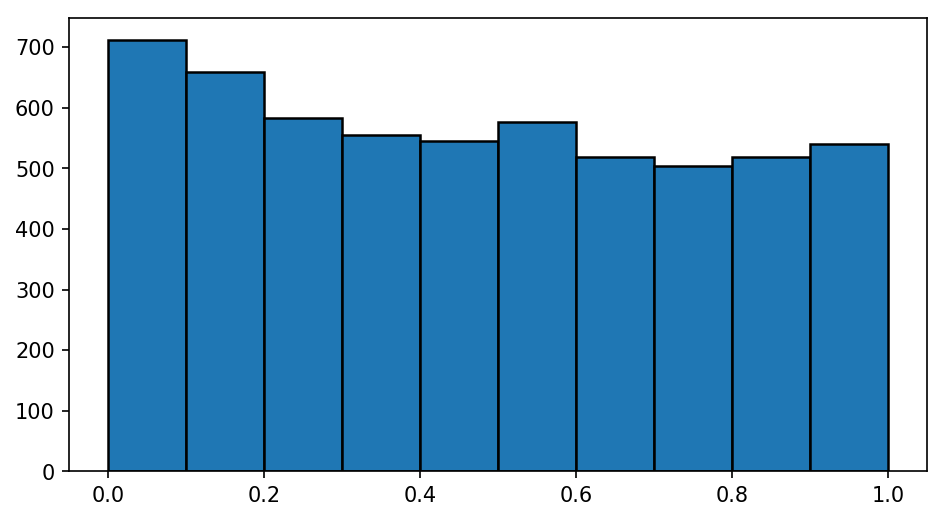

In [32]:
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 150
mpl.rcParams['savefig.dpi'] = 150
mpl.rcParams['figure.figsize'] =7.375, 4 # 7.375, 3.375

histogram = manhattan_plot_df.dropna()
#type(manhattan_plot_df)
#print(manhattan_plot_df.pvalue)
print (histogram.pvalue.min())
print (histogram.pvalue.max())
plt.hist(histogram.pvalue, bins=10, edgecolor='black', linewidth=1.2)

## Manhattan Plot

In [33]:
## figure dimensions
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 150
mpl.rcParams['savefig.dpi'] = 150
mpl.rcParams['figure.figsize'] =7.375, 4 # 7.375, 3.375

Text(0,0.5,'-log10 (p-value)')

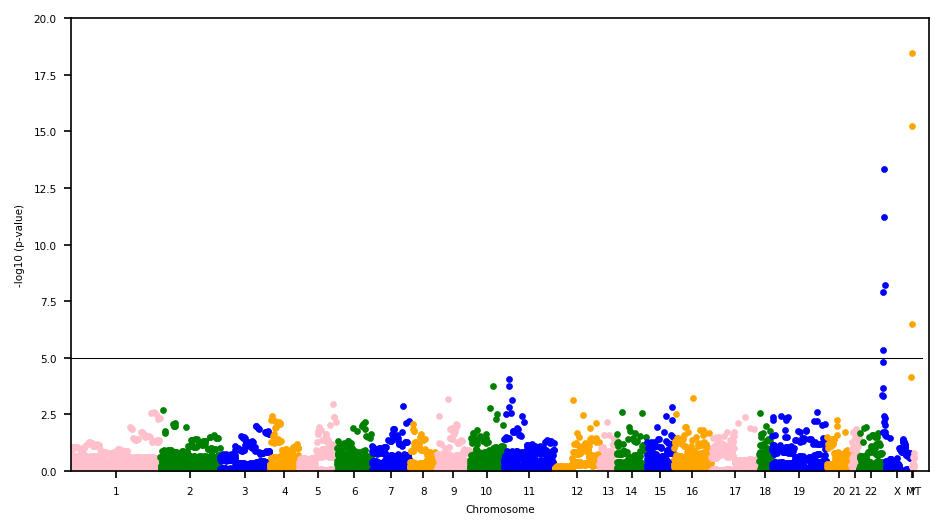

In [34]:
import matplotlib.pyplot as plt
mpl.rcParams.update({'font.size': 5})
manhattan_plot_df2.chromosome_int = manhattan_plot_df2.chromosome_int.astype('category')
#print (manhattan_plot_df2)
manhattan_plot_df2 = manhattan_plot_df2.sort_values('chromosome_int')


# How to plot gene vs. -log10(pvalue) and colour it by chromosome?
manhattan_plot_df2['spacing'] = range(len(manhattan_plot_df2))
spacing = range(len(manhattan_plot_df2))
manhattan_plot_df2['spacing'] = manhattan_plot_df2['spacing'] * 1
#print (manhattan_plot_df2)

df_grouped = manhattan_plot_df2.groupby(('chromosome_int'))


chro_names = ['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','X',"Y",'MT']
fig = plt.figure()
ax = fig.add_subplot(111)
colors = ['pink','green','blue', 'orange']
x_labels = []
x_labels_pos = []
ax.plot([0, 6000], [5, 5], 'k-', lw=.5)
for num, (name, group) in enumerate(df_grouped):
    group.plot(kind='scatter', x='spacing', y='-log_pvalue',color=colors[num % len(colors)], ax=ax, s = 5)
    x_labels.append(name)
    x_labels_pos.append((group['spacing'].iloc[-1] - (group['spacing'].iloc[-1] - group['spacing'].iloc[0])/2)) # will print tick in the middle of each chromosome

ax.set_xticks(x_labels_pos)
ax.set_xticklabels(chro_names)
ax.set_xlim([0, len(manhattan_plot_df2)+100])
ax.set_ylim([0, 20]) # MAY NEED TO CHANGE
ax.set_xlabel('Chromosome')
ax.set_ylabel('-log10 (p-value)')



# CORRELATION MAPS BASED ON TARGET PROTEINS
Proteins correlation heatmaps. Pearsons Correlation for 12 proteins who have an extremely low p_val / high -log10p_val and are associated with the difference in men and women. 1.) The first correlation map shows relation ship between protein in men and women. The more yellow the that each of the genes correlations correlate in men and women 2.) shows correlation in proteins in women 3.) shows correlation in protein in men

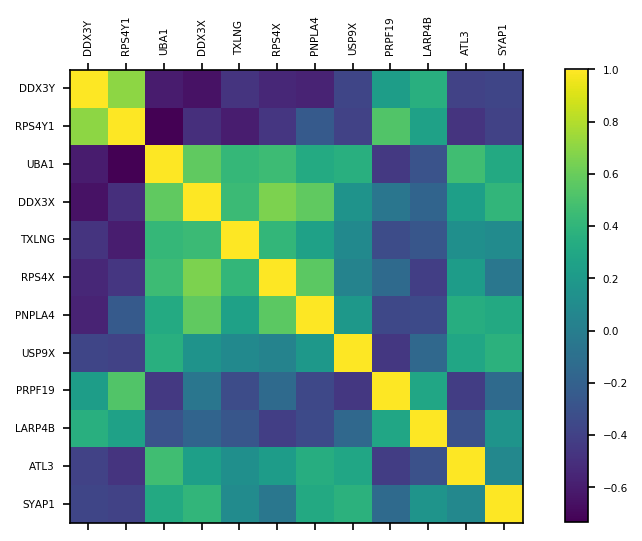

                 ENSG00000067048  ENSG00000129824  ENSG00000130985  \
ENSG00000067048         1.000000         0.703679        -0.604910   
ENSG00000129824         0.703679         1.000000        -0.734202   
ENSG00000130985        -0.604910        -0.734202         1.000000   
ENSG00000215301        -0.648011        -0.501179         0.578641   
ENSG00000086712        -0.476333        -0.593979         0.421257   
ENSG00000198034        -0.543480        -0.461203         0.452972   
ENSG00000006757        -0.558713        -0.241590         0.329205   
ENSG00000124486        -0.369265        -0.390518         0.360682   
ENSG00000110107         0.230755         0.529873        -0.444364   
ENSG00000107929         0.360101         0.260797        -0.289781   
ENSG00000184743        -0.394362        -0.475983         0.470360   
ENSG00000169895        -0.371602        -0.393588         0.318031   

                 ENSG00000215301  ENSG00000086712  ENSG00000198034  \
ENSG00000067048    

In [35]:
import matplotlib.ticker as ticker
import matplotlib.pyplot as plt

target_genes = ["ENSG00000067048","ENSG00000129824","ENSG00000130985","ENSG00000215301", "ENSG00000086712", "ENSG00000198034", 
                "ENSG00000006757","ENSG00000124486", "ENSG00000110107", "ENSG00000107929", "ENSG00000184743", "ENSG00000169895"
]

gene_names = ["DDX3Y", "RPS4Y1", "UBA1", "DDX3X", "TXLNG", "RPS4X", "PNPLA4","USP9X", "PRPF19", "LARP4B", "ATL3", "SYAP1"]

#create a df filled with import target genes and do correlation map
target_genes_df = need = table5[target_genes]


fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(target_genes_df.corr(), interpolation='nearest')
ax.set_xticklabels(['']+gene_names, rotation=90)
ax.set_yticklabels(['']+gene_names)
tick_spacing = 1
ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
fig.colorbar(cax)
plt.show()

print (target_genes_df.corr())
#will print heatmap without gene names
#plt.matshow(target_genes_df.corr())

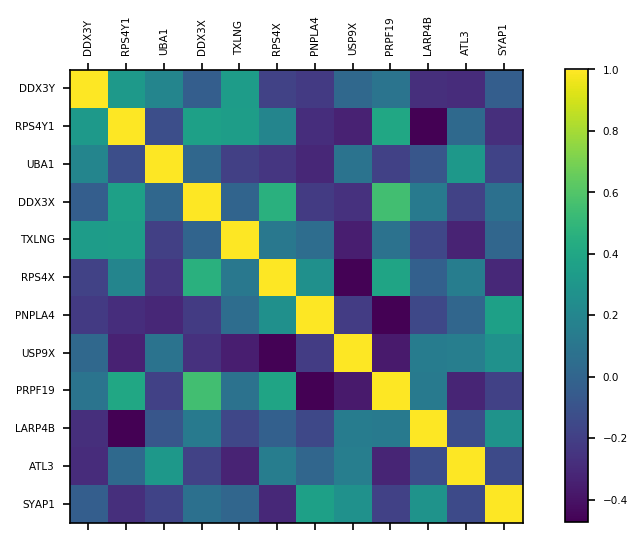

                 ENSG00000067048  ENSG00000129824  ENSG00000130985  \
ENSG00000067048         1.000000         0.318174         0.198877   
ENSG00000129824         0.318174         1.000000        -0.117914   
ENSG00000130985         0.198877        -0.117914         1.000000   
ENSG00000215301        -0.033646         0.365260         0.021118   
ENSG00000086712         0.341148         0.348765        -0.196434   
ENSG00000198034        -0.184841         0.196948        -0.238558   
ENSG00000006757        -0.225720        -0.283733        -0.307783   
ENSG00000124486         0.025686        -0.332821         0.085385   
ENSG00000110107         0.091987         0.401710        -0.187377   
ENSG00000107929        -0.277919        -0.472043        -0.076647   
ENSG00000184743        -0.284272         0.029615         0.310115   
ENSG00000169895        -0.034196        -0.275032        -0.179477   

                 ENSG00000215301  ENSG00000086712  ENSG00000198034  \
ENSG00000067048    

In [36]:
## FOR ONLY WOMEN
import matplotlib.ticker as ticker
target_genes_df = table5.set_index('sex')
target_genes_df = target_genes_df.filter(like="female", axis = 0)



target_genes = ["ENSG00000067048","ENSG00000129824","ENSG00000130985","ENSG00000215301", "ENSG00000086712", "ENSG00000198034", 
                "ENSG00000006757","ENSG00000124486", "ENSG00000110107", "ENSG00000107929", "ENSG00000184743", "ENSG00000169895"
]

gene_names = ["DDX3Y", "RPS4Y1", "UBA1", "DDX3X", "TXLNG", "RPS4X", "PNPLA4","USP9X", "PRPF19", "LARP4B", "ATL3", "SYAP1"]

#creats df of only target genes // will take out sex for correlation map
target_genes_df = target_genes_df[target_genes]

# will show all gene names in heatmap

fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(target_genes_df.corr(), interpolation='nearest')
ax.set_xticklabels(['']+gene_names, rotation=90)
ax.set_yticklabels(['']+gene_names)
tick_spacing = 1
ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
fig.colorbar(cax)
plt.show()



print (target_genes_df.corr())
# heatmap without gene names
#plt.matshow(target_genes_df.corr())

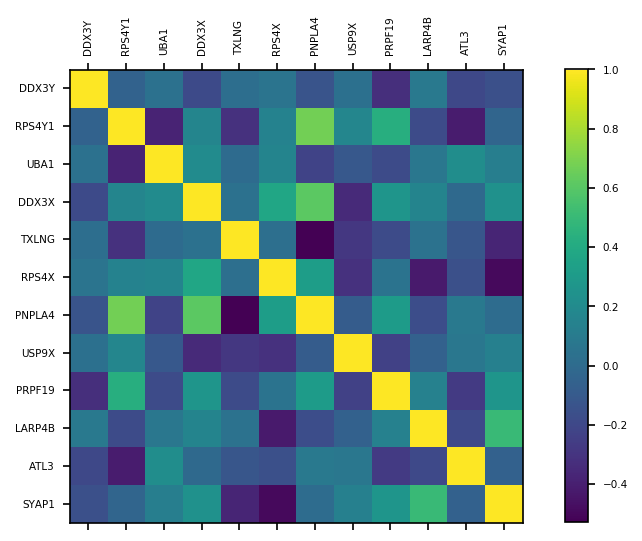

                 ENSG00000067048  ENSG00000129824  ENSG00000130985  \
ENSG00000067048         1.000000        -0.047295         0.039368   
ENSG00000129824        -0.047295         1.000000        -0.379744   
ENSG00000130985         0.039368        -0.379744         1.000000   
ENSG00000215301        -0.183806         0.164869         0.211145   
ENSG00000086712         0.020775        -0.310983         0.006600   
ENSG00000198034         0.060425         0.151560         0.161188   
ENSG00000006757        -0.133030         0.674102        -0.221647   
ENSG00000124486         0.035845         0.169910        -0.106179   
ENSG00000110107        -0.325935         0.428606        -0.179343   
ENSG00000107929         0.088353        -0.180619         0.075400   
ENSG00000184743        -0.195822        -0.413463         0.222119   
ENSG00000169895        -0.154605        -0.032120         0.127463   

                 ENSG00000215301  ENSG00000086712  ENSG00000198034  \
ENSG00000067048    

In [37]:
## FOR ONLY MEN

target_genes_df = table5[(table5.sex == "male")]
target_genes = ["ENSG00000067048","ENSG00000129824","ENSG00000130985","ENSG00000215301", "ENSG00000086712", "ENSG00000198034", 
                "ENSG00000006757","ENSG00000124486", "ENSG00000110107", "ENSG00000107929", "ENSG00000184743", "ENSG00000169895"
]

gene_names = ["DDX3Y", "RPS4Y1", "UBA1", "DDX3X", "TXLNG", "RPS4X", "PNPLA4","USP9X", "PRPF19", "LARP4B", "ATL3", "SYAP1"]



#creats df of only target genes // will take out sex for correlation map
target_genes_df = target_genes_df[target_genes]

# will show all gene names in heatmap

fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(target_genes_df.corr(), interpolation='nearest')
ax.set_xticklabels(['']+gene_names, rotation=90)
ax.set_yticklabels(['']+gene_names)
tick_spacing = 1
ax.xaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
ax.yaxis.set_major_locator(ticker.MultipleLocator(tick_spacing))
fig.colorbar(cax)
plt.show()

print (target_genes_df.corr())
target_genes_df_men = target_genes_df
# heat map without gene names
#plt.matshow(target_genes_df.corr())

# PCA with 70 individuals with protien anaylsis

In [ ]:
pca_eigenvalues, pca_score, _ = hl.hwe_normalized_pca(vds2_subset.GT, k = 5)
pprint(pca_eigenvalues)
pprint (pca_score.scores[4].show())
pca_score.s.show()

2018-08-07 18:57:37 Hail: INFO: hwe_normalized_pca: running PCA using 17955582 variants.
2018-08-07 18:59:12 Hail: INFO: pca: running PCA with 5 components...


In [ ]:
pca_score.count()

In [ ]:
pca_score.show()

In [ ]:
s = pca_score.s.collect()
data = pd.DataFrame(s)
from google.cloud import storage
storage.Client()
client = storage.Client()
bucket = client.get_bucket('python-ines') #name of the bucket
blob = bucket.blob('sample-nneka.csv') #name of the file
data.to_csv('sample-nneka.csv', encoding='utf-8', index=False)  #write a csv in the local directory
blob.upload_from_filename('sample-nneka.csv')

In [ ]:
#new table for pca data 
pcatable = pca_score.select(Super_Population = vds2_subset.cols()[pca_score.s].population,
                             PC1 = pca_score.scores[0],
                             PC2 = pca_score.scores[1]
                        
                           )



pca_df = hl.Table.to_pandas(pcatable)

pcatable.show()
pprint(pca_df)


In [ ]:
# SHOW PCA


#will show figure
p = figure(title = 'PCA with 70 individuals: population',plot_width=800, plot_height=700, background_fill_color = '#EEEEEE', x_axis_label = 'PC1', y_axis_label = 'PC2')

colors = { 'YRI': 'green', 'JPT':'orange', 'CHB':'blue', 'CEU':'red'} ##dictionary for colors
for pop, color in colors.items():
    #print(pop)
    #print(color)
    samples = pca_df[pca_df['Super_Population'] == pop] ## will match population category fo specific plot
    
    #plot point
    p.scatter(samples['PC1'], samples['PC2'], color = color, alpha = 0.5, legend = pop, size = 4)
    
p.legend.click_policy = 'hide'
    
# if show(p) stops working restart kernal and try agian
show(p) 


In [ ]:
vds2_subset = vds2_subset.annotate_cols(pca = pca_score[vds2_subset.s])

#vds2_subset.col.pca.scores[1].show()

# GWAS: REGRESSED SEX ON GT
#### Logistic Regression where I regress sex on genotype call and adjus for population and PCA Values

In [ ]:
gwas_linear2 = hl.logistic_regression(
    test = 'lrt',
    y=vds2_subset.col.sex_bool,
    x=vds2_subset.GT.n_alt_alleles(),
    covariates=[vds2_subset.population_float, vds2_subset.pca.scores[0], vds2_subset.pca.scores[1], vds2_subset.pca.scores[2]]
)
       



In [ ]:
pvals = gwas_linear2.logreg.p_value.collect()


In [ ]:
qqplot(pvals)

In [ ]:
## GWAS MANHATTAN PLOT
filtered = gwas_linear2.filter_rows(gwas_linear2.row.logreg.p_value < .007, keep = True)

#filtered.count()
x = hl.plot.manhattan(filtered.row.logreg.p_value, locus=filtered.row.locus, title="Practice", size=4, hover_fields=None)
show(x)

In [86]:
filtered.row.logreg.p_value.show(3)

+---------------+----------------+-------------+
| locus         | alleles        |      <expr> |
+---------------+----------------+-------------+
| locus<GRCh37> | array<str>     |     float64 |
+---------------+----------------+-------------+
| 1:719489      | ["C","CATAAT"] | 2.36822e-03 |
| 1:741397      | ["A","G"]      | 2.22080e-03 |
| 1:811693      | ["C","G"]      | 4.99348e-03 |
+---------------+----------------+-------------+
showing top 3 rows



## LINEAR REGRESSION: RELATIONSHIP BETWEEN PROTEIN EXPRESSION AND SEX

In [ ]:
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool
from bokeh.io import output_notebook
output_notebook()


In [ ]:
vds2_subset.describe()
vds2_subset.col.show()

In [ ]:
#Linear Regression

#vds2_subet = vds2_subset.filter_cols(vds2_subset.ENSG00000198034 > -30, keep = True)


gwas_linear2 = hl.logistic_regression(
           test='wald',
           y=vds2_subset.sex_bool,
           x=vds2_subset.GT.n_alt_alleles(),
    covariates=[vds2_subset.population_float, vds2_subset.pca.scores[0], vds2_subset.pca.scores[1], vds2_subset.pca.scores[2]]
)
gwas_linear2.row.describe()
#pvals = gwas_linear2.linreg.p_value.collect()
#print(pvals)
qqplot(pvals)

In [ ]:
# When you filter 40,000,000 million variants your table shape is (2439298, 70)
filtered = gwas_linear2.filter_rows(gwas_linear2.row.linreg.p_value < .007, keep = True)
#filtered.count()

In [ ]:
filtered.row.linreg.p_value.show()

In [ ]:
x = hl.plot.manhattan(filtered.row.linreg.p_value, locus=filtered.row.locus, title="Practice", size=4, hover_fields=None)
show(x)

# cis pQTLs ANALYSIS
1) Filtering your dataset (keep 12 proteins, keep only proteins which have >50% of the data for the protein level, remove NA, then filter rows with AF and locus position (per chromosome to start)
2) PCA
3) Doing linear regression

#### **So it is import to note that as of right now I have no idea how to loop through hail. Hail takes any variable to be name in the Matrix table not as a variable, thus it is impossible to loop through all the protein with my code. I must copy the name of the gene to all the places in this section of code to do cis pQTL Analysis on the protein.

In [ ]:
vds3_subset = dataset

In [ ]:
## check protein has >50% of data
#step1 = vds2_subset.filter_cols(vds2_subset.ENSG00000110107 > 30, keep=False)
step1 = vds3_subset


In [ ]:
#filter based on sex, keep on men or women
step1 = step1.filter_cols(step1.sex ==  'female', keep=True)
print (step1.col.ENSG00000110107.show())
#print (step1.show(5))


In [ ]:
import pyensembl
ensembl = pyensembl.EnsemblRelease(release=75)

## ENSG00000006757 PNPLA4    
## ENSG00000129824 RPS4Y1
## ENSG00000110107 PRPF19


id_info = ensembl.gene_by_id('ENSG00000133731')
print(type(id_info.start))
print(id_info.end)
print (id_info)

id_info = ensembl.gene_by_id('ENSG00000110107')
print(type(id_info.start))
print(id_info.end)
print (id_info)




In [ ]:
#select only part of the genome that you want
#intervals = hl.filter_intervals(step2,[hl.parse_locus_interval(x) for x in [‘chr10-chr11’]], keep=True)
interval = hl.filter_intervals(step1, [hl.parse_locus_interval('11:%s-%s' % (str(id_info.start - 20000), str(id_info.end + 20000)))])
print(interval.count())

print (str(id_info.start - 200000))

In [ ]:
# sample and variant qc
vds3_subset = hl.sample_qc(interval)
vds3_subset = hl.variant_qc(vds3_subset)
vds3_subset.describe()


In [ ]:
## filter based on minor allele frequency
#interval = vds3_subset.filter_rows(vds3_subset.variant_qc.AF[1] > 0.0001, keep=True)
interval = vds3_subset
print (interval.col.ENSG00000110107.show())
print(interval.count())

In [ ]:
## filter out NA values
interval = interval.filter_cols(interval.ENSG00000110107 > -30, keep = True)  ##filter out NAs
print (interval.count())
print (interval.col.ENSG00000110107.show())

In [ ]:
## PCA
pca_eigenvalues, pca_score, _ = hl.hwe_normalized_pca(interval.GT, k = 5)
pprint(pca_eigenvalues)
pprint (pca_score.scores[4].show())
pca_score.s.show()



vds3_subset = interval.annotate_cols(pca = pca_score[interval.s])
#vds2_subset.col.pca.scores[1].show()

In [ ]:

pqtl = hl.linear_regression(
            y=vds3_subset.ENSG00000110107,
            x=vds3_subset.GT.n_alt_alleles(),
            covariates=[vds3_subset.population_float, vds3_subset.sex_bool, vds3_subset.pca.scores[0]])

#pqtl = pqtl.row.order_by(hl.asc(pqtl.row.linreg.p_value))
values = pqtl.rows()
values.linreg.p_value.show(36)
values = values.linreg.p_value.collect()
sortedvalues = sorted(values)
print ("here", sorted(values))

In [ ]:
from bokeh.plotting import figure, output_file, show


x = hl.plot.manhattan(filtered.row.linreg.p_value, locus=filtered.row.locus, title="Practice", size=4, hover_fields=None)
show(x)

In [ ]:
## GWAS MANHATTAN PLOT
filtered = pqtl.filter_rows(pqtl.row.linreg.p_value < .9, keep = True)
#filtered = pqtl
print (filtered.count())



## Try Lasso Regression ??

# POPULATION RE ANALYSIS BASED ON PAPER

## Population over Protein Expression Regression


I save all genes according to literture are significant with regards to the relationship of gener and protein expression. Then I shuffle the remaining genes. I take a subset of the remaining genes about 100 and concat that with the genes I need and use this to do regression. I do this to make a subset of proteins because Hail can not take all the data

In [ ]:
import pandas as pd
#New annotations - FULL TABLE OF PROTEIN ANNOTATIONS
with fs.open('gs://nneka/Supplementary_Table_1.csv',"rt") as f:
    table5 = pd.read_csv(f, na_values = str, header = 0)
#table5 = (hl.import_table('gs://nneka/Supplementary_Table_1.csv', delimiter=',', impute=True, missing='NA').key_by('Individual ID'))

#save columns I need in a separate df
need = table5[['Individual LCLs', 'sex', 'population', 'FamilyID', 'Individual ID', 'dad', 'mom',
'ENSG00000137267','ENSG00000159335',
'ENSG00000055950','ENSG00000140575','ENSG00000108010','ENSG00000164904','ENSG00000163191',
'ENSG00000092964','ENSG00000162441','ENSG00000183617','ENSG00000108825','ENSG00000111906',
'ENSG00000144635','ENSG00000132274','ENSG00000104835','ENSG00000067369','ENSG00000172531','ENSG00000104921','ENSG00000137807',
'ENSG00000167862','ENSG00000165416','ENSG00000139116','ENSG00000141522','ENSG00000123329','ENSG00000177885','ENSG00000026297',
'ENSG00000105254','ENSG00000134602','ENSG00000117228','ENSG00000176261','ENSG00000172845','ENSG00000156110','ENSG00000104522',
'ENSG00000148834','ENSG00000067955','ENSG00000100596','ENSG00000028277','ENSG00000133316','ENSG00000023892','ENSG00000103653',
'ENSG00000101911','ENSG00000114021','ENSG00000113194','ENSG00000139641','ENSG00000137513','ENSG00000177613','ENSG00000121064',
'ENSG00000161800','ENSG00000068796','ENSG00000124608','ENSG00000161533','ENSG00000203896','ENSG00000145365','ENSG00000105723',
'ENSG00000100714','ENSG00000074696','ENSG00000109534','ENSG00000102879','ENSG00000104814','ENSG00000052749','ENSG00000159140',
'ENSG00000136717','ENSG00000132341','ENSG00000164258','ENSG00000013375','ENSG00000134900','ENSG00000123240','ENSG00000084652',
'ENSG00000111832','ENSG00000186468','ENSG00000181929','ENSG00000167851','ENSG00000204084','ENSG00000198900','ENSG00000100441',
'ENSG00000197713','ENSG00000173436','ENSG00000113048','ENSG00000167461','ENSG00000180992','ENSG00000147813','ENSG00000134597',
'ENSG00000101160','ENSG00000130726','ENSG00000135655','ENSG00000141994','ENSG00000135899','ENSG00000197771','ENSG00000174842',
'ENSG00000145375','ENSG00000137770','ENSG00000134996','ENSG00000127948','ENSG00000149792','ENSG00000159210','ENSG00000089009',
'ENSG00000196405','ENSG00000104687','ENSG00000196591','ENSG00000148908','ENSG00000138594','ENSG00000197102','ENSG00000176393',
'ENSG00000136279','ENSG00000241343','ENSG00000182952','ENSG00000133835','ENSG00000123562','ENSG00000090054','ENSG00000077097',
'ENSG00000179222','ENSG00000114978','ENSG00000196976','ENSG00000205250','ENSG00000116221','ENSG00000132256','ENSG00000145912',
'ENSG00000132912','ENSG00000117505','ENSG00000132646','ENSG00000132603','ENSG00000083223','ENSG00000063177','ENSG00000167986',
'ENSG00000168434','ENSG00000103490','ENSG00000169714','ENSG00000154582','ENSG00000100075','ENSG00000125753','ENSG00000100612',
'ENSG00000133026','ENSG00000155130','ENSG00000105810','ENSG00000165025','ENSG00000198258','ENSG00000126653','ENSG00000150093',
'ENSG00000166200','ENSG00000122565','ENSG00000112996','ENSG00000071539','ENSG00000148308','ENSG00000103249','ENSG00000135018',
'ENSG00000146540','ENSG00000143314','ENSG00000185163','ENSG00000187145','ENSG00000139726','ENSG00000165983','ENSG00000164944',
'ENSG00000127884','ENSG00000184220','ENSG00000147874','ENSG00000117450','ENSG00000089248','ENSG00000011243','ENSG00000118939',
'ENSG00000147065','ENSG00000151876','ENSG00000136271','ENSG00000135930','ENSG00000103316','ENSG00000127824','ENSG00000211456',
'ENSG00000047249','ENSG00000140983','ENSG00000106588','ENSG00000141759','ENSG00000125656','ENSG00000181915','ENSG00000100567',
'ENSG00000105699','ENSG00000102178','ENSG00000164687','ENSG00000196236','ENSG00000065135','ENSG00000122299','ENSG00000120063',
'ENSG00000188313','ENSG00000120656','ENSG00000124491','ENSG00000182810','ENSG00000132313','ENSG00000182481','ENSG00000130638',
'ENSG00000168961','ENSG00000143179','ENSG00000115241','ENSG00000150961','ENSG00000095787','ENSG00000184992','ENSG00000217930',
'ENSG00000101421','ENSG00000131165','ENSG00000148229','ENSG00000060688','ENSG00000180370','ENSG00000152492','ENSG00000178425',
'ENSG00000124126','ENSG00000185246','ENSG00000115145','ENSG00000117868','ENSG00000100097','ENSG00000101444','ENSG00000174748',
'ENSG00000124198','ENSG00000177192','ENSG00000166881','ENSG00000060982','ENSG00000180448','ENSG00000173020','ENSG00000131504',
'ENSG00000135632','ENSG00000214046','ENSG00000136783','ENSG00000120333','ENSG00000157326','ENSG00000177105','ENSG00000015153',
'ENSG00000136381','ENSG00000228253','ENSG00000196576','ENSG00000077514','ENSG00000197045','ENSG00000118246','ENSG00000163636',
'ENSG00000004534','ENSG00000103363','ENSG00000169032','ENSG00000165704','ENSG00000104635','ENSG00000104969','ENSG00000149929',
'ENSG00000140395','ENSG00000124571','ENSG00000101017','ENSG00000164924','ENSG00000132330','ENSG00000137804','ENSG00000111912',
'ENSG00000169288','ENSG00000021355','ENSG00000125877','ENSG00000116288'


  
              ]]

#then remove them from the orginal df
table5 = table5.drop(['Individual LCLs', 'sex', 'population', 'FamilyID', 'Individual ID', 'dad', 'mom',
'ENSG00000137267','ENSG00000159335',
'ENSG00000055950','ENSG00000140575','ENSG00000108010','ENSG00000164904','ENSG00000163191',
'ENSG00000092964','ENSG00000162441','ENSG00000183617','ENSG00000108825','ENSG00000111906',
'ENSG00000144635','ENSG00000132274','ENSG00000104835','ENSG00000067369','ENSG00000172531','ENSG00000104921','ENSG00000137807',
'ENSG00000167862','ENSG00000165416','ENSG00000139116','ENSG00000141522','ENSG00000123329','ENSG00000177885','ENSG00000026297',
'ENSG00000105254','ENSG00000134602','ENSG00000117228','ENSG00000176261','ENSG00000172845','ENSG00000156110','ENSG00000104522',
'ENSG00000148834','ENSG00000067955','ENSG00000100596','ENSG00000028277','ENSG00000133316','ENSG00000023892','ENSG00000103653',
'ENSG00000101911','ENSG00000114021','ENSG00000113194','ENSG00000139641','ENSG00000137513','ENSG00000177613','ENSG00000121064',
'ENSG00000161800','ENSG00000068796','ENSG00000124608','ENSG00000161533','ENSG00000203896','ENSG00000145365','ENSG00000105723',
'ENSG00000100714','ENSG00000074696','ENSG00000109534','ENSG00000102879','ENSG00000104814','ENSG00000052749','ENSG00000159140',
'ENSG00000136717','ENSG00000132341','ENSG00000164258','ENSG00000013375','ENSG00000134900','ENSG00000123240','ENSG00000084652',
'ENSG00000111832','ENSG00000186468','ENSG00000181929','ENSG00000167851','ENSG00000204084','ENSG00000198900','ENSG00000100441',
'ENSG00000197713','ENSG00000173436','ENSG00000113048','ENSG00000167461','ENSG00000180992','ENSG00000147813','ENSG00000134597',
'ENSG00000101160','ENSG00000130726','ENSG00000135655','ENSG00000141994','ENSG00000135899','ENSG00000197771','ENSG00000174842',
'ENSG00000145375','ENSG00000137770','ENSG00000134996','ENSG00000127948','ENSG00000149792','ENSG00000159210','ENSG00000089009',
'ENSG00000196405','ENSG00000104687','ENSG00000196591','ENSG00000148908','ENSG00000138594','ENSG00000197102','ENSG00000176393',
'ENSG00000136279','ENSG00000241343','ENSG00000182952','ENSG00000133835','ENSG00000123562','ENSG00000090054','ENSG00000077097',
'ENSG00000179222','ENSG00000114978','ENSG00000196976','ENSG00000205250','ENSG00000116221','ENSG00000132256','ENSG00000145912',
'ENSG00000132912','ENSG00000117505','ENSG00000132646','ENSG00000132603','ENSG00000083223','ENSG00000063177','ENSG00000167986',
'ENSG00000168434','ENSG00000103490','ENSG00000169714','ENSG00000154582','ENSG00000100075','ENSG00000125753','ENSG00000100612',
'ENSG00000133026','ENSG00000155130','ENSG00000105810','ENSG00000165025','ENSG00000198258','ENSG00000126653','ENSG00000150093',
'ENSG00000166200','ENSG00000122565','ENSG00000112996','ENSG00000071539','ENSG00000148308','ENSG00000103249','ENSG00000135018',
'ENSG00000146540','ENSG00000143314','ENSG00000185163','ENSG00000187145','ENSG00000139726','ENSG00000165983','ENSG00000164944',
'ENSG00000127884','ENSG00000184220','ENSG00000147874','ENSG00000117450','ENSG00000089248','ENSG00000011243','ENSG00000118939',
'ENSG00000147065','ENSG00000151876','ENSG00000136271','ENSG00000135930','ENSG00000103316','ENSG00000127824','ENSG00000211456',
'ENSG00000047249','ENSG00000140983','ENSG00000106588','ENSG00000141759','ENSG00000125656','ENSG00000181915','ENSG00000100567',
'ENSG00000105699','ENSG00000102178','ENSG00000164687','ENSG00000196236','ENSG00000065135','ENSG00000122299','ENSG00000120063',
'ENSG00000188313','ENSG00000120656','ENSG00000124491','ENSG00000182810','ENSG00000132313','ENSG00000182481','ENSG00000130638',
'ENSG00000168961','ENSG00000143179','ENSG00000115241','ENSG00000150961','ENSG00000095787','ENSG00000184992','ENSG00000217930',
'ENSG00000101421','ENSG00000131165','ENSG00000148229','ENSG00000060688','ENSG00000180370','ENSG00000152492','ENSG00000178425',
'ENSG00000124126','ENSG00000185246','ENSG00000115145','ENSG00000117868','ENSG00000100097','ENSG00000101444','ENSG00000174748',
'ENSG00000124198','ENSG00000177192','ENSG00000166881','ENSG00000060982','ENSG00000180448','ENSG00000173020','ENSG00000131504',
'ENSG00000135632','ENSG00000214046','ENSG00000136783','ENSG00000120333','ENSG00000157326','ENSG00000177105','ENSG00000015153',
'ENSG00000136381','ENSG00000228253','ENSG00000196576','ENSG00000077514','ENSG00000197045','ENSG00000118246','ENSG00000163636',
'ENSG00000004534','ENSG00000103363','ENSG00000169032','ENSG00000165704','ENSG00000104635','ENSG00000104969','ENSG00000149929',
'ENSG00000140395','ENSG00000124571','ENSG00000101017','ENSG00000164924','ENSG00000132330','ENSG00000137804','ENSG00000111912',
'ENSG00000169288','ENSG00000021355','ENSG00000125877','ENSG00000116288'
  
              ], axis = 1)

rows, columns = table5.shape
columns = list(table5)
indices = columns
#print (list(table5))
import random


random.shuffle(indices) # will give you random samples or individuals

#re orders the table
table5 = table5.ix[:, indices]

# will only save a subset of the array
table5 = table5.iloc[:,0:950]
print(table5.shape)

#add back in the data i need
protein_subset = pd.concat([need, table5], axis=1, sort=False)
print (protein_subset)
print (type(protein_subset))
data2 = protein_subset





In [ ]:
# annontate with protein functions infomation

with fs.open('gs://nneka/Supplementary_Table_2.csv',"rt") as f:
    table6 = pd.read_csv(f, na_values = str, header = 1, index_col = "GeneID")

print (table6['Description']["ENSG00000137267"])


In [ ]:
#TABLE 2
# MUST CONVERT SEX TO FLOAT VALUES (0,1) in Pandas so before you convert to table and then annotate

#ADD SUPER_POPULATION_CLASSIFICATION TO TABLE
#data2 = hl.Table.to_pandas(table2) # convert to pandas

from sklearn.preprocessing import LabelEncoder
key = data2["sex"].values

#create lable encoder for sex
le2 = LabelEncoder()
le2.fit(['male', 'female'])
list(le2.classes_)
print (le2.transform(key))
print (type(le2.transform(key)))
reverse_key = le2.transform(key)
#list(le.inverse_transform(reverse_key))
print (le2.inverse_transform(reverse_key))

data2["sex_bool"] = pd.Series(le2.transform(key).astype(float), index=data2.index) # add column

key = data2["population"].values

#create lable encoder for population
le3 = LabelEncoder()
le3.fit(['CEU', 'CHB', 'JPT', 'YRI'])
list(le3.classes_)
print (le3.transform(key))
print (type(le3.transform(key)))
reverse_key = le3.transform(key)
#list(le.inverse_transform(reverse_key))
print (le3.inverse_transform(reverse_key))

data2["population_float"] = pd.Series(le3.transform(key).astype(float)) # add column

#
#table2 = hl.Table.from_pandas(data2).key_by('Individual_ID') # convert back to table


In [ ]:
import pyensembl
ensembl = pyensembl.EnsemblRelease(release=75)


## example of how to use pyensembl
print(ensembl.gene_by_id('ENSG00000067048'))
gene_transcript = ensembl.gene_by_id('ENSG00000067048') # all gene info
print(type(gene_transcript.contig)) ## will show whcih chromosome it is on
print(type(gene_transcript.start)) ## Will show were the gene starts 

# creates a list with just the genes and no other column / clinical annotations
x = []
#for i in vds2_subset.col:
for i in data2:
    x = np.append(x,i)

genes = list(filter(lambda k: 'ENSG' in k, x)) #filters table for just protein levels

#for i in table3:
#    genes = np.append(genes,i)

#protein_df = vds2_subset.cols().to_pandas()
protein_df = data2


all_p_values = []
all_start_positions = []
all_chromosome_locations = []
chro_int = []
for i in genes:
    print (i)
    print (type(i))
    #x = protein_df['sex_bool']
    #y = protein_df[i]
    #z = protein_df['population_float']
    
    #save pval and logp!!
    #Linear Regression + P Values
    lm1 = smf.ols(formula = '%s ~ population_float' %  i, data = protein_df).fit()
    ### the formula is  shows protein expression == y, sex == x, population == confounder
    p_value = lm1.pvalues.population_float
    #log_p_value = -math.log10(lm1.pvalues.sex_bool)
    print (p_value)
    print (type(p_value))
    all_p_values = np.append(all_p_values, p_value)
    
    #Gene Chromosome Information
    id_info = ensembl.gene_by_id(i)
    chro_info = id_info.contig
    if str(chro_info) == 'Y' or str(chro_info) == 'X':
        chro_info1 = '23'
        print(chro_info)
        print(chro_info1)
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info1)
    elif str(chro_info) == "MT":
        chro_info1 = '24'
        print(chro_info)
        print(chro_info1)
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info1)
    elif str(chro_info) == "HSCHR6_MHC_QBL":
        print ("SKIP")
    elif str(chro_info) == "HSCHR6_MHC_COX":
        chro_info1 = '24'
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info1)
    else:
        all_chromosome_locations = np.append(all_chromosome_locations, chro_info)
    
    print (chro_info)
    print (type(chro_info))
    
    
    #Gene Locotion Info
    start_info = id_info.start
    print (start_info)
    print (type(start_info), '\n')
    all_start_positions = np.append(all_start_positions, start_info)
    
#create df with just pvalues, geneIDs and chromosome
#FOR ASSOCIATE PLOTS
manhattan_plot_df = pd.DataFrame ({'chromosome': all_chromosome_locations, 'position': all_start_positions, 'GeneID': genes, 'pvalue': all_p_values, })

# convert dataframe to numpy array for assocplots
manhattan_plot_data = manhattan_plot_df.values ## will give you brackets and not parenthesis

#manhattan_plot_data = manhattan_plot_df.to_records() ## will give you parenthesis
print ("NumPy Dataframe without -log p-values")
print (type(manhattan_plot_data))
print (manhattan_plot_data)

#take -logpvalues and store in different df (because assoplots needs array without -logpvalues)
#create df with pvalues, -logpvalue, geneIDs and chromosome
manhattan_plot_df2 = pd.DataFrame ({'chromosome': all_chromosome_locations,'position': all_start_positions, 'GeneID': genes, 'pvalue': all_p_values,  })

print( 'Dataframe with -log p-values')
manhattan_plot_df2['-log_pvalue'] = -np.log10(manhattan_plot_df.pvalue)
print(all_chromosome_locations)
manhattan_plot_df2['chromosome_int'] = all_chromosome_locations.astype(int) ## add protein annotations

#append the protein descriptions
protein_description = []
for i in genes:
    if i in table6.index:
        print("-- ", table6["Description"][i])
        protein_description = np.append(protein_description, table6["Description"][i])
    else:
        print("SKIP")
        protein_description = np.append(protein_description, "NaN")
manhattan_plot_df2["Description"] = protein_description


print (manhattan_plot_df2)





In [ ]:
import matplotlib.pyplot as plt
mpl.rcParams.update({'font.size': 5})
manhattan_plot_df2.chromosome_int = manhattan_plot_df2.chromosome_int.astype('category')
print (manhattan_plot_df2)
manhattan_plot_df2 = manhattan_plot_df2.sort_values('chromosome_int')


# How to plot gene vs. -log10(pvalue) and colour it by chromosome?
manhattan_plot_df2['spacing'] = range(len(manhattan_plot_df2))
spacing = range(len(manhattan_plot_df2))
manhattan_plot_df2['spacing'] = manhattan_plot_df2['spacing'] * 1
print (manhattan_plot_df2)

df_grouped = manhattan_plot_df2.groupby(('chromosome_int'))


fig = plt.figure()
ax = fig.add_subplot(111)
colors = ['pink','green','blue', 'orange']
x_labels = []
x_labels_pos = []
ax.plot([0, 1240], [5, 5], 'k-', lw=.5)
for num, (name, group) in enumerate(df_grouped):
    group.plot(kind='scatter', x='spacing', y='-log_pvalue',color=colors[num % len(colors)], ax=ax, s = 5)
    x_labels.append(name)
    x_labels_pos.append((group['spacing'].iloc[-1] - (group['spacing'].iloc[-1] - group['spacing'].iloc[0])/2)) # will print tick in the middle of each chromosome

ax.set_xticks(x_labels_pos)
ax.set_xticklabels(x_labels)
ax.set_xlim([0, len(manhattan_plot_df2)*1])
ax.set_ylim([0, 22])
ax.set_xlabel('Chromosome')
ax.set_ylabel('-log10 (p-value)')



In [ ]:
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool
from bokeh.io import output_notebook
output_notebook()

manhattan_plot_df2.chromosome_int = manhattan_plot_df2.chromosome_int.astype('category')
#print (manhattan_plot_df2)
manhattan_plot_df2 = manhattan_plot_df2.sort_values('chromosome_int')

# How to plot gene vs. -log10(pvalue) and colour it by chromosome?
manhattan_plot_df2['spacing'] = range(len(manhattan_plot_df2))
spacing = range(len(manhattan_plot_df2))
manhattan_plot_df2['spacing'] = manhattan_plot_df2['spacing'] * 2.5
#print (manhattan_plot_df2)

df_grouped = manhattan_plot_df2.groupby(('chromosome_int'))

source = ColumnDataSource(
        data=dict(
            x=manhattan_plot_df2['spacing'],
            y=manhattan_plot_df2['-log_pvalue'],
            desc=manhattan_plot_df2['Description'],
            protein = manhattan_plot_df2["GeneID"],
            chro = manhattan_plot_df2['chromosome_int']
        )
    )
colors = ['pink','green','blue', 'orange']
hover = HoverTool(
        tooltips=[
            ('ProteinID', "@protein"),
            ("-log10p-value", "@y"),
            ("desc", "@desc"),
            ("Chromosome", "@chro")
        ]
    )

p = figure(plot_width=1000, plot_height=1100, tools=[hover],
           title="Population / Protein Expression")
for num, (name, group) in enumerate(df_grouped):
    #print ("NUM: ", num)
    #print("NAME: ",name)
    #print("GROUP: ",group)
    p.scatter("x","y", size=5, source=source, color =colors[num % len(colors)])
    print ("HERE", colors[num % len(colors)])
p.line([0, 3000], [5, 5], line_width=.5)
show(p)

from bokeh.plotting import figure
from bokeh.resources import CDN
from bokeh.embed import file_html



html = file_html(p, CDN, "my plot")











# HELP SECTION
### Just random code where I practiced Using some packages. I will delete this section

## How to do linear regression: examples
I do this te check to confirm my values match values from the literature

In [ ]:
## logistic regression correct
from scipy import stats

x = filtered_protein.sex_bool.collect()
y = filtered_protein.ENSG00000198034.collect()
slope, intercept, r_value, p_value, std_err = stats.linregress(x,y)
print(-log(p_value))

In [ ]:
from scipy import stats

x = filtered_protein.sex_bool.collect()
y = filtered_protein.ENSG00000000419.collect()
slope, intercept, r_value, p_value, std_err = stats.linregress(x,y)
print(-log(p_value))

In [ ]:
from scipy import stats

filtered_protein = vds2_subset.filter_cols(vds2_subset.ENSG00000067048 > -30, keep = True) ## will filter out NA values
x = np.array(filtered_protein.sex_bool.collect())

y = filtered_protein.ENSG00000067048.collect()
slope, intercept, r_value, p_value, std_err = stats.linregress(x,y)
print(-log(p_value))
print(p_value)

## Linear Regression with Confounders using STATSMODELS
I do this make sure my data matches the literature

In [51]:

from sklearn import datasets, linear_model
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
import statsmodels.formula.api as smf
import seaborn as sns
import math

In [52]:
## EXAMPLE: of linear regression with stats models

filtered_protein = vds2_subset.filter_cols(vds2_subset.ENSG00000067048 > -30, keep = True) ## will filter out NA values
x = np.array(filtered_protein.sex_bool.collect())
y = np.array(filtered_protein.ENSG00000067048.collect())
z = np.array(filtered_protein.population_float.collect()) ## setting z as your confounder


data = pd.DataFrame({"sex": x,"population": z, "protein":y})
#print (data)
lm1 = smf.ols(formula = 'protein ~ sex + population', data = data).fit()

lm1.params

Intercept    -0.045140
sex           2.547954
population    0.043848
dtype: float64

In [53]:

print(lm1.pvalues)
print(lm1.pvalues.sex)
print(-math.log10(lm1.pvalues.sex))


Intercept     7.803283e-01
sex           1.229860e-19
population    5.303640e-01
dtype: float64
1.229859744296385e-19
18.910144413561646


## GWAS based on GT and adjusted based on population

In [ ]:
#Linear Regression
gwas_logistic2 = hl.logistic_regression(
            test = 'wald',
           y=vds_subset.sex_bool,
           x=vds_subset.GT.n_alt_alleles(),
    covariates = [vds_subset.Super_Population_Classification]
)
gwas_logistic2.row.describe()
#pvals = gwas_logistic2.logreg.p_value.collect()
#print(pvals)
#qqplot(pvals)
#print (len(pvals))


In [ ]:
rows = gwas_logistic2.rows()
table7 = rows.select(rows.rsid, rows.logreg.p_value)
print(table7.show())



In [ ]:
## Split locus
table7 = table7.to_pandas()
table7.head()

#table7[['chr', 'locus']] = table7['locus'].str.split(':',expand=True)

In [ ]:
table7.drop(['alleles','rsid'], axis=1,inplace =True)

In [ ]:
table7 = table7.loc[~pd.isna(table7['p_value'])]

In [ ]:
table7.head()
table7.shape

In [ ]:
from google.cloud import storage
storage.Client()
client = storage.Client()
bucket = client.get_bucket('nneka')
blob = bucket.blob('table.csv')
table7.to_csv('table', encoding='utf-8', index=False, header=None,sep=' ') 
blob.upload_from_filename('table')

In [ ]:
with fs.open('nneka/table.csv') as f:
    table6 =np.genfromtxt(f, dtype=None)

In [ ]:
from assocplots.manhattan import *
chrs = [str(i) for i in range(1,23)]
chrs_names = np.array([str(i) for i in range(1,23)])
chrs_names[1::2] = ''

cmap = plt.get_cmap('viridis')
colors = [cmap(i) for i in [0.0,0.33,0.67,0.90]]

# Alternatively you can input colors by hand
from matplotlib.colors import hex2color
colors = ['#1b9e77', "#d95f02", '#7570b3', '#e7298a']
# Converting from HEX into RGB
colors = [hex2color(colors[i]) for i in range(len(colors))]

In [ ]:
table6
pd.DataFrame(table6).head()

In [ ]:
pd.DataFrame(table6).describe()


In [ ]:
manhattan(table6['f2'], table6['f1'], table6['f0'].astype(str), 'table6',
              chrs_plot=[str(i) for i in range(1,23)],
              chrs_names=chrs_names,
              cut = 0,
              title='Anthropometric traits',
              xlabel='chromosome',
              ylabel='-log10(p-value)',
              lines=[],
              colors=colors,
              scaling='-log10')

In [ ]:
#np.savetxt("gs://nneka/table2.txt", table6)
from google.cloud import storage
storage.Client()
client = storage.Client()
bucket = client.get_bucket('nneka')  # tu choisis le bucket dans lequel tu veux le mettre
blob = bucket.blob('table6.txt')    # se connecte au bucket choisis et tu peux choisir le nom du fichier ici table5.csv
#table6.to_csv('table6', encoding='utf-8', index=False)   # Exporte le dataframe in a CSV
#np.savetxt("gs://nneka/table2.txt", table6)
blob.upload_from_filename('table6')         # Met le CSV dans le bucket 

In [ ]:
with fs.open('nneka/table6.csv') as f:
    xx = np.loadtxt(f, dtype=None)

print (xx)

In [ ]:
print(table6)
#keep = table6

In [ ]:
## GWAS BASED ON HIT GENES FOUND
gwas_logistic2 = hl.logistic_regression(
            test = 'wald',
           y=vds_subset.ENSG00000067048,
           x=vds_subset.GT.n_alt_alleles(),
    covariates = [vds_subset.Super_Population_Classification, vds_subset.ENSG00000129824]
)
gwas_logistic2.row.describe()
#pvals = gwas_logistic2.logreg.p_value.collect()
#print(pvals)
#qqplot(pvals)
#print (len(pvals))


In [83]:
from bokeh.models import ColumnDataSource, HoverTool
from bokeh.plotting import figure
from bokeh.sampledata.autompg import autompg_clean as df
from bokeh.transform import factor_cmap

df.cyl = df.cyl.astype(str)
df.yr = df.yr.astype(str)

group = df.groupby(('cyl', 'mfr'))
source = ColumnDataSource(group)

p = figure(plot_width=800, plot_height=300, title="Mean MPG by # Cylinders and Manufacturer",
           x_range=group, toolbar_location=None, tools="")

p.xgrid.grid_line_color = None
p.xaxis.axis_label = "Manufacturer grouped by # Cylinders"
p.xaxis.major_label_orientation = 1.2

index_cmap = factor_cmap('cyl_mfr', palette=['#2b83ba', '#abdda4', '#ffffbf', '#fdae61', '#d7191c'], 
                         factors=sorted(df.cyl.unique()), end=1)

p.vbar(x='cyl_mfr', top='mpg_mean', width=1, source=source,
       line_color="white", fill_color=index_cmap, 
       hover_line_color="black", hover_fill_color=index_cmap)

p.add_tools(HoverTool(tooltips=[("MPG", "@mpg_mean"), ("Cyl, Mfr", "@cyl_mfr")]))

show(p)

/opt/conda/lib/python3.6/site-packages/ipykernel/__main__.py:9: FutureWarning:

Interpreting tuple 'by' as a list of keys, rather than a single key. Use 'by=[...]' instead of 'by=(...)'. In the future, a tuple will always mean a single key.

